In [3]:
# Import necessary libraries and define utility functions for kernel stability
import psutil
import gc
import sys
from typing import Optional
import torch

def check_memory_usage(context: Optional[str] = None, threshold: float = 0.9) -> bool:
    """메모리 사용량 체크 함수"""
    mem = psutil.virtual_memory()
    used_ratio = mem.used / mem.total
    
    if context:
        print(f"Memory usage at '{context}': {used_ratio:.2%} used")
    else:
        print(f"Current memory usage: {used_ratio:.2%} used")

    return used_ratio < threshold

def cleanup_memory(aggressive: bool = False):
    """메모리 정리 함수"""
    if aggressive:
        # 강제 메모리 정리
        for obj in gc.get_objects():
            if hasattr(obj, 'cache_clear'):
                obj.cache_clear()
    
    collected = gc.collect()
    
    # PyTorch 메모리 정리 (GPU)
    if torch.cuda.is_available():
        torch.cuda.empty_cache()
    elif torch.backends.mps.is_available():
        if hasattr(torch.mps, 'empty_cache'):
            torch.mps.empty_cache()
    
    return collected

def safe_load_images(image_paths: list, max_batch_size: int = 50):
    """안전한 이미지 배치 로딩"""
    for i in range(0, len(image_paths), max_batch_size):
        batch_paths = image_paths[i:i + max_batch_size]
        yield batch_paths
        
        # 메모리 체크
        if not check_memory_usage(f"Image batch {i//max_batch_size + 1}"):
            print("Performing memory cleanup...")
            cleanup_memory()

print("Kernel stability utilities loaded!")
check_memory_usage("Initial startup")

Kernel stability utilities loaded!
Memory usage at 'Initial startup': 31.88% used


True

In [4]:
# mps 설정

import os
import gc
import warnings
warnings.filterwarnings('ignore')

# MPS 메모리 설정 (macOS GPU 메모리 최적화)
os.environ["PYTORCH_ENABLE_MPS_FALLBACK"] = "1"
os.environ["PYTORCH_MPS_HIGH_WATERMARK_RATIO"] = "0.0"

# 추가 메모리 최적화 설정
os.environ["OMP_NUM_THREADS"] = "1"  # OpenMP 스레드 제한
os.environ["OPENBLAS_NUM_THREADS"] = "1"  # OpenBLAS 스레드 제한

from fastai.vision.all import *

# 메모리 정리
gc.collect()

if torch.backends.mps.is_available():
    mps_device = torch.device("mps")
    x = torch.ones(1, device=mps_device)
    print(x)
    # MPS 메모리 정리
    if hasattr(torch.mps, 'empty_cache'):
        torch.mps.empty_cache()
else:
    print("MPS device not found - using CPU")

tensor([1.], device='mps:0')


In [3]:
# Training set clustering
import os, sys, math, json, random
from glob import glob
from typing import List, Tuple
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from skimage.feature import hog
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
# =========================
# 설정
# =========================
DATASET_DIR   = "train_image"  # 이미지 폴더 경로
SPLIT         = "train"        # "train" or "valid"
N_CLUSTERS    = 6
SEED          = 42
MAX_IMAGES    = None           # None이면 split의 모든 이미지 사용, 숫자면 그 개수만 랜덤 사용
THUMB_SIZE    = 96             # 썸네일 한 변
HOG_PIX_CELL  = (16, 16)
HOG_CELLS_BLK = (2, 2)
HOG_ORIENT    = 9
OUT_DIR       = os.path.join(DATASET_DIR, "_cluster_docimg")
os.makedirs(OUT_DIR, exist_ok=True)
IMG_EXTS = [".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff", ".webp"]
def list_images_by_split(dataset_root: str, split: str) -> List[str]:
    """dataset_root 아래에서 경로에 split이 포함된 모든 이미지 경로를 재귀로 수집"""
    imgs = []
    for ext in IMG_EXTS:
        imgs += glob(os.path.join(dataset_root, "**", f"*{ext}"), recursive=True)
    # split 문자열을 경로에 포함(폴더 경계 포함)하는 것만 필터
    split_l = split.lower()
    sel = []
    for p in imgs:
        pl = p.replace("\\", "/").lower()
        if f"/{split_l}/" in pl or pl.endswith(f"/{split_l}") or f"_{split_l}/" in pl or f"/{split_l}_" in pl:
            sel.append(p)
    # 폴더명이 명확하지 않은 경우(예: images만 있는 구조) → 모두 허용하고 나중에 필요시 바꾸세요.
    if len(sel) == 0:
        sel = imgs
    # 존재 파일만
    sel = [p for p in sel if os.path.isfile(p)]
    return sorted(sel)
def load_image_gray(path: str) -> Tuple[np.ndarray, int, int]:
    """이미지를 그레이스케일로 로드, numpy float32 [0,1], (H,W) + 원본 W,H 반환"""
    with Image.open(path) as img:
        img = img.convert("L")
        w, h = img.size
        arr = np.asarray(img, dtype=np.uint8).astype(np.float32) / 255.0
    return arr, w, h
def extract_features(path: str) -> np.ndarray:
    """썸네일 + HOG + 기하 특징을 이어붙인 전역 특징"""
    try:
        gray, w, h = load_image_gray(path)
    except Exception as e:
        # 읽기 실패 시 None 반환
        return None
    # 썸네일(THUMB_SIZE x THUMB_SIZE) -> 1D
    img = Image.fromarray((gray * 255).astype(np.uint8))
    thumb = img.resize((THUMB_SIZE, THUMB_SIZE), Image.BILINEAR)
    thumb_arr = np.asarray(thumb, dtype=np.float32) / 255.0
    thumb_feat = thumb_arr.flatten()  # (THUMB_SIZE*THUMB_SIZE, )
    # HOG 특징 (skimage)
    hog_feat = hog(
        thumb_arr,
        orientations=HOG_ORIENT,
        pixels_per_cell=HOG_PIX_CELL,
        cells_per_block=HOG_CELLS_BLK,
        block_norm="L2-Hys",
        visualize=False,
        feature_vector=True
    )
    # 기하 특징
    aspect = (w / max(h, 1.0))
    area   = w * h
    geo = np.array([w, h, aspect, np.log(max(area, 1.0))], dtype=np.float32)
    feat = np.concatenate([thumb_feat, hog_feat.astype(np.float32), geo], axis=0)
    return feat
def make_contact_sheet(image_paths: List[str], title: str, out_path: str, max_tiles: int = 25, ncols: int = 5):
    """경로 리스트에서 최대 max_tiles장으로 콜라주 저장 + 화면표시"""
    picks = image_paths[:max_tiles]
    if len(picks) == 0:
        return
    n = len(picks)
    ncols = max(1, ncols)
    nrows = (n + ncols - 1) // ncols
    plt.figure(figsize=(3*ncols, 3*nrows))
    for i, p in enumerate(picks, 1):
        try:
            with Image.open(p) as im:
                im = im.convert("RGB")
                ax = plt.subplot(nrows, ncols, i)
                ax.imshow(im)
                ax.axis("off")
                ax.set_title(os.path.basename(p), fontsize=8)
        except Exception as e:
            print(f"[이미지 열기 실패] {p}: {e}")
    plt.suptitle(title, fontsize=12)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.savefig(out_path, dpi=150)
    plt.show()
    print(f"[저장] {out_path}")
def main():
    random.seed(SEED)
    np.random.seed(SEED)
    # 1) 이미지 목록 수집
    all_imgs = list_images_by_split(DATASET_DIR, SPLIT)
    if not all_imgs:
        print("[오류] 이미지를 찾지 못했습니다. DATASET_DIR/SPLIT 경로를 확인하세요.")
        return
    if MAX_IMAGES is not None and len(all_imgs) > MAX_IMAGES:
        all_imgs = random.sample(all_imgs, MAX_IMAGES)
    print(f"[INFO] 대상 이미지 수: {len(all_imgs)} (split={SPLIT})")
    # 2) 특징 추출
    feats = []
    kept_paths = []
    for p in all_imgs:
        f = extract_features(p)
        if f is not None:
            feats.append(f)
            kept_paths.append(p)
    if not feats:
        print("[오류] 특징을 추출하지 못했습니다.")
        return
    X = np.vstack(feats).astype(np.float32)
    print(f"[INFO] 특징 행렬: {X.shape}")  # (N, D)
    # 3) 스케일링 + PCA + KMeans
    scaler = StandardScaler()
    Xs = scaler.fit_transform(X)
    pca = PCA(n_components=min(50, Xs.shape[1]), random_state=SEED)
    Xp = pca.fit_transform(Xs)
    print(f"[INFO] PCA 변환: {Xp.shape}, 누적설명분산(50D 이내) ≈ {pca.explained_variance_ratio_.sum():.3f}")
    kmeans = KMeans(n_clusters=N_CLUSTERS, random_state=SEED, n_init="auto")
    labels = kmeans.fit_predict(Xp)
    # 4) 결과 요약/저장
    # 클러스터별 개수
    counts = {}
    for c in range(N_CLUSTERS):
        counts[c] = int(np.sum(labels == c))
    print("\n=== 클러스터 개수 요약 ===")
    for c in range(N_CLUSTERS):
        print(f"  Cluster {c}: {counts[c]}")
    # 매핑 CSV 저장
    csv_path = os.path.join(OUT_DIR, f"{SPLIT}_clusters_k{N_CLUSTERS}.csv")
    with open(csv_path, "w", encoding="utf-8") as f:
        f.write("image_path,cluster\n")
        for p, lb in zip(kept_paths, labels):
            f.write(f"{p},{lb}\n")
    print(f"[저장] 매핑 CSV: {csv_path}")
    # 5) 클러스터별 콜라주 저장/표시
    for c in range(N_CLUSTERS):
        paths_c = [p for p, lb in zip(kept_paths, labels) if lb == c]
        out_collage = os.path.join(OUT_DIR, f"{SPLIT}_cluster{c}_preview.png")
        title = f"{SPLIT} Cluster {c} (n={len(paths_c)})"
        make_contact_sheet(paths_c, title, out_collage, max_tiles=25, ncols=5)
if __name__ == "__main__":
    main()

[INFO] 대상 이미지 수: 6 (split=train)
[INFO] 특징 행렬: (6, 10120)


ValueError: n_components=50 must be between 0 and min(n_samples, n_features)=6 with svd_solver='full'

[INFO] 대상 이미지 수: 727 (split=valid)
[INFO] 특징 행렬: (727, 10120)
[INFO] PCA 변환: (727, 50), 누적설명분산(50D 이내) ≈ 0.987

=== 클러스터 개수 요약 ===
  Cluster 0: 132
  Cluster 1: 115
  Cluster 2: 99
  Cluster 3: 139
  Cluster 4: 120
  Cluster 5: 122
[저장] 매핑 CSV: valid_image/_cluster_docimg/valid_clusters_k6.csv


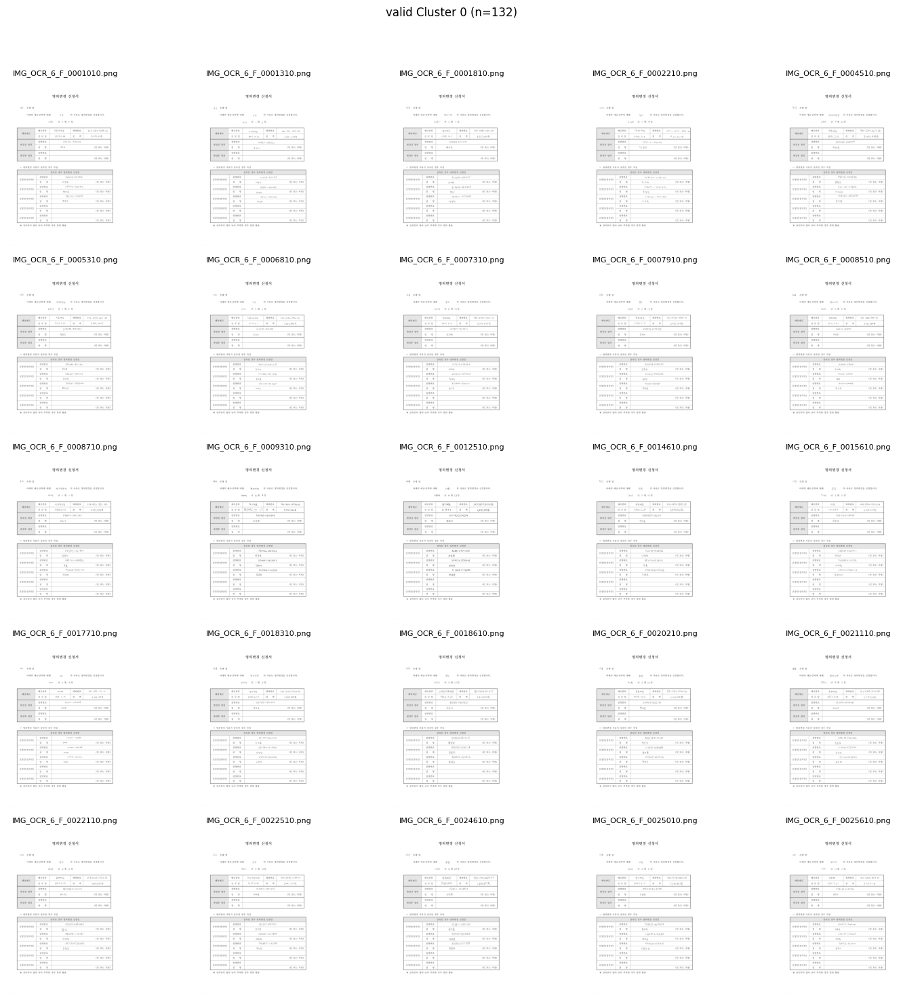

[저장] valid_image/_cluster_docimg/valid_cluster0_preview.png


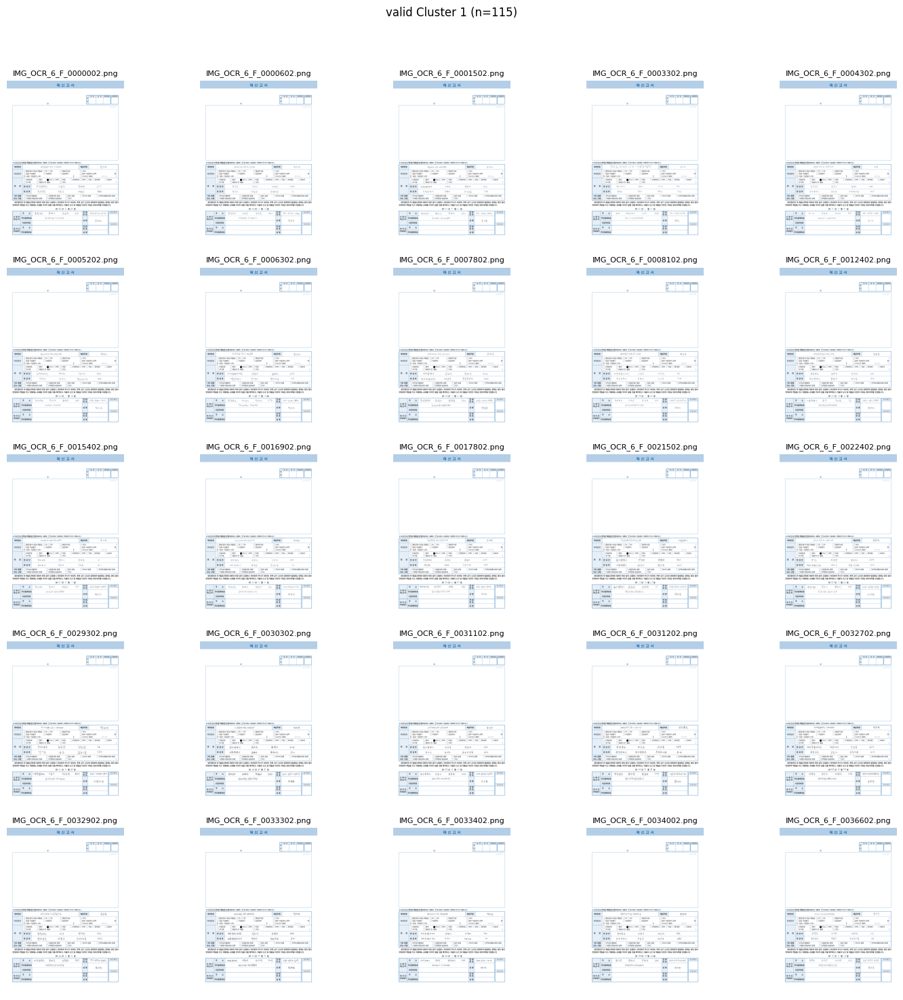

[저장] valid_image/_cluster_docimg/valid_cluster1_preview.png


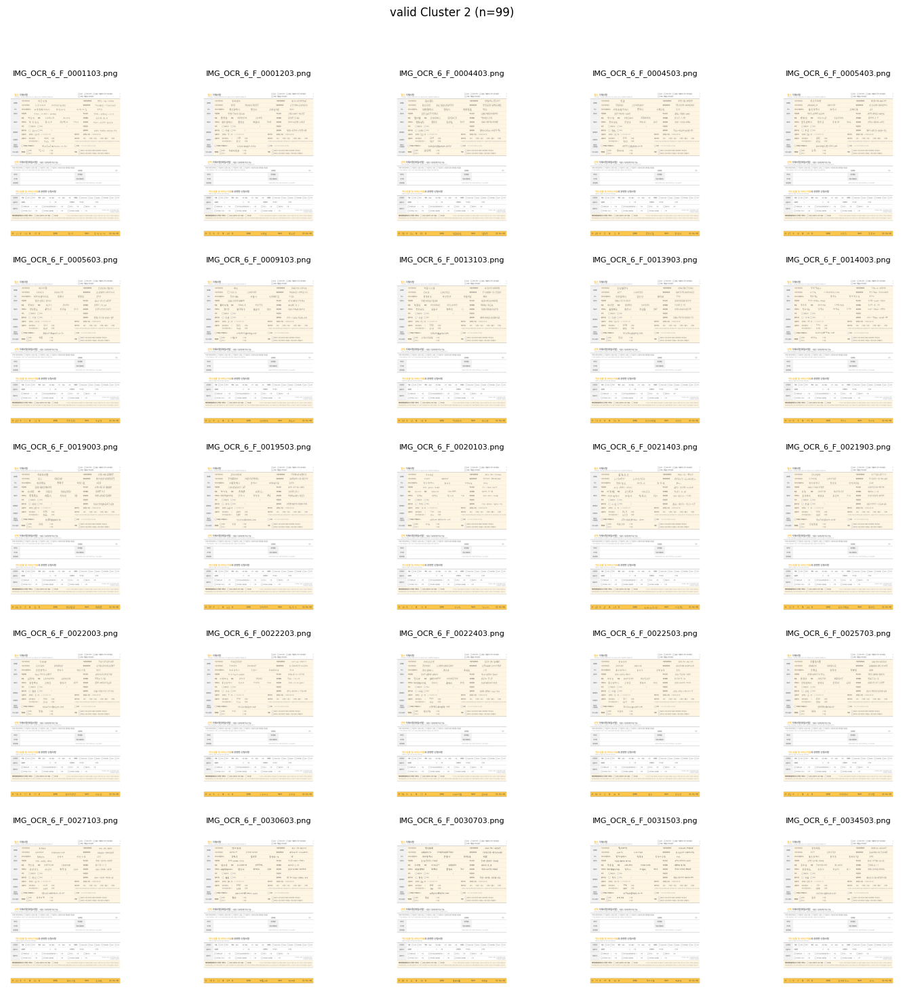

[저장] valid_image/_cluster_docimg/valid_cluster2_preview.png


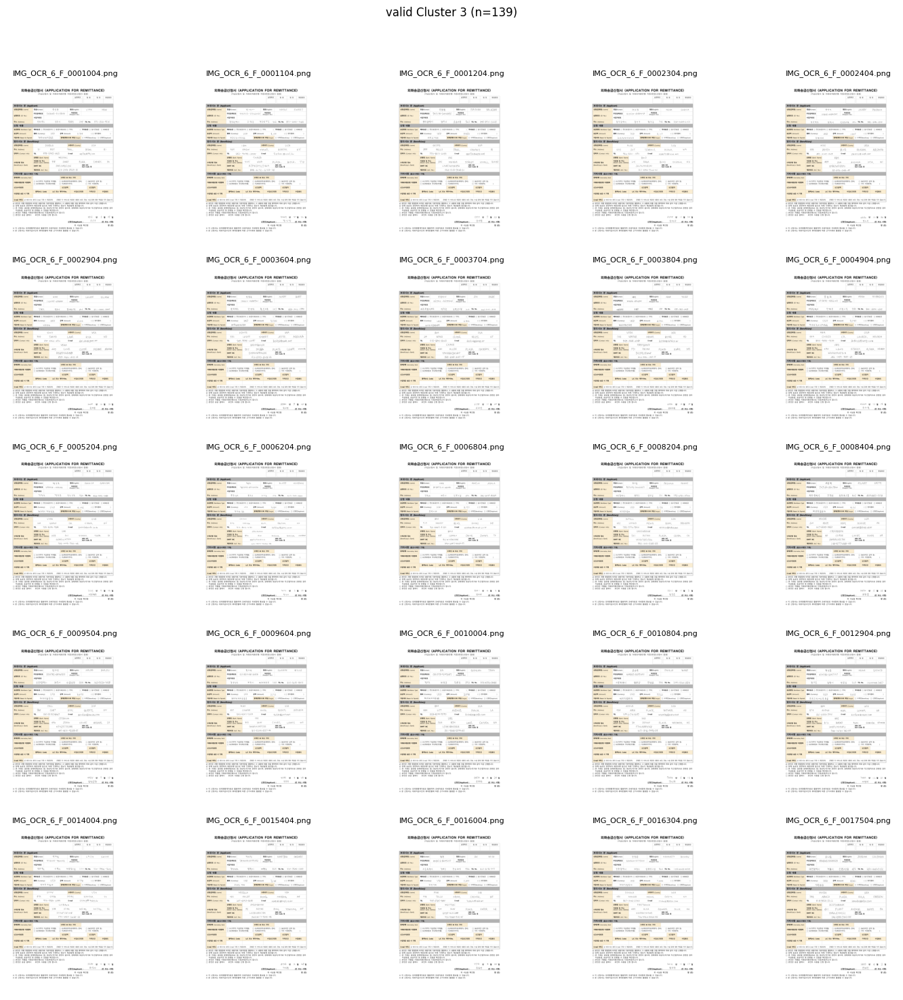

[저장] valid_image/_cluster_docimg/valid_cluster3_preview.png


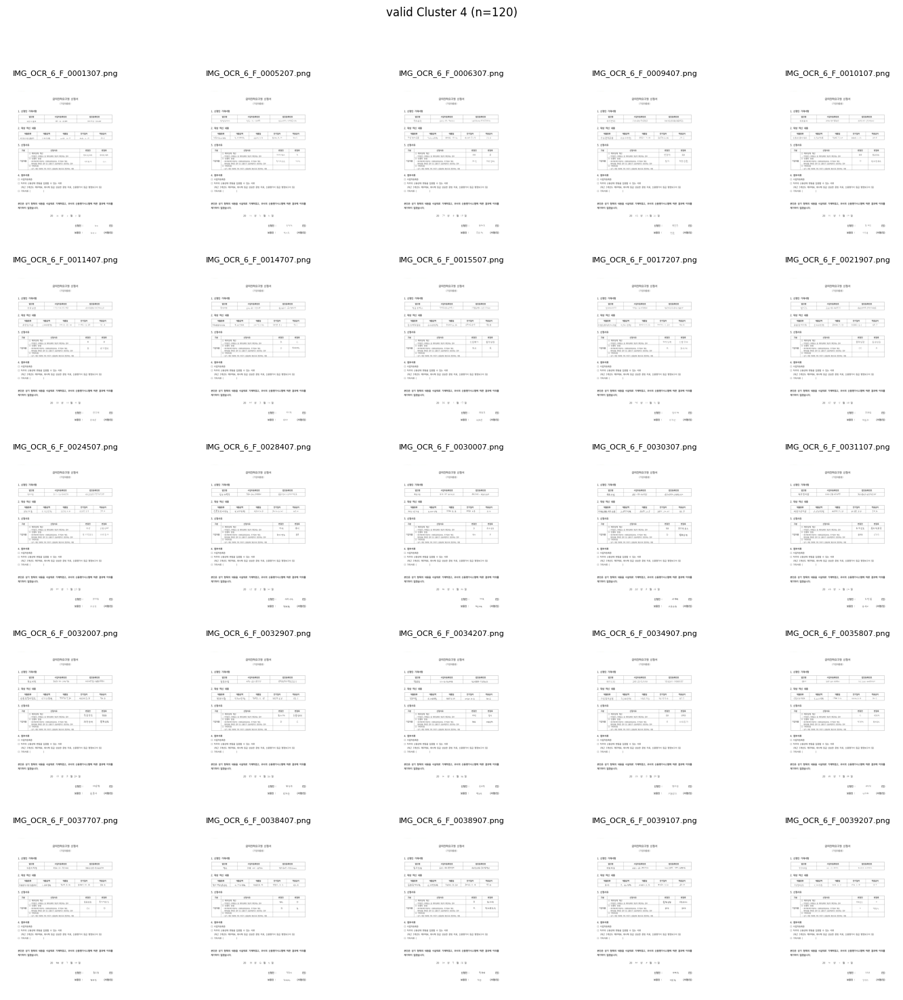

[저장] valid_image/_cluster_docimg/valid_cluster4_preview.png


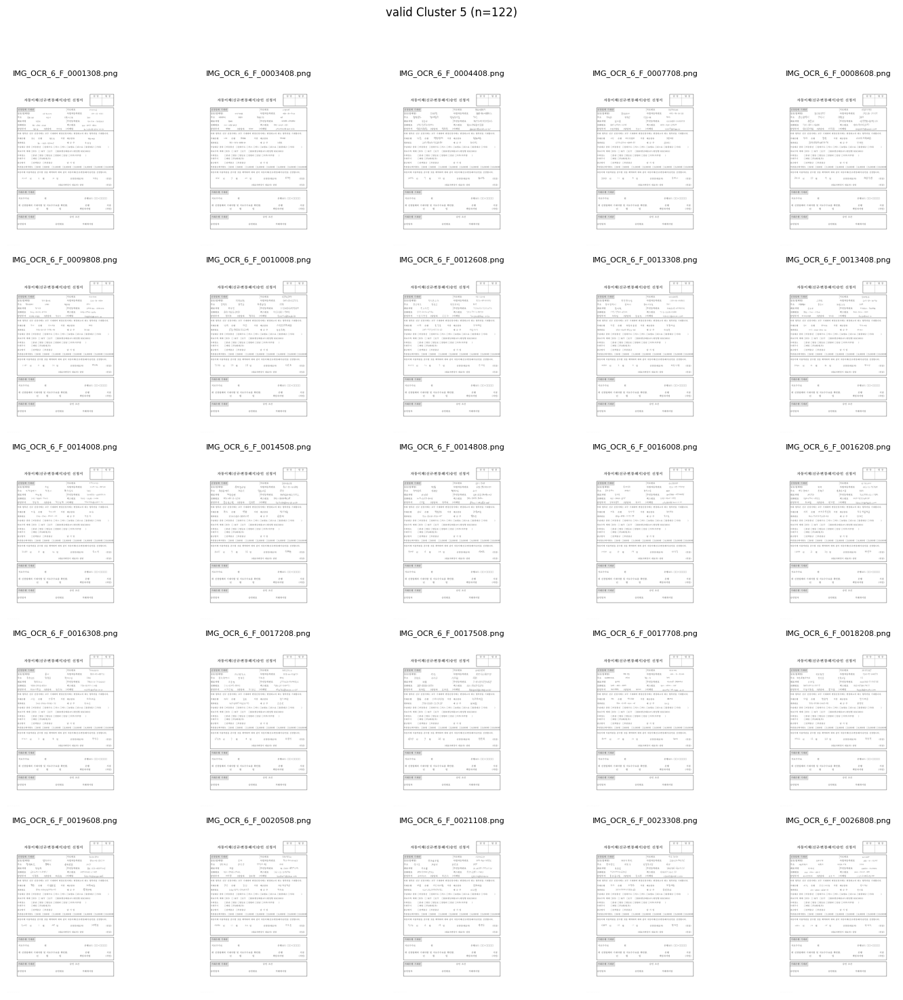

[저장] valid_image/_cluster_docimg/valid_cluster5_preview.png


In [5]:
# validation set clustering
import os, sys, math, json, random
from glob import glob
from typing import List, Tuple
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from skimage.feature import hog
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
# =========================
# 설정
# =========================
DATASET_DIR   = "valid_image"  # 이미지 폴더 경로
SPLIT         = "valid"        # "train" or "valid"
N_CLUSTERS    = 6
SEED          = 42
MAX_IMAGES    = None           # None이면 split의 모든 이미지 사용, 숫자면 그 개수만 랜덤 사용
THUMB_SIZE    = 96             # 썸네일 한 변
HOG_PIX_CELL  = (16, 16)
HOG_CELLS_BLK = (2, 2)
HOG_ORIENT    = 9
OUT_DIR       = os.path.join(DATASET_DIR, "_cluster_docimg")
os.makedirs(OUT_DIR, exist_ok=True)
IMG_EXTS = [".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff", ".webp"]
def list_images_by_split(dataset_root: str, split: str) -> List[str]:
    """dataset_root 아래에서 경로에 split이 포함된 모든 이미지 경로를 재귀로 수집"""
    imgs = []
    for ext in IMG_EXTS:
        imgs += glob(os.path.join(dataset_root, "**", f"*{ext}"), recursive=True)
    # split 문자열을 경로에 포함(폴더 경계 포함)하는 것만 필터
    split_l = split.lower()
    sel = []
    for p in imgs:
        pl = p.replace("\\", "/").lower()
        if f"/{split_l}/" in pl or pl.endswith(f"/{split_l}") or f"_{split_l}/" in pl or f"/{split_l}_" in pl:
            sel.append(p)
    # 폴더명이 명확하지 않은 경우(예: images만 있는 구조) → 모두 허용하고 나중에 필요시 바꾸세요.
    if len(sel) == 0:
        sel = imgs
    # 존재 파일만
    sel = [p for p in sel if os.path.isfile(p)]
    return sorted(sel)
def load_image_gray(path: str) -> Tuple[np.ndarray, int, int]:
    """이미지를 그레이스케일로 로드, numpy float32 [0,1], (H,W) + 원본 W,H 반환"""
    with Image.open(path) as img:
        img = img.convert("L")
        w, h = img.size
        arr = np.asarray(img, dtype=np.uint8).astype(np.float32) / 255.0
    return arr, w, h
def extract_features(path: str) -> np.ndarray:
    """썸네일 + HOG + 기하 특징을 이어붙인 전역 특징"""
    try:
        gray, w, h = load_image_gray(path)
    except Exception as e:
        # 읽기 실패 시 None 반환
        return None
    # 썸네일(THUMB_SIZE x THUMB_SIZE) -> 1D
    img = Image.fromarray((gray * 255).astype(np.uint8))
    thumb = img.resize((THUMB_SIZE, THUMB_SIZE), Image.BILINEAR)
    thumb_arr = np.asarray(thumb, dtype=np.float32) / 255.0
    thumb_feat = thumb_arr.flatten()  # (THUMB_SIZE*THUMB_SIZE, )
    # HOG 특징 (skimage)
    hog_feat = hog(
        thumb_arr,
        orientations=HOG_ORIENT,
        pixels_per_cell=HOG_PIX_CELL,
        cells_per_block=HOG_CELLS_BLK,
        block_norm="L2-Hys",
        visualize=False,
        feature_vector=True
    )
    # 기하 특징
    aspect = (w / max(h, 1.0))
    area   = w * h
    geo = np.array([w, h, aspect, np.log(max(area, 1.0))], dtype=np.float32)
    feat = np.concatenate([thumb_feat, hog_feat.astype(np.float32), geo], axis=0)
    return feat
def make_contact_sheet(image_paths: List[str], title: str, out_path: str, max_tiles: int = 25, ncols: int = 5):
    """경로 리스트에서 최대 max_tiles장으로 콜라주 저장 + 화면표시"""
    picks = image_paths[:max_tiles]
    if len(picks) == 0:
        return
    n = len(picks)
    ncols = max(1, ncols)
    nrows = (n + ncols - 1) // ncols
    plt.figure(figsize=(3*ncols, 3*nrows))
    for i, p in enumerate(picks, 1):
        try:
            with Image.open(p) as im:
                im = im.convert("RGB")
                ax = plt.subplot(nrows, ncols, i)
                ax.imshow(im)
                ax.axis("off")
                ax.set_title(os.path.basename(p), fontsize=8)
        except Exception as e:
            print(f"[이미지 열기 실패] {p}: {e}")
    plt.suptitle(title, fontsize=12)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.savefig(out_path, dpi=150)
    plt.show()
    print(f"[저장] {out_path}")
def main():
    random.seed(SEED)
    np.random.seed(SEED)
    # 1) 이미지 목록 수집
    all_imgs = list_images_by_split(DATASET_DIR, SPLIT)
    if not all_imgs:
        print("[오류] 이미지를 찾지 못했습니다. DATASET_DIR/SPLIT 경로를 확인하세요.")
        return
    if MAX_IMAGES is not None and len(all_imgs) > MAX_IMAGES:
        all_imgs = random.sample(all_imgs, MAX_IMAGES)
    print(f"[INFO] 대상 이미지 수: {len(all_imgs)} (split={SPLIT})")
    # 2) 특징 추출
    feats = []
    kept_paths = []
    for p in all_imgs:
        f = extract_features(p)
        if f is not None:
            feats.append(f)
            kept_paths.append(p)
    if not feats:
        print("[오류] 특징을 추출하지 못했습니다.")
        return
    X = np.vstack(feats).astype(np.float32)
    print(f"[INFO] 특징 행렬: {X.shape}")  # (N, D)
    # 3) 스케일링 + PCA + KMeans
    scaler = StandardScaler()
    Xs = scaler.fit_transform(X)
    pca = PCA(n_components=min(50, Xs.shape[1]), random_state=SEED)
    Xp = pca.fit_transform(Xs)
    print(f"[INFO] PCA 변환: {Xp.shape}, 누적설명분산(50D 이내) ≈ {pca.explained_variance_ratio_.sum():.3f}")
    kmeans = KMeans(n_clusters=N_CLUSTERS, random_state=SEED, n_init="auto")
    labels = kmeans.fit_predict(Xp)
    # 4) 결과 요약/저장
    # 클러스터별 개수
    counts = {}
    for c in range(N_CLUSTERS):
        counts[c] = int(np.sum(labels == c))
    print("\n=== 클러스터 개수 요약 ===")
    for c in range(N_CLUSTERS):
        print(f"  Cluster {c}: {counts[c]}")
    # 매핑 CSV 저장
    csv_path = os.path.join(OUT_DIR, f"{SPLIT}_clusters_k{N_CLUSTERS}.csv")
    with open(csv_path, "w", encoding="utf-8") as f:
        f.write("image_path,cluster\n")
        for p, lb in zip(kept_paths, labels):
            f.write(f"{p},{lb}\n")
    print(f"[저장] 매핑 CSV: {csv_path}")
    # 5) 클러스터별 콜라주 저장/표시
    for c in range(N_CLUSTERS):
        paths_c = [p for p, lb in zip(kept_paths, labels) if lb == c]
        out_collage = os.path.join(OUT_DIR, f"{SPLIT}_cluster{c}_preview.png")
        title = f"{SPLIT} Cluster {c} (n={len(paths_c)})"
        make_contact_sheet(paths_c, title, out_collage, max_tiles=25, ncols=5)
if __name__ == "__main__":
    main()

CLUSTER MATCHING BETWEEN TRAINING AND VALIDATION SETS
Loaded training clusters: 5743 images
Loaded validation clusters: 727 images

--- Extracting Training Cluster Features ---
Processing training cluster 0...
  Extracted features from 50/50 images
Processing training cluster 1...
  Extracted features from 50/50 images
Processing training cluster 2...
  Extracted features from 50/50 images
Processing training cluster 3...
  Extracted features from 50/50 images
Processing training cluster 4...
  Extracted features from 50/50 images
Processing training cluster 5...
  Extracted features from 50/50 images

--- Extracting Validation Cluster Features ---
Processing validation cluster 0...
  Extracted features from 50/50 images
Processing validation cluster 1...
  Extracted features from 50/50 images
Processing validation cluster 2...
  Extracted features from 50/50 images
Processing validation cluster 3...
  Extracted features from 50/50 images
Processing validation cluster 4...
  Extracted 

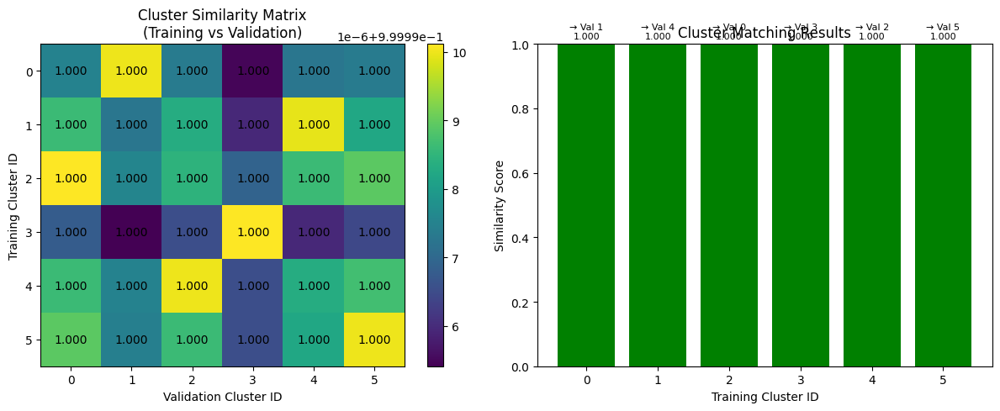


--- Reordering Validation Clusters ---
Validation clusters have been reordered to match training clusters!

New cluster distribution (validation):
  Cluster 0: 115 images
  Cluster 1: 120 images
  Cluster 2: 132 images
  Cluster 3: 139 images
  Cluster 4: 99 images
  Cluster 5: 122 images

GENERATING CLUSTER RESULTS FOR SUBSEQUENT CELLS
Processing TRAINING clusters...
Loaded 5743 total JSON records

--- Processing Cluster 0 ---
Cluster 0 has 965 images
Maximum unique IDs in cluster 0: 20
Cluster 0 final results:
  - Complete files: 965
  - Complete images: 965
  - Filtered JSON entries: 965

--- Processing Cluster 1 ---
Cluster 1 has 1057 images
Maximum unique IDs in cluster 1: 17
Cluster 1 final results:
  - Complete files: 1057
  - Complete images: 1057
  - Filtered JSON entries: 1057

--- Processing Cluster 2 ---
Cluster 2 has 1080 images
Maximum unique IDs in cluster 2: 17
Cluster 2 final results:
  - Complete files: 1080
  - Complete images: 1080
  - Filtered JSON entries: 1080



In [5]:
# Cluster Matching between Training and Validation Sets
import pandas as pd
import numpy as np
import os
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from PIL import Image
import matplotlib.pyplot as plt
from typing import Dict, Tuple, List
import json
from skimage.feature import hog
import glob
from collections import defaultdict

def load_cluster_data(csv_path: str) -> pd.DataFrame:
    """Load cluster CSV file"""
    if not os.path.exists(csv_path):
        print(f"Cluster file not found: {csv_path}")
        return pd.DataFrame()
    return pd.read_csv(csv_path)

def extract_cluster_features(cluster_df: pd.DataFrame, cluster_id: int, sample_size: int = 50) -> np.ndarray:
    """Extract representative features for a cluster by sampling images"""
    cluster_images = cluster_df[cluster_df['cluster'] == cluster_id]['image_path'].tolist()
    
    if len(cluster_images) == 0:
        return np.array([])
    
    # Sample images if too many (for computational efficiency)
    if len(cluster_images) > sample_size:
        cluster_images = np.random.choice(cluster_images, sample_size, replace=False).tolist()
    
    features = []
    valid_images = 0
    
    for img_path in cluster_images:
        try:
            # Load and preprocess image
            with Image.open(img_path) as img:
                img = img.convert("L")
                img_array = np.asarray(img.resize((96, 96)), dtype=np.float32) / 255.0
                
                # Extract HOG features
                hog_feat = hog(
                    img_array,
                    orientations=9,
                    pixels_per_cell=(16, 16),
                    cells_per_block=(2, 2),
                    block_norm="L2-Hys",
                    feature_vector=True
                )
                
                # Add geometric features
                w, h = img.size
                aspect = w / max(h, 1.0)
                area = w * h
                geo_feat = np.array([w, h, aspect, np.log(max(area, 1.0))])
                
                # Combine features
                combined_feat = np.concatenate([
                    img_array.flatten(),  # thumbnail features
                    hog_feat.astype(np.float32),  # HOG features
                    geo_feat.astype(np.float32)   # geometric features
                ])
                
                features.append(combined_feat)
                valid_images += 1
                
        except Exception as e:
            print(f"Error processing {img_path}: {e}")
            continue
    
    if len(features) == 0:
        return np.array([])
    
    # Return mean feature vector as cluster representative
    cluster_features = np.vstack(features)
    mean_features = np.mean(cluster_features, axis=0)
    
    print(f"  Extracted features from {valid_images}/{len(cluster_images)} images")
    return mean_features

def compute_cluster_similarities(train_features: Dict[int, np.ndarray], 
                               val_features: Dict[int, np.ndarray]) -> np.ndarray:
    """Compute similarity matrix between training and validation clusters"""
    n_clusters = len(train_features)
    similarity_matrix = np.zeros((n_clusters, n_clusters))
    
    for train_idx, train_cluster_id in enumerate(sorted(train_features.keys())):
        for val_idx, val_cluster_id in enumerate(sorted(val_features.keys())):
            if len(train_features[train_cluster_id]) > 0 and len(val_features[val_cluster_id]) > 0:
                # Compute cosine similarity
                sim = cosine_similarity(
                    train_features[train_cluster_id].reshape(1, -1),
                    val_features[val_cluster_id].reshape(1, -1)
                )[0, 0]
                similarity_matrix[train_idx, val_idx] = sim
    
    return similarity_matrix

def find_optimal_cluster_mapping(similarity_matrix: np.ndarray) -> Dict[int, int]:
    """Find optimal one-to-one mapping between clusters using Hungarian algorithm approach"""
    n_clusters = similarity_matrix.shape[0]
    
    # Simple greedy matching for now (you can use scipy.optimize.linear_sum_assignment for optimal)
    used_val_clusters = set()
    mapping = {}
    
    # Sort by highest similarity first
    similarities = []
    for i in range(n_clusters):
        for j in range(n_clusters):
            similarities.append((similarity_matrix[i, j], i, j))
    
    similarities.sort(reverse=True)  # Highest similarity first
    
    for sim_score, train_cluster, val_cluster in similarities:
        if train_cluster not in mapping and val_cluster not in used_val_clusters:
            mapping[train_cluster] = val_cluster
            used_val_clusters.add(val_cluster)
            
            if len(mapping) == n_clusters:
                break
    
    return mapping

def visualize_cluster_matching(similarity_matrix: np.ndarray, mapping: Dict[int, int]):
    """Visualize the similarity matrix and matching results"""
    plt.figure(figsize=(12, 5))
    
    # Plot similarity matrix
    plt.subplot(1, 2, 1)
    im = plt.imshow(similarity_matrix, cmap='viridis', aspect='auto')
    plt.colorbar(im)
    plt.title('Cluster Similarity Matrix\n(Training vs Validation)')
    plt.xlabel('Validation Cluster ID')
    plt.ylabel('Training Cluster ID')
    
    # Add text annotations
    for i in range(similarity_matrix.shape[0]):
        for j in range(similarity_matrix.shape[1]):
            text = plt.text(j, i, f'{similarity_matrix[i, j]:.3f}',
                           ha="center", va="center", color="white" if similarity_matrix[i, j] < 0.5 else "black")
    
    # Plot matching results
    plt.subplot(1, 2, 2)
    train_ids = list(range(len(mapping)))
    val_ids = [mapping[i] for i in train_ids]
    similarities = [similarity_matrix[i, mapping[i]] for i in train_ids]
    
    bars = plt.bar(train_ids, similarities, color=['green' if s > 0.7 else 'orange' if s > 0.5 else 'red' for s in similarities])
    plt.xlabel('Training Cluster ID')
    plt.ylabel('Similarity Score')
    plt.title('Cluster Matching Results')
    plt.ylim(0, 1)
    
    # Add value labels on bars
    for i, (bar, val_id, sim) in enumerate(zip(bars, val_ids, similarities)):
        plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01,
                f'→ Val {val_id}\n{sim:.3f}', ha='center', va='bottom', fontsize=8)
    
    plt.tight_layout()
    plt.show()

def filter_complete_files_by_cluster(cluster_df: pd.DataFrame, json_folder: str, image_folder: str, dataset_name: str = ""):
    """Filter complete files by cluster using the matched cluster DataFrame"""
    print(f"Processing {dataset_name} clusters...")
    
    # Load all JSON files
    json_files = glob.glob(os.path.join(json_folder, "*.json"))
    
    # Load all JSON data
    df_y_all = pd.DataFrame()
    for json_file in json_files:
        try:
            with open(json_file, 'r') as f:
                json_data = json.load(f)
            df_y_all = pd.concat([df_y_all, pd.json_normalize(json_data)])
        except Exception as e:
            print(f"Error loading {json_file}: {e}")
            continue
    
    print(f"Loaded {df_y_all.shape[0]} total JSON records")
    
    # Group by cluster
    cluster_results = {}
    
    for cluster_id in sorted(cluster_df['cluster'].unique()):
        print(f"\n--- Processing Cluster {cluster_id} ---")
        
        # Get images in this cluster
        cluster_images = cluster_df[cluster_df['cluster'] == cluster_id]['image_path'].tolist()
        cluster_identifiers = [os.path.splitext(os.path.basename(path))[0] for path in cluster_images]
        
        print(f"Cluster {cluster_id} has {len(cluster_identifiers)} images")
        
        # Filter JSON data for this cluster
        cluster_json_df = df_y_all[df_y_all['Images.identifier'].isin(cluster_identifiers)].reset_index(drop=True)
        
        if len(cluster_json_df) == 0:
            print(f"No JSON data found for cluster {cluster_id}")
            cluster_results[cluster_id] = (pd.DataFrame(), [], 0)
            continue
        
        # Find maximum number of unique IDs in this cluster with proper error handling
        max_ids_in_cluster = 0
        for i in range(cluster_json_df.shape[0]):
            try:
                # Check if bbox column exists and is not None
                row = cluster_json_df.iloc[i]
                if 'bbox' not in row:
                    continue
                
                bbox_data = row['bbox']
                if bbox_data is None:
                    continue
                
                # Handle the case where bbox might be a string or needs conversion
                if isinstance(bbox_data, str):
                    continue
                    
                # Convert bbox to DataFrame
                df_bbox = pd.DataFrame(bbox_data)
                
                # Check if the DataFrame is empty or doesn't have 'id' column
                if df_bbox.empty or 'id' not in df_bbox.columns:
                    continue
                    
                # Count unique IDs
                unique_ids = df_bbox['id'].nunique()
                max_ids_in_cluster = max(max_ids_in_cluster, unique_ids)
                
            except Exception as e:
                print(f"Error processing bbox data for entry {i}: {e}")
                continue
        
        print(f"Maximum unique IDs in cluster {cluster_id}: {max_ids_in_cluster}")
        
        # Filter for complete files in this cluster
        complete_files = []
        complete_images = []
        
        for i in range(cluster_json_df.shape[0]):
            try:
                # Check if bbox column exists and is not None
                row = cluster_json_df.iloc[i]
                if 'bbox' not in row:
                    continue
                
                bbox_data = row['bbox']
                if bbox_data is None:
                    continue
                
                # Handle the case where bbox might be a string or needs conversion
                if isinstance(bbox_data, str):
                    continue
                    
                # Convert bbox to DataFrame
                df_bbox = pd.DataFrame(bbox_data)
                
                # Check if the DataFrame is empty or doesn't have 'id' column
                if df_bbox.empty or 'id' not in df_bbox.columns:
                    continue
                    
                unique_ids = df_bbox['id'].nunique()
                
                # Check if this file has maximum number of IDs for this cluster
                if unique_ids == max_ids_in_cluster:
                    json_identifier = row['Images.identifier']
                    complete_files.append(json_identifier)
                    
                    # Find corresponding image
                    img_filename = json_identifier + '.png'
                    img_path = os.path.join(image_folder, img_filename)
                    
                    if os.path.exists(img_path):
                        try:
                            img = Image.open(img_path)
                            img = img.convert("L")
                            complete_images.append(img)
                        except Exception as e:
                            print(f"Error loading image {img_path}: {e}")
            except Exception as e:
                print(f"Error processing entry {i}: {e}")
                continue
        
        # Create filtered dataframe for this cluster
        filtered_cluster_df = cluster_json_df[cluster_json_df['Images.identifier'].isin(complete_files)].reset_index(drop=True)
        
        print(f"Cluster {cluster_id} final results:")
        print(f"  - Complete files: {len(complete_files)}")
        print(f"  - Complete images: {len(complete_images)}")
        print(f"  - Filtered JSON entries: {len(filtered_cluster_df)}")
        
        cluster_results[cluster_id] = (filtered_cluster_df, complete_images, max_ids_in_cluster)
    
    return cluster_results

def main_cluster_matching():
    """Main function to perform cluster matching"""
    print("="*80)
    print("CLUSTER MATCHING BETWEEN TRAINING AND VALIDATION SETS")
    print("="*80)
    
    # Load cluster data
    train_csv = "train_image/_cluster_docimg/train_clusters_k6.csv"
    val_csv = "valid_image/_cluster_docimg/valid_clusters_k6.csv"
    
    train_cluster_df = load_cluster_data(train_csv)
    val_cluster_df = load_cluster_data(val_csv)
    
    if train_cluster_df.empty or val_cluster_df.empty:
        print("Error: Could not load cluster data. Please run clustering cells first!")
        return {}, train_cluster_df, val_cluster_df
    
    print(f"Loaded training clusters: {len(train_cluster_df)} images")
    print(f"Loaded validation clusters: {len(val_cluster_df)} images")
    
    # Extract features for each cluster
    print("\n--- Extracting Training Cluster Features ---")
    train_features = {}
    for cluster_id in sorted(train_cluster_df['cluster'].unique()):
        print(f"Processing training cluster {cluster_id}...")
        features = extract_cluster_features(train_cluster_df, cluster_id)
        train_features[cluster_id] = features
    
    print("\n--- Extracting Validation Cluster Features ---")
    val_features = {}
    for cluster_id in sorted(val_cluster_df['cluster'].unique()):
        print(f"Processing validation cluster {cluster_id}...")
        features = extract_cluster_features(val_cluster_df, cluster_id)
        val_features[cluster_id] = features
    
    # Compute similarity matrix
    print("\n--- Computing Cluster Similarities ---")
    similarity_matrix = compute_cluster_similarities(train_features, val_features)
    
    # Find optimal mapping
    print("--- Finding Optimal Cluster Mapping ---")
    cluster_mapping = find_optimal_cluster_mapping(similarity_matrix)
    
    # Display results
    print("\n--- CLUSTER MATCHING RESULTS ---")
    print("Training Cluster → Validation Cluster (Similarity)")
    print("-" * 50)
    for train_id in sorted(cluster_mapping.keys()):
        val_id = cluster_mapping[train_id]
        similarity = similarity_matrix[train_id, val_id]
        quality = "🟢 Excellent" if similarity > 0.8 else "🟡 Good" if similarity > 0.6 else "🟠 Fair" if similarity > 0.4 else "🔴 Poor"
        print(f"Cluster {train_id} → Cluster {val_id} ({similarity:.3f}) {quality}")
    
    # Visualize results
    print("\n--- Visualizing Results ---")
    visualize_cluster_matching(similarity_matrix, cluster_mapping)
    
    # Reorder validation clusters to match training clusters
    print("\n--- Reordering Validation Clusters ---")
    val_cluster_df_reordered = val_cluster_df.copy()
    
    # Create mapping from old validation cluster IDs to new ones
    val_reorder_mapping = {val_id: train_id for train_id, val_id in cluster_mapping.items()}
    
    # Apply reordering
    val_cluster_df_reordered['cluster'] = val_cluster_df_reordered['cluster'].map(val_reorder_mapping)
    
    print("Validation clusters have been reordered to match training clusters!")
    print("\nNew cluster distribution (validation):")
    for cluster_id in sorted(val_cluster_df_reordered['cluster'].unique()):
        count = len(val_cluster_df_reordered[val_cluster_df_reordered['cluster'] == cluster_id])
        print(f"  Cluster {cluster_id}: {count} images")
    
    return cluster_mapping, train_cluster_df, val_cluster_df_reordered

# Run cluster matching
np.random.seed(42)  # For reproducible sampling
cluster_mapping, train_cluster_df, val_cluster_df_matched = main_cluster_matching()

# Now generate the cluster results that cells 5 and 6 expect
print("\n" + "="*80)
print("GENERATING CLUSTER RESULTS FOR SUBSEQUENT CELLS")
print("="*80)

# Process training clusters with matched cluster data
train_cluster_results = filter_complete_files_by_cluster(
    cluster_df=train_cluster_df,
    json_folder="train_label",
    image_folder="train_image",
    dataset_name="TRAINING"
)

# Process validation clusters with matched cluster data
val_cluster_results = filter_complete_files_by_cluster(
    cluster_df=val_cluster_df_matched,
    json_folder="valid_label", 
    image_folder="valid_image",
    dataset_name="VALIDATION"
)

# Summary
print("\n" + "="*80)
print("CLUSTER FILTERING SUMMARY")
print("="*80)

print("\nTRAINING SET:")
total_train_complete = 0
for cluster_id, (df, images, max_ids) in train_cluster_results.items():
    print(f"  Cluster {cluster_id}: {len(images)} complete images (max_ids={max_ids})")
    total_train_complete += len(images)

print("\nVALIDATION SET:")
total_val_complete = 0
for cluster_id, (df, images, max_ids) in val_cluster_results.items():
    print(f"  Cluster {cluster_id}: {len(images)} complete images (max_ids={max_ids})")
    total_val_complete += len(images)

print(f"\nTotal complete training images: {total_train_complete}")
print(f"Total complete validation images: {total_val_complete}")
print("="*80)

print("\n✅ Compatibility fixed! Variables 'train_cluster_results' and 'val_cluster_results' are now ready for cells 5 and 6.")

In [6]:
# Verify that cluster matching and filtering worked correctly
print("="*80)
print("VERIFICATION OF CLUSTER MATCHING RESULTS")
print("="*80)

# Check if the required variables exist from cell 4
try:
    print(f"✅ train_cluster_results exists: {len(train_cluster_results)} clusters")
    print(f"✅ val_cluster_results exists: {len(val_cluster_results)} clusters")
    print(f"✅ cluster_mapping exists: {cluster_mapping}")
    print(f"✅ train_cluster_df exists: {len(train_cluster_df)} rows")
    print(f"✅ val_cluster_df_matched exists: {len(val_cluster_df_matched)} rows")
    
    print("\nCluster alignment verification:")
    for train_cluster in sorted(train_cluster_results.keys()):
        train_count = len(train_cluster_results[train_cluster][1])  # images count
        val_count = len(val_cluster_results[train_cluster][1]) if train_cluster in val_cluster_results else 0
        
        print(f"  Cluster {train_cluster}: Train={train_count} images, Val={val_count} images")
    
    print("\n✅ All variables are ready for subsequent processing!")
    print("✅ Cluster matching completed successfully!")
    
except NameError as e:
    print(f"❌ Error: Required variable not found - {e}")
    print("Please run cell 4 (cluster matching) first!")

# Memory usage optimization tip
import gc
print(f"\nMemory cleanup: {gc.collect()} objects collected")

print("="*80)

VERIFICATION OF CLUSTER MATCHING RESULTS
✅ train_cluster_results exists: 6 clusters
✅ val_cluster_results exists: 6 clusters
✅ cluster_mapping exists: {3: 3, 2: 0, 5: 5, 4: 2, 0: 1, 1: 4}
✅ train_cluster_df exists: 5743 rows
✅ val_cluster_df_matched exists: 727 rows

Cluster alignment verification:
  Cluster 0: Train=965 images, Val=115 images
  Cluster 1: Train=1057 images, Val=120 images
  Cluster 2: Train=1080 images, Val=132 images
  Cluster 3: Train=866 images, Val=139 images
  Cluster 4: Train=858 images, Val=99 images
  Cluster 5: Train=917 images, Val=122 images

✅ All variables are ready for subsequent processing!
✅ Cluster matching completed successfully!

Memory cleanup: 0 objects collected


In [7]:
# Concatenate filtered images and JSON files from cluster results

import torch
import torch.nn as nn
import torch.optim as optim
import os
import numpy as np
import matplotlib.pyplot as plt
import json
from PIL import Image
import glob
from sklearn.model_selection import train_test_split
import pandas as pd

li_X_train = []
df_y_train = pd.DataFrame()

print("\nConcatenating TRAINING data from clusters:")
for cluster_id, (df, images, max_ids) in train_cluster_results.items():
    print(f"  Cluster {cluster_id}: Adding {len(images)} images and {len(df)} JSON records")
    li_X_train.extend(images)
    df_y_train = pd.concat([df_y_train, df], ignore_index=True)

print(f"\nTotal TRAINING data:")
print(f"  Images: {len(li_X_train)}")
print(f"  JSON records: {len(df_y_train)}")

# Concatenate validation data from all clusters  
li_X_val = []
df_y_val = pd.DataFrame()

print("\nConcatenating VALIDATION data from clusters:")
for cluster_id, (df, images, max_ids) in val_cluster_results.items():
    print(f"  Cluster {cluster_id}: Adding {len(images)} images and {len(df)} JSON records")
    li_X_val.extend(images)
    df_y_val = pd.concat([df_y_val, df], ignore_index=True)

print(f"\nTotal VALIDATION data:")
print(f"  Images: {len(li_X_val)}")
print(f"  JSON records: {len(df_y_val)}")

# Display summary
print("\n" + "="*60)
print("DATASET CREATION SUMMARY")
print("="*60)
print(f"Training set: {len(li_X_train)} images, {len(df_y_train)} JSON records")
print(f"Validation set: {len(li_X_val)} images, {len(df_y_val)} JSON records")
print(f"Total: {len(li_X_train) + len(li_X_val)} images")

# Verify data consistency
if len(li_X_train) == len(df_y_train):
    print("✅ Training data is consistent (same number of images and JSON records)")
else:
    print("❌ Training data inconsistency detected!")

if len(li_X_val) == len(df_y_val):
    print("✅ Validation data is consistent (same number of images and JSON records)")
else:
    print("❌ Validation data inconsistency detected!")

print("="*60)


Concatenating TRAINING data from clusters:
  Cluster 0: Adding 965 images and 965 JSON records
  Cluster 1: Adding 1057 images and 1057 JSON records
  Cluster 2: Adding 1080 images and 1080 JSON records
  Cluster 3: Adding 866 images and 866 JSON records
  Cluster 4: Adding 858 images and 858 JSON records
  Cluster 5: Adding 917 images and 917 JSON records

Total TRAINING data:
  Images: 5743
  JSON records: 5743

Concatenating VALIDATION data from clusters:
  Cluster 0: Adding 115 images and 115 JSON records
  Cluster 1: Adding 120 images and 120 JSON records
  Cluster 2: Adding 132 images and 132 JSON records
  Cluster 3: Adding 139 images and 139 JSON records
  Cluster 4: Adding 99 images and 99 JSON records
  Cluster 5: Adding 122 images and 122 JSON records

Total VALIDATION data:
  Images: 727
  JSON records: 727

DATASET CREATION SUMMARY
Training set: 5743 images, 5743 JSON records
Validation set: 727 images, 727 JSON records
Total: 6470 images
✅ Training data is consistent (sa

In [8]:
len(df_y_train), len(li_X_train), len(df_y_val), len(li_X_val)

(5743, 5743, 727, 727)

In [9]:
target_size = (1024, 1024)


CONTENT BOX ANALYSIS - TRAINING

--- Cluster 0 Analysis ---
Processed 965 valid samples
Average content box: 1534×1192 pixels
Average area: 1,828,378 pixels
Largest content box: 1701×1189 pixels

Showing largest content box sample for Cluster 0:


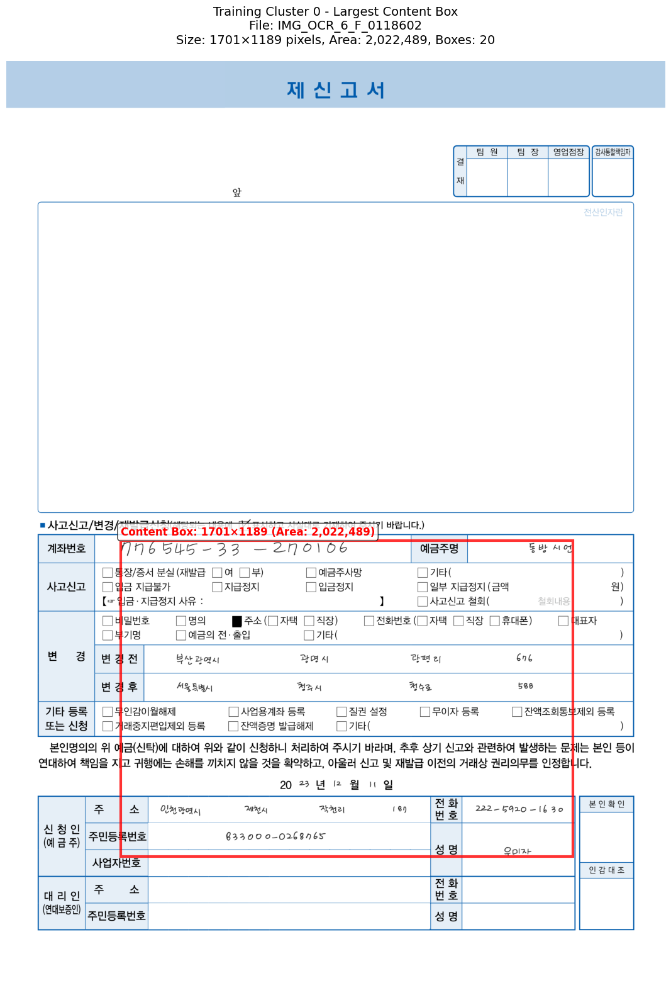


--- Cluster 1 Analysis ---
Processed 1057 valid samples
Average content box: 1826×2417 pixels
Average area: 4,412,780 pixels
Largest content box: 1927×2429 pixels

Showing largest content box sample for Cluster 1:


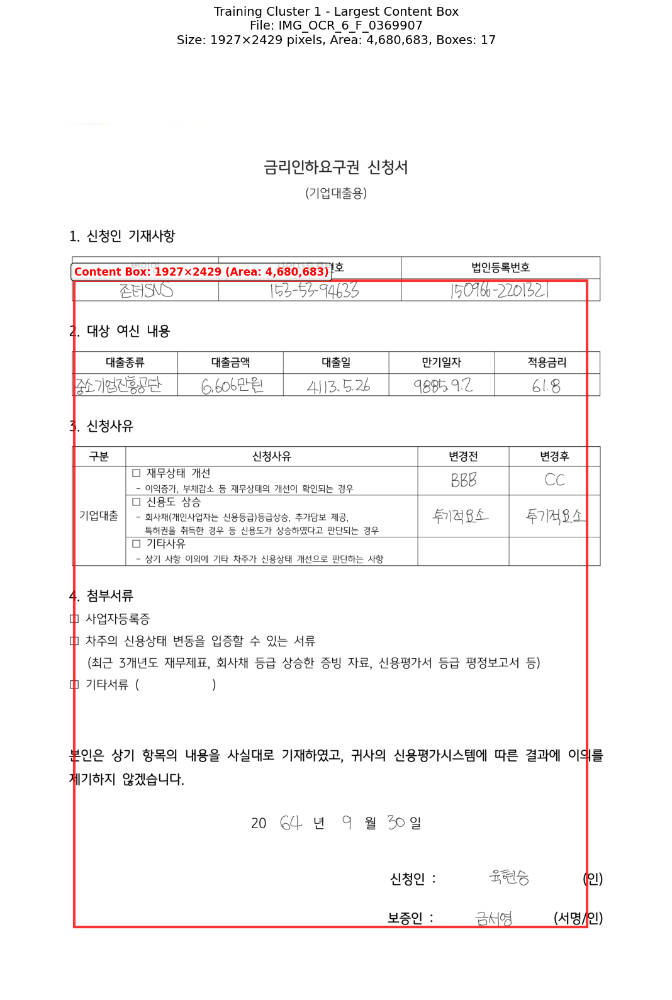


--- Cluster 2 Analysis ---
Processed 1080 valid samples
Average content box: 1848×2027 pixels
Average area: 3,746,539 pixels
Largest content box: 1959×2046 pixels

Showing largest content box sample for Cluster 2:


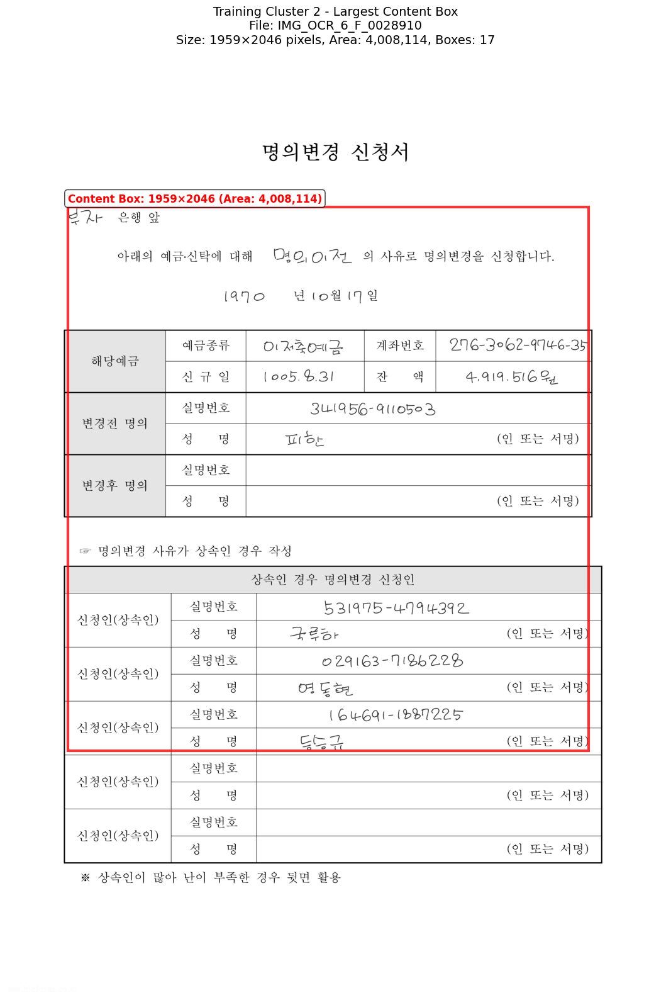


--- Cluster 3 Analysis ---
Processed 866 valid samples
Average content box: 1579×2401 pixels
Average area: 3,792,164 pixels
Largest content box: 1668×2419 pixels

Showing largest content box sample for Cluster 3:


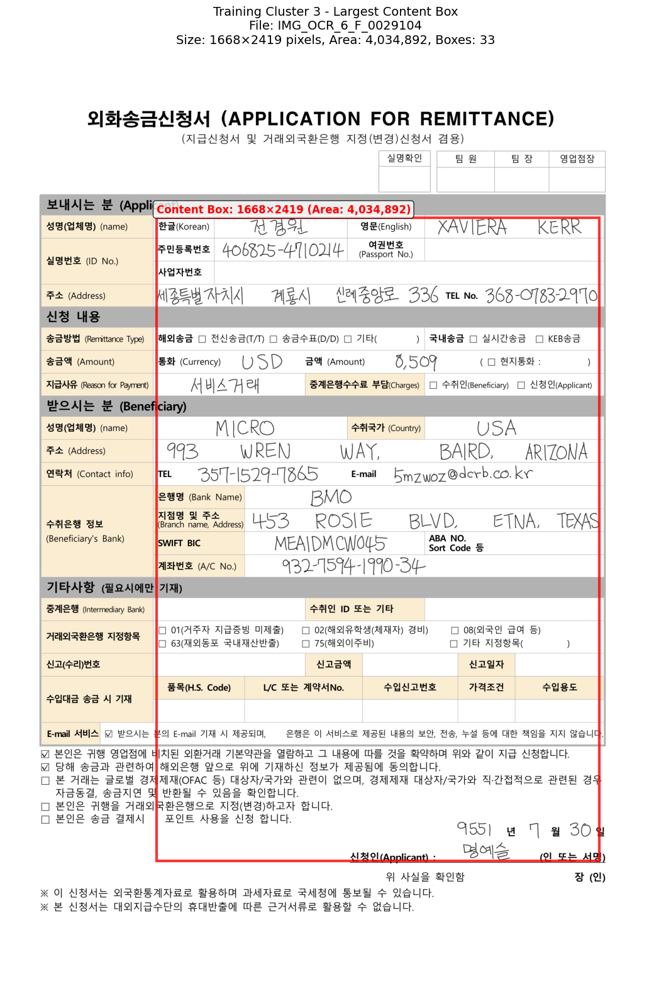


--- Cluster 4 Analysis ---
Processed 858 valid samples
Average content box: 2093×2855 pixels
Average area: 5,976,981 pixels
Largest content box: 2191×2872 pixels

Showing largest content box sample for Cluster 4:


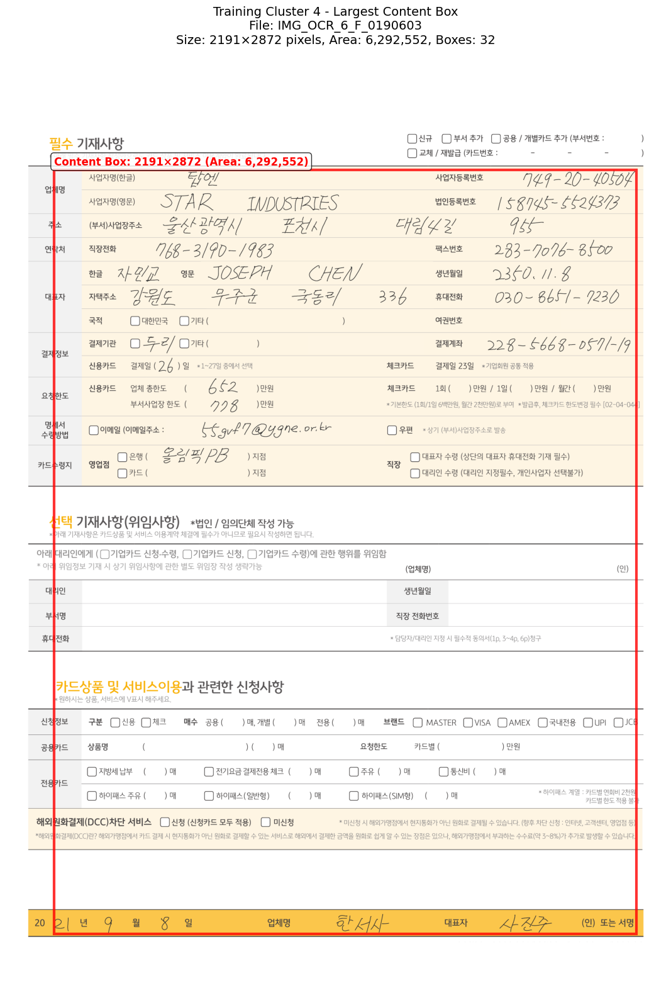


--- Cluster 5 Analysis ---
Processed 917 valid samples
Average content box: 1766×1494 pixels
Average area: 2,638,575 pixels
Largest content box: 1915×1506 pixels

Showing largest content box sample for Cluster 5:


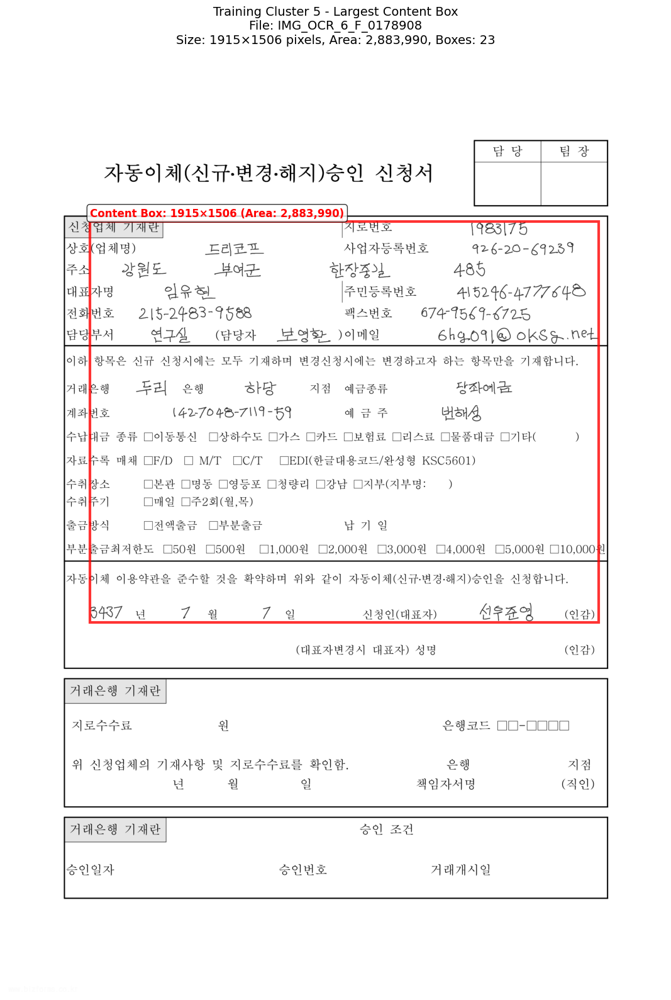


CONTENT BOX ANALYSIS - VALIDATION

--- Cluster 0 Analysis ---
Processed 115 valid samples
Average content box: 1533×1191 pixels
Average area: 1,825,497 pixels
Largest content box: 1586×1203 pixels

Showing largest content box sample for Cluster 0:


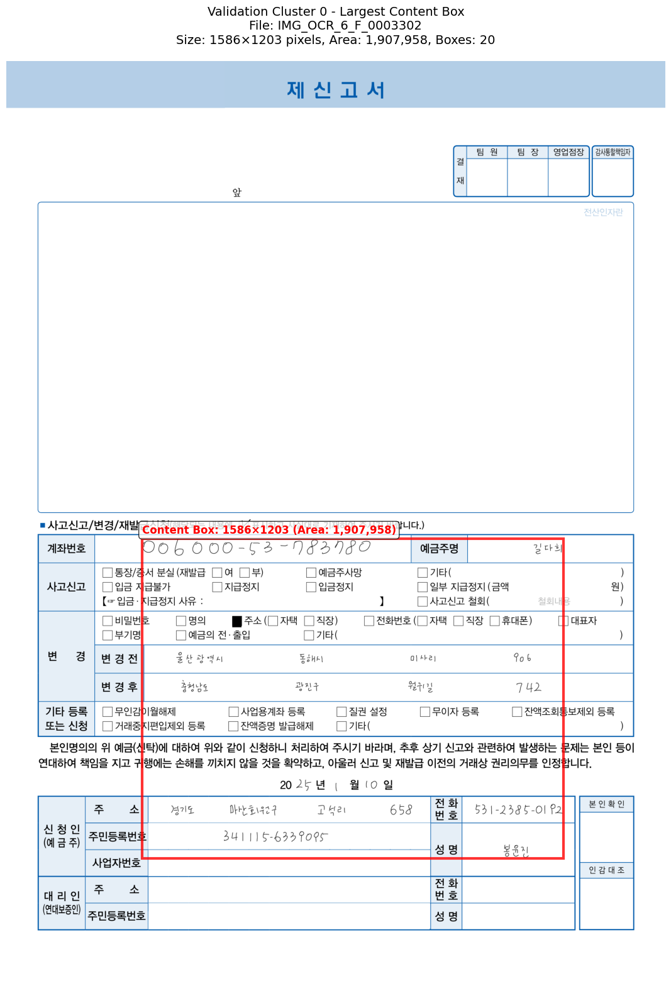


--- Cluster 1 Analysis ---
Processed 120 valid samples
Average content box: 1826×2417 pixels
Average area: 4,413,666 pixels
Largest content box: 1920×2417 pixels

Showing largest content box sample for Cluster 1:


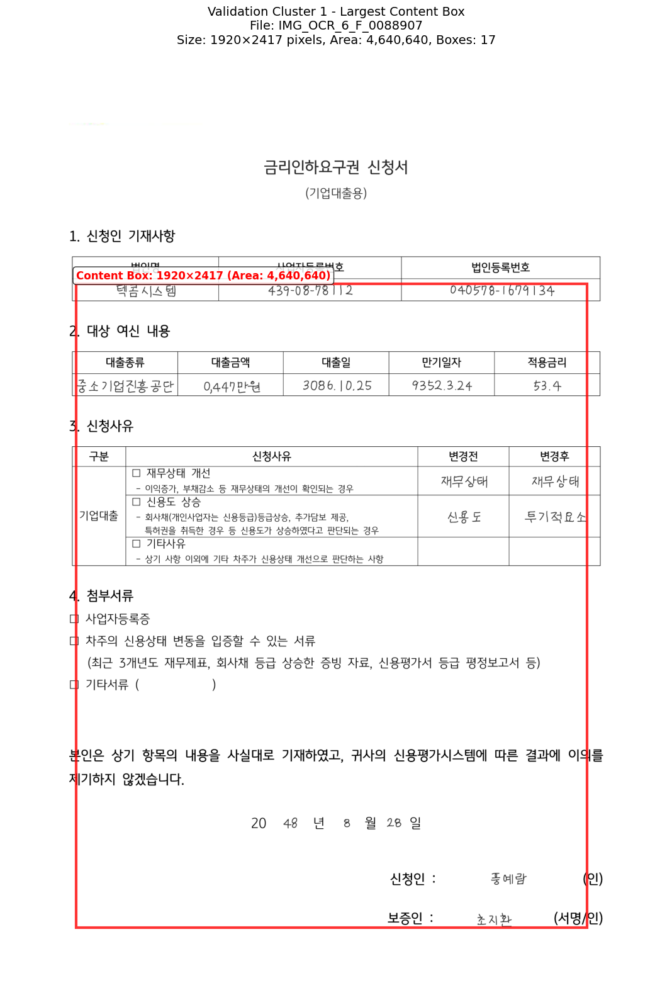


--- Cluster 2 Analysis ---
Processed 132 valid samples
Average content box: 1851×2027 pixels
Average area: 3,752,335 pixels
Largest content box: 1920×2047 pixels

Showing largest content box sample for Cluster 2:


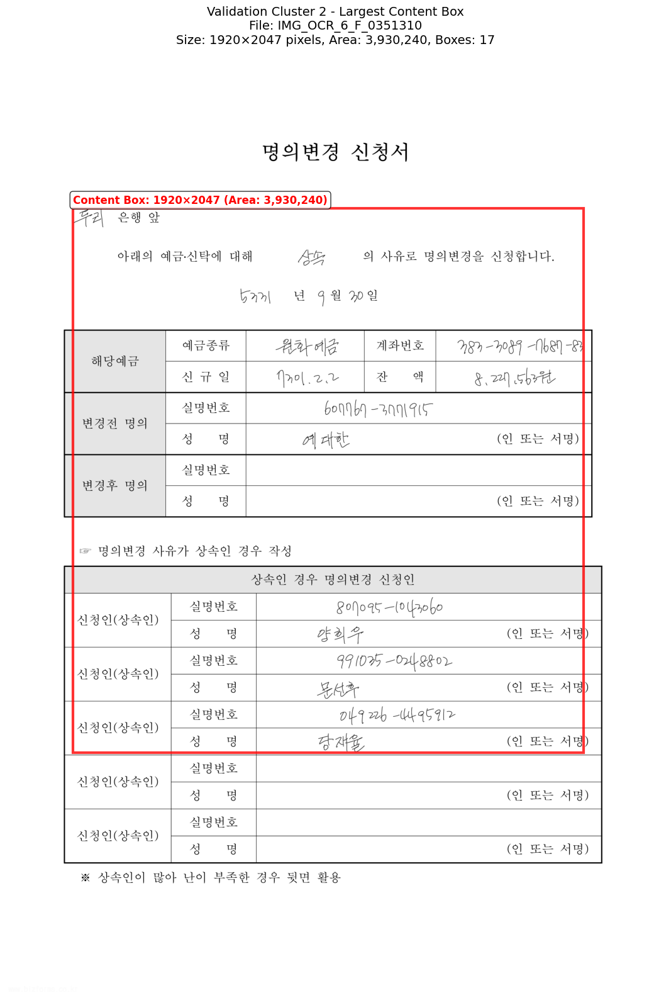


--- Cluster 3 Analysis ---
Processed 139 valid samples
Average content box: 1573×2401 pixels
Average area: 3,777,730 pixels
Largest content box: 1658×2404 pixels

Showing largest content box sample for Cluster 3:


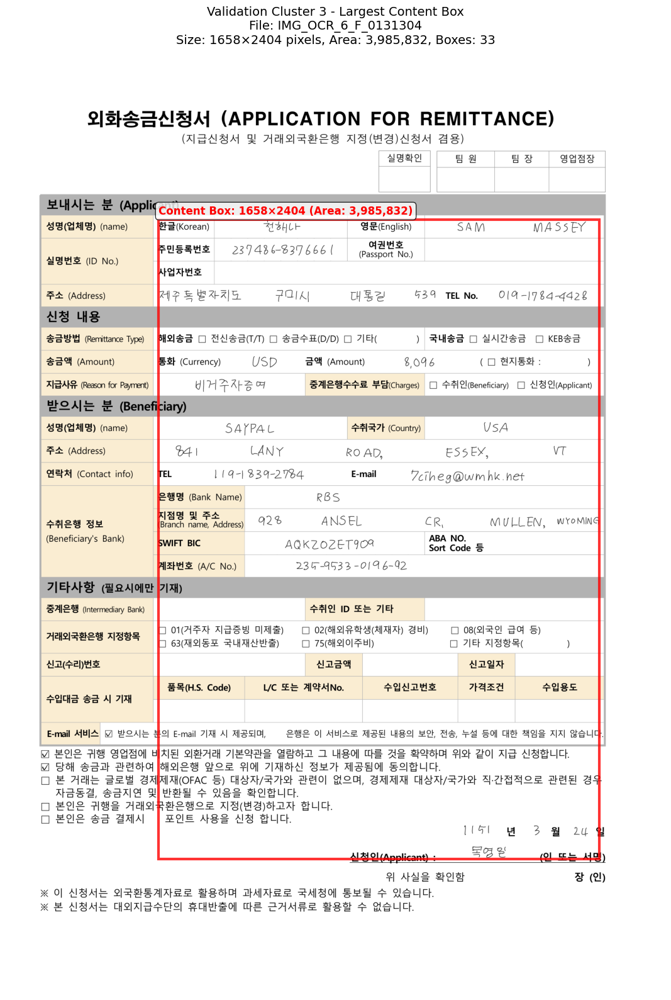


--- Cluster 4 Analysis ---
Processed 99 valid samples
Average content box: 2097×2855 pixels
Average area: 5,987,446 pixels
Largest content box: 2151×2870 pixels

Showing largest content box sample for Cluster 4:


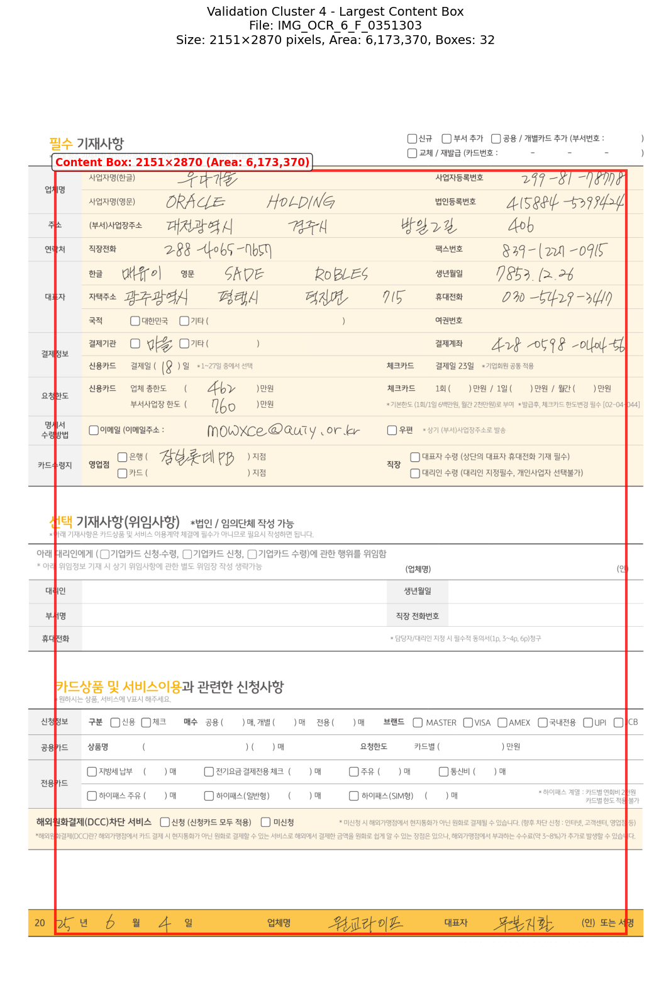


--- Cluster 5 Analysis ---
Processed 122 valid samples
Average content box: 1765×1494 pixels
Average area: 2,636,893 pixels
Largest content box: 1847×1508 pixels

Showing largest content box sample for Cluster 5:


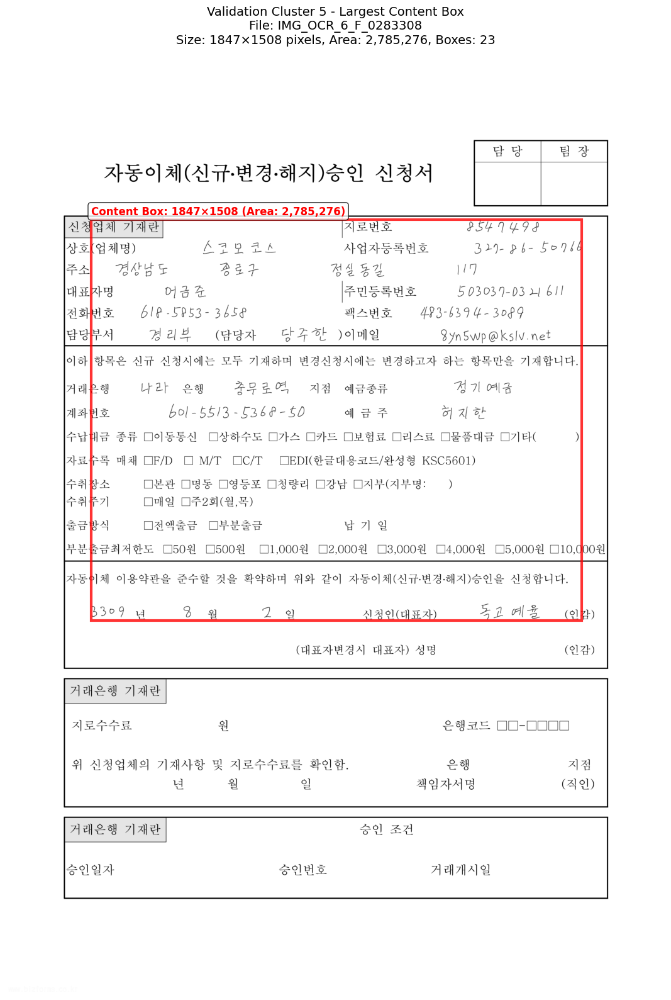


CONTENT BOX SUMMARY COMPARISON

Cluster    Dataset      Samples    Avg Area        Avg Size             Max Area       
----------------------------------------------------------------------------------------------------
0          Training     965           1,828,378 1534×1192               2,022,489
1          Training     1057          4,412,780 1826×2417               4,680,683
2          Training     1080          3,746,539 1848×2027               4,008,114
3          Training     866           3,792,164 1579×2401               4,034,892
4          Training     858           5,976,981 2093×2855               6,292,552
5          Training     917           2,638,575 1766×1494               2,883,990
0          Validation   115           1,825,497 1533×1191               1,907,958
1          Validation   120           4,413,666 1826×2417               4,640,640
2          Validation   132           3,752,335 1851×2027               3,930,240
3          Validation   139           3,

In [10]:
# Content Box Analysis for Each Cluster
import json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np
import os
import pandas as pd
from collections import defaultdict

def load_json_bbox(json_path):
    """Load bounding boxes from JSON file"""
    try:
        with open(json_path, 'r', encoding='utf-8') as f:
            data = json.load(f)
        return data.get('bbox', [])
    except:
        return []

def calculate_content_box(bbox_list):
    """Calculate the overall content box that contains all bboxes"""
    if not bbox_list:
        return None
    
    min_x = float('inf')
    min_y = float('inf') 
    max_x = 0
    max_y = 0
    
    for bbox in bbox_list:
        x_coords = bbox['x']
        y_coords = bbox['y']
        
        min_x = min(min_x, min(x_coords))
        max_x = max(max_x, max(x_coords))
        min_y = min(min_y, min(y_coords))
        max_y = max(max_y, max(y_coords))
    
    return {
        'x': min_x,
        'y': min_y,
        'width': max_x - min_x,
        'height': max_y - min_y,
        'area': (max_x - min_x) * (max_y - min_y)
    }

def draw_content_box_on_image(image_path, json_path, content_box, title=""):
    """Draw content box on image"""
    try:
        # Load image
        img = Image.open(image_path)
        
        # Create figure
        fig, ax = plt.subplots(1, 1, figsize=(12, 16))
        ax.imshow(img)
        ax.set_title(title, fontsize=14, pad=20)
        
        # Draw content box
        if content_box:
            rect = patches.Rectangle(
                (content_box['x'], content_box['y']), 
                content_box['width'], 
                content_box['height'],
                linewidth=3, 
                edgecolor='red', 
                facecolor='none',
                alpha=0.8
            )
            ax.add_patch(rect)
            
            # Add text with content box info
            ax.text(content_box['x'], content_box['y'] - 20, 
                   f"Content Box: {content_box['width']}×{content_box['height']} (Area: {content_box['area']:,})",
                   color='red', fontsize=12, fontweight='bold',
                   bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))
        
        ax.axis('off')
        plt.tight_layout()
        plt.show()
        
        return content_box
    except Exception as e:
        print(f"Error processing {image_path}: {str(e)}")
        return None

def analyze_cluster_content_boxes(cluster_results, dataset_name, base_image_dir, base_json_dir):
    """Analyze content boxes for each cluster"""
    print(f"\n{'='*80}")
    print(f"CONTENT BOX ANALYSIS - {dataset_name.upper()}")
    print(f"{'='*80}")
    
    cluster_content_analysis = {}
    
    for cluster_id, (df_cluster, images, max_ids) in cluster_results.items():
        print(f"\n--- Cluster {cluster_id} Analysis ---")
        
        if len(df_cluster) == 0:
            print(f"No data available for cluster {cluster_id}")
            continue
            
        content_boxes = []
        valid_samples = []
        
        # Process each image in the cluster
        for _, row in df_cluster.iterrows():
            identifier = row['Images.identifier']
            
            # Construct paths
            image_path = os.path.join(base_image_dir, f"{identifier}.png")
            json_path = os.path.join(base_json_dir, f"{identifier}.json")
            
            if os.path.exists(image_path) and os.path.exists(json_path):
                bbox_list = load_json_bbox(json_path)
                
                if bbox_list:
                    content_box = calculate_content_box(bbox_list)
                    if content_box:
                        content_boxes.append(content_box)
                        valid_samples.append({
                            'identifier': identifier,
                            'image_path': image_path,
                            'json_path': json_path,
                            'content_box': content_box,
                            'num_boxes': len(bbox_list)
                        })
        
        if content_boxes:
            # Calculate statistics
            areas = [cb['area'] for cb in content_boxes]
            widths = [cb['width'] for cb in content_boxes]
            heights = [cb['height'] for cb in content_boxes]
            
            cluster_stats = {
                'cluster_id': cluster_id,
                'num_samples': len(content_boxes),
                'avg_area': np.mean(areas),
                'max_area': np.max(areas),
                'min_area': np.min(areas),
                'avg_width': np.mean(widths),
                'avg_height': np.mean(heights),
                'largest_sample': max(valid_samples, key=lambda x: x['content_box']['area']),
                'samples': valid_samples
            }
            
            cluster_content_analysis[cluster_id] = cluster_stats
            
            print(f"Processed {len(content_boxes)} valid samples")
            print(f"Average content box: {cluster_stats['avg_width']:.0f}×{cluster_stats['avg_height']:.0f} pixels")
            print(f"Average area: {cluster_stats['avg_area']:,.0f} pixels")
            print(f"Largest content box: {cluster_stats['largest_sample']['content_box']['width']}×{cluster_stats['largest_sample']['content_box']['height']} pixels")
            
            # Show the sample with largest content box
            largest = cluster_stats['largest_sample']
            print(f"\nShowing largest content box sample for Cluster {cluster_id}:")
            draw_content_box_on_image(
                largest['image_path'],
                largest['json_path'],
                largest['content_box'],
                title=f"{dataset_name} Cluster {cluster_id} - Largest Content Box\n"
                      f"File: {largest['identifier']}\n"
                      f"Size: {largest['content_box']['width']}×{largest['content_box']['height']} pixels, "
                      f"Area: {largest['content_box']['area']:,}, Boxes: {largest['num_boxes']}"
            )
        else:
            print(f"No valid content boxes found for cluster {cluster_id}")
    
    return cluster_content_analysis

# Analyze training clusters
if train_cluster_results:
    train_content_analysis = analyze_cluster_content_boxes(
        train_cluster_results, 
        "Training",
        "train_image",
        "train_label"
    )
else:
    print("No training cluster results available")
    train_content_analysis = {}

# Analyze validation clusters  
if val_cluster_results:
    val_content_analysis = analyze_cluster_content_boxes(
        val_cluster_results,
        "Validation", 
        "valid_image",
        "valid_label"
    )
else:
    print("No validation cluster results available")
    val_content_analysis = {}

# Summary comparison
print(f"\n{'='*100}")
print("CONTENT BOX SUMMARY COMPARISON")
print(f"{'='*100}")

print(f"\n{'Cluster':<10} {'Dataset':<12} {'Samples':<10} {'Avg Area':<15} {'Avg Size':<20} {'Max Area':<15}")
print("-" * 100)

all_analyses = [
    (train_content_analysis, "Training"),
    (val_content_analysis, "Validation")
]

for analysis, dataset_name in all_analyses:
    for cluster_id, stats in analysis.items():
        avg_size = f"{stats['avg_width']:.0f}×{stats['avg_height']:.0f}"
        print(f"{cluster_id:<10} {dataset_name:<12} {stats['num_samples']:<10} {stats['avg_area']:>12,.0f} {avg_size:<20} {stats['max_area']:>12,.0f}")

print(f"\n{'='*100}")
print("Analysis complete! Each cluster's largest content box sample is displayed above.")

In [11]:
# Find the largest content box for each cluster (combining Training + Validation)
import json
import os
import numpy as np
from collections import defaultdict

def find_largest_content_box_per_cluster():
    """Find the single largest content box for each cluster across both training and validation datasets"""
    print(f"\n{'='*80}")
    print("FINDING LARGEST CONTENT BOX PER CLUSTER (Training + Validation Combined)")
    print(f"{'='*80}")
    
    # Dictionary to store the largest content box for each cluster
    cluster_largest_boxes = {}
    
    # Get all unique cluster IDs from both datasets
    all_cluster_ids = set()
    if train_cluster_results:
        all_cluster_ids.update(train_cluster_results.keys())
    if val_cluster_results:
        all_cluster_ids.update(val_cluster_results.keys())
    
    print(f"Processing {len(all_cluster_ids)} clusters: {sorted(all_cluster_ids)}")
    
    # Process each cluster
    for cluster_id in sorted(all_cluster_ids):
        print(f"\n--- Processing Cluster {cluster_id} ---")
        
        largest_content_box = None
        largest_area = 0
        largest_sample_info = None
        total_samples_checked = 0
        
        # Process training data for this cluster
        if cluster_id in train_cluster_results:
            df_cluster, images, max_ids = train_cluster_results[cluster_id]
            print(f"  Training samples: {len(df_cluster)}")
            
            for _, row in df_cluster.iterrows():
                identifier = row['Images.identifier']
                image_path = os.path.join("train_image", f"{identifier}.png")
                json_path = os.path.join("train_label", f"{identifier}.json")
                
                if os.path.exists(image_path) and os.path.exists(json_path):
                    try:
                        with open(json_path, 'r', encoding='utf-8') as f:
                            data = json.load(f)
                        bbox_list = data.get('bbox', [])
                        
                        if bbox_list:
                            # Calculate content box
                            min_x = float('inf')
                            min_y = float('inf') 
                            max_x = 0
                            max_y = 0
                            
                            for bbox in bbox_list:
                                x_coords = bbox['x']
                                y_coords = bbox['y']
                                
                                min_x = min(min_x, min(x_coords))
                                max_x = max(max_x, max(x_coords))
                                min_y = min(min_y, min(y_coords))
                                max_y = max(max_y, max(y_coords))
                            
                            content_box = {
                                'x': min_x,
                                'y': min_y,
                                'width': max_x - min_x,
                                'height': max_y - min_y,
                                'area': (max_x - min_x) * (max_y - min_y)
                            }
                            
                            total_samples_checked += 1
                            
                            # Check if this is the largest content box so far
                            if content_box['area'] > largest_area:
                                largest_area = content_box['area']
                                largest_content_box = content_box
                                largest_sample_info = {
                                    'identifier': identifier,
                                    'image_path': image_path,
                                    'json_path': json_path,
                                    'num_boxes': len(bbox_list),
                                    'dataset': 'Training'
                                }
                                
                    except Exception as e:
                        print(f"    Error processing training sample {identifier}: {str(e)}")
                        continue
        
        # Process validation data for this cluster
        if cluster_id in val_cluster_results:
            df_cluster, images, max_ids = val_cluster_results[cluster_id]
            print(f"  Validation samples: {len(df_cluster)}")
            
            for _, row in df_cluster.iterrows():
                identifier = row['Images.identifier']
                image_path = os.path.join("valid_image", f"{identifier}.png")
                json_path = os.path.join("valid_label", f"{identifier}.json")
                
                if os.path.exists(image_path) and os.path.exists(json_path):
                    try:
                        with open(json_path, 'r', encoding='utf-8') as f:
                            data = json.load(f)
                        bbox_list = data.get('bbox', [])
                        
                        if bbox_list:
                            # Calculate content box
                            min_x = float('inf')
                            min_y = float('inf') 
                            max_x = 0
                            max_y = 0
                            
                            for bbox in bbox_list:
                                x_coords = bbox['x']
                                y_coords = bbox['y']
                                
                                min_x = min(min_x, min(x_coords))
                                max_x = max(max_x, max(x_coords))
                                min_y = min(min_y, min(y_coords))
                                max_y = max(max_y, max(y_coords))
                            
                            content_box = {
                                'x': min_x,
                                'y': min_y,
                                'width': max_x - min_x,
                                'height': max_y - min_y,
                                'area': (max_x - min_x) * (max_y - min_y)
                            }
                            
                            total_samples_checked += 1
                            
                            # Check if this is the largest content box so far
                            if content_box['area'] > largest_area:
                                largest_area = content_box['area']
                                largest_content_box = content_box
                                largest_sample_info = {
                                    'identifier': identifier,
                                    'image_path': image_path,
                                    'json_path': json_path,
                                    'num_boxes': len(bbox_list),
                                    'dataset': 'Validation'
                                }
                                
                    except Exception as e:
                        print(f"    Error processing validation sample {identifier}: {str(e)}")
                        continue
        
        # Store the result for this cluster
        if largest_content_box:
            cluster_largest_boxes[cluster_id] = {
                'content_box': largest_content_box,
                'sample_info': largest_sample_info,
                'total_samples_checked': total_samples_checked
            }
            
            print(f"  Total samples checked: {total_samples_checked}")
            print(f"  Largest content box:")
            print(f"    - Dataset: {largest_sample_info['dataset']}")
            print(f"    - File: {largest_sample_info['identifier']}")
            print(f"    - Size: {largest_content_box['width']}×{largest_content_box['height']} pixels")
            print(f"    - Area: {largest_content_box['area']:,} pixels")
            print(f"    - Number of bboxes: {largest_sample_info['num_boxes']}")
        else:
            print(f"  No valid content boxes found for cluster {cluster_id}")
    
    return cluster_largest_boxes

# Execute the analysis
cluster_largest_content_boxes = find_largest_content_box_per_cluster()

# Display final summary
print(f"\n{'='*100}")
print("FINAL SUMMARY: LARGEST CONTENT BOX PER CLUSTER")
print(f"{'='*100}")

print(f"{'Cluster':<8} {'Dataset':<12} {'Width':<8} {'Height':<8} {'Area':<15} {'Samples':<8} {'File':<25}")
print("-" * 100)

all_results = []
for cluster_id in sorted(cluster_largest_content_boxes.keys()):
    data = cluster_largest_content_boxes[cluster_id]
    cb = data['content_box']
    sample = data['sample_info']
    samples_checked = data['total_samples_checked']
    
    print(f"{cluster_id:<8} {sample['dataset']:<12} {cb['width']:<8.0f} {cb['height']:<8.0f} {cb['area']:<15,.0f} {samples_checked:<8} {sample['identifier']:<25}")
    all_results.append((cluster_id, sample['dataset'], cb, sample, samples_checked))

# Find the overall largest content box across all clusters
if all_results:
    overall_largest = max(all_results, key=lambda x: x[2]['area'])
    
    print(f"\n{'='*100}")
    print("OVERALL LARGEST CONTENT BOX ACROSS ALL CLUSTERS")
    print(f"{'='*100}")
    print(f"Cluster: {overall_largest[0]}")
    print(f"Dataset: {overall_largest[1]}")
    print(f"File: {overall_largest[3]['identifier']}")
    print(f"Size: {overall_largest[2]['width']}×{overall_largest[2]['height']} pixels")
    print(f"Area: {overall_largest[2]['area']:,} pixels")
    print(f"Number of bboxes: {overall_largest[3]['num_boxes']}")
    print(f"{'='*100}")

print(f"\nAnalysis complete! Found largest content box for {len(cluster_largest_content_boxes)} clusters.")
print(f"Results stored in 'cluster_largest_content_boxes' variable.")


FINDING LARGEST CONTENT BOX PER CLUSTER (Training + Validation Combined)
Processing 6 clusters: [np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5)]

--- Processing Cluster 0 ---
  Training samples: 965
  Validation samples: 115
  Total samples checked: 1080
  Largest content box:
    - Dataset: Training
    - File: IMG_OCR_6_F_0118602
    - Size: 1701×1189 pixels
    - Area: 2,022,489 pixels
    - Number of bboxes: 20

--- Processing Cluster 1 ---
  Training samples: 1057
  Validation samples: 120
  Total samples checked: 1177
  Largest content box:
    - Dataset: Training
    - File: IMG_OCR_6_F_0369907
    - Size: 1927×2429 pixels
    - Area: 4,680,683 pixels
    - Number of bboxes: 17

--- Processing Cluster 2 ---
  Training samples: 1080
  Validation samples: 132
  Total samples checked: 1212
  Largest content box:
    - Dataset: Training
    - File: IMG_OCR_6_F_0028910
    - Size: 1959×2046 pixels
    - Area: 4,008,114 pixels
    - Number of bboxes: 17


Target crop size: 1024×1024 pixels
Processing 6 clusters...

--- Processing Cluster 0 ---
  Image: IMG_OCR_6_F_0118602
  Original size: (2480, 3508)
  Content box: 1701×1189 at (430, 1803)
  Crop box: 1721×1721 at (420, 1537) [padding: 10px]
  Final cropped size: (1024, 1024)
  Visualizing cropping process...


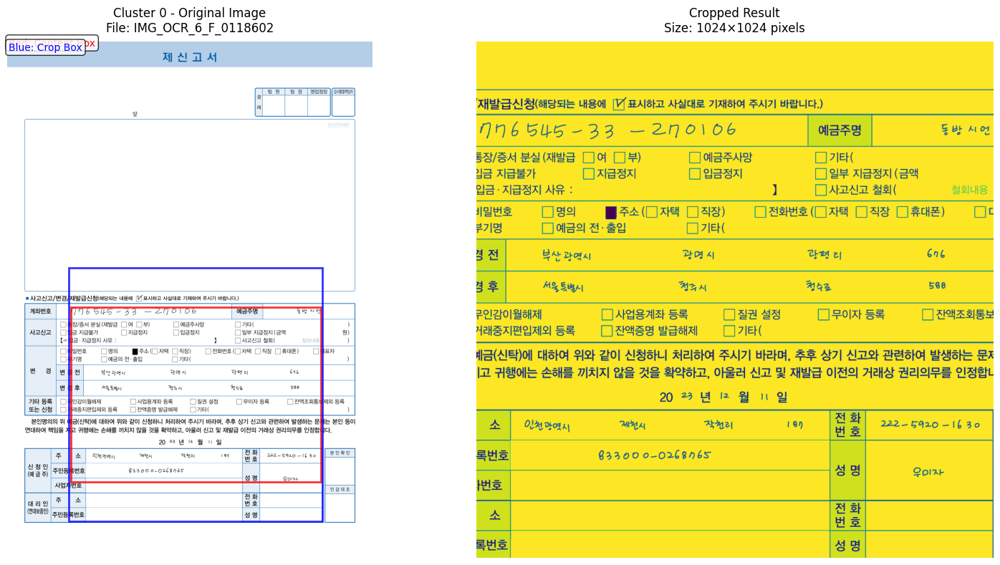


--- Processing Cluster 1 ---
  Image: IMG_OCR_6_F_0369907
  Original size: (2479, 3504)
  Content box: 1927×2429 at (254, 824)
  Crop box: 2449×2449 at (-7, 814) [padding: 10px]
  Final cropped size: (1024, 1024)
  Visualizing cropping process...


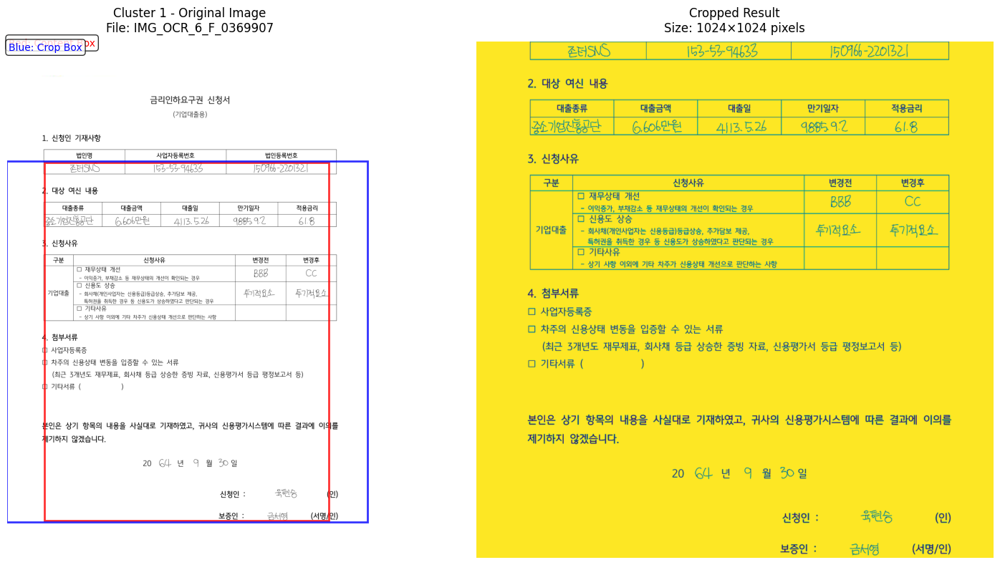


--- Processing Cluster 2 ---
  Image: IMG_OCR_6_F_0028910
  Original size: (2479, 3508)
  Content box: 1959×2046 at (231, 549)
  Crop box: 2066×2066 at (177, 539) [padding: 10px]
  Final cropped size: (1024, 1024)
  Visualizing cropping process...


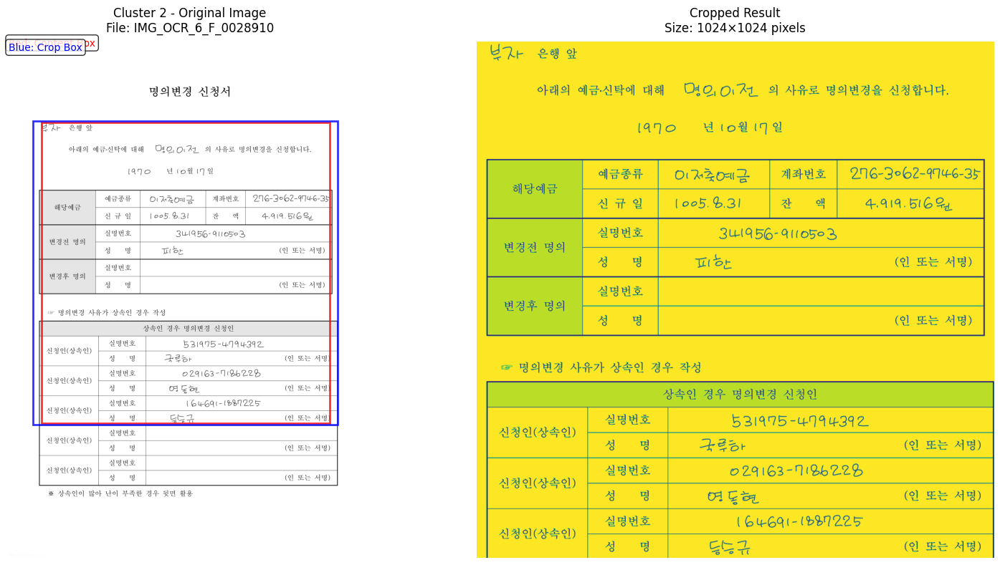


--- Processing Cluster 3 ---
  Image: IMG_OCR_6_F_0029104
  Original size: (2479, 3508)
  Content box: 1668×2419 at (564, 590)
  Crop box: 2439×2439 at (179, 580) [padding: 10px]
  Final cropped size: (1024, 1024)
  Visualizing cropping process...


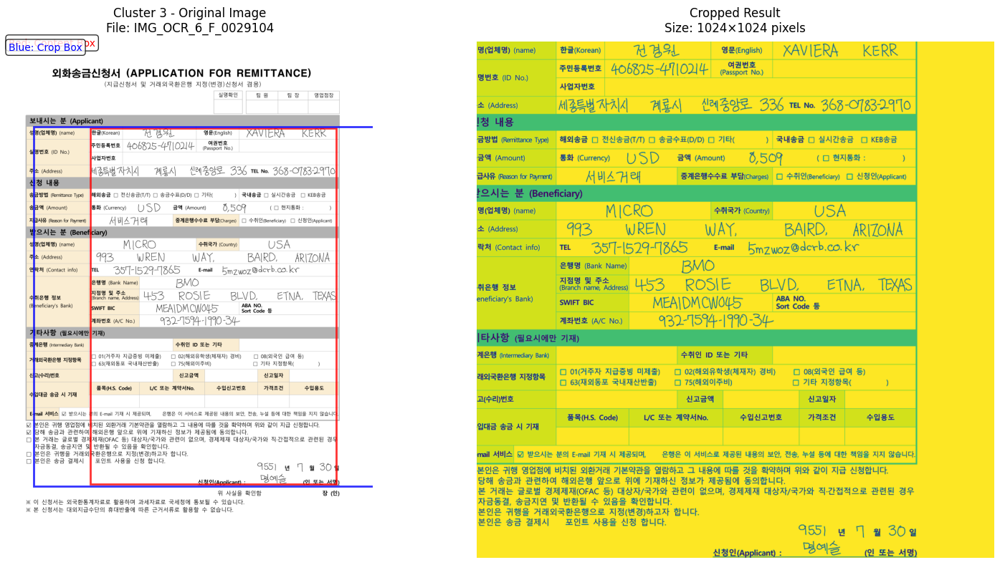


--- Processing Cluster 4 ---
  Image: IMG_OCR_6_F_0190603
  Original size: (2480, 3508)
  Content box: 2191×2872 at (179, 410)
  Crop box: 2892×2892 at (-172, 400) [padding: 10px]
  Final cropped size: (1024, 1024)
  Visualizing cropping process...


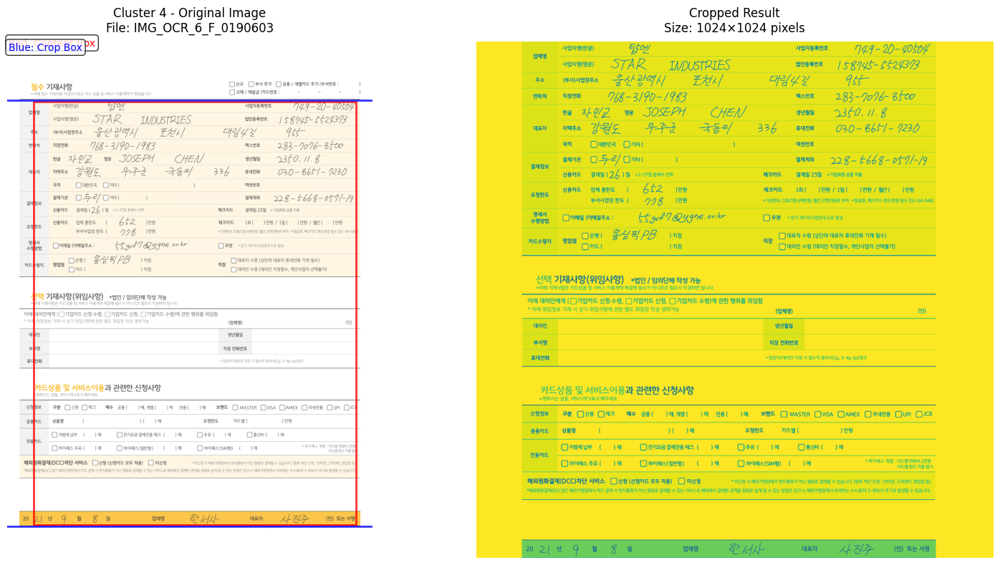


--- Processing Cluster 5 ---
  Image: IMG_OCR_6_F_0178908
  Original size: (2479, 3508)
  Content box: 1915×1506 at (315, 604)
  Crop box: 1935×1935 at (305, 390) [padding: 10px]
  Final cropped size: (1024, 1024)
  Visualizing cropping process...


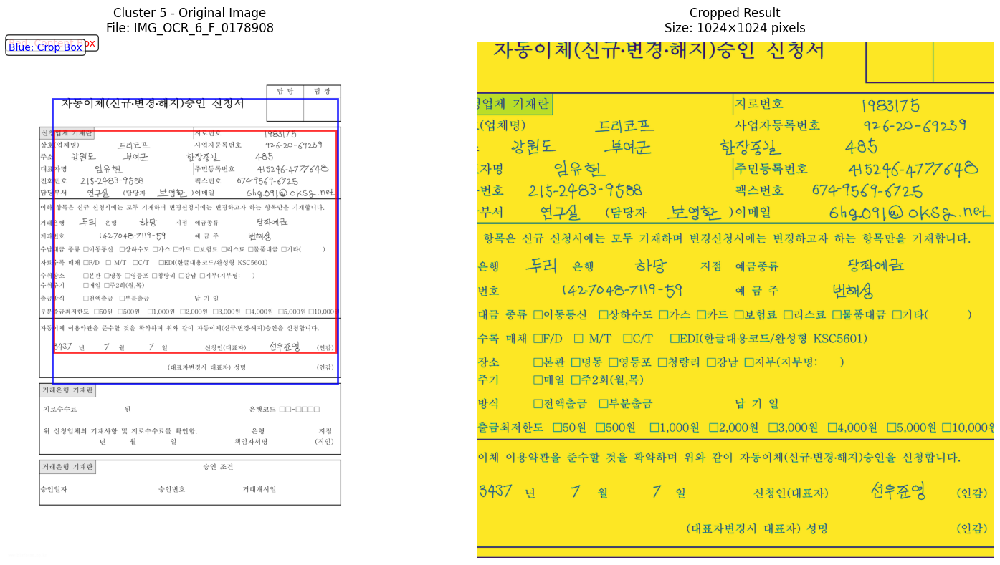


Processing training images...
  Processed 500/5743 training images
  Processed 1000/5743 training images
  Processed 1500/5743 training images
  Processed 2000/5743 training images
  Processed 2500/5743 training images
  Processed 3000/5743 training images
  Processed 3500/5743 training images
  Processed 4000/5743 training images
  Processed 4500/5743 training images
  Processed 5000/5743 training images
  Processed 5500/5743 training images

Processing validation images...
  Processed 500/727 validation images

SQUARE CROPPING SUMMARY

Cropping Configuration:
  Target size: 1024×1024 pixels
  Max padding: 10 pixels (tight crop)
  Padding color: White (255)

Cluster Cropping Details:
Cluster  Dataset      Original        Content Box     Crop Box   Final          
------------------------------------------------------------------------------------------
0        Training     2480×3508       1701×1189       1721×1721  1024×1024      
1        Training     2479×3504       1927×2429     

In [12]:
# Create square-shaped cropping boxes for each cluster and generate cropped images
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import json
import os

def create_square_cropping_box(content_box, image_shape, max_padding=10):
    # Add minimal padding to content box (at most 10 pixels)
    padding_w = min(max_padding, content_box['width'] // 100)  # Very small padding
    padding_h = min(max_padding, content_box['height'] // 100)  # Very small padding
    
    # Use the same padding for both dimensions to maintain consistency
    padding = min(padding_w, padding_h, max_padding)
    
    padded_x = max(0, content_box['x'] - padding)
    padded_y = max(0, content_box['y'] - padding)
    padded_width = content_box['width'] + 2 * padding
    padded_height = content_box['height'] + 2 * padding
    
    # Make it square by taking the maximum dimension
    square_size = max(padded_width, padded_height)
    
    # Center the square box around the padded content box
    center_x = padded_x + padded_width // 2
    center_y = padded_y + padded_height // 2
    
    square_x = center_x - square_size // 2
    square_y = center_y - square_size // 2
    
    return {
        'x': square_x,
        'y': square_y,
        'size': square_size,
        'padding_used': padding
    }

def crop_image_with_padding(image, crop_box, target_size=None):
    if isinstance(image, Image.Image):
        image_array = np.array(image)
    else:
        image_array = image.copy()
    
    img_height, img_width = image_array.shape[:2]
    
    # Calculate crop boundaries
    x1 = crop_box['x']
    y1 = crop_box['y'] 
    x2 = x1 + crop_box['size']
    y2 = y1 + crop_box['size']
    
    # Calculate padding needed
    pad_left = max(0, -x1)
    pad_top = max(0, -y1)
    pad_right = max(0, x2 - img_width)
    pad_bottom = max(0, y2 - img_height)
    
    # Adjust crop coordinates to image boundaries
    x1_crop = max(0, x1)
    y1_crop = max(0, y1)
    x2_crop = min(img_width, x2)
    y2_crop = min(img_height, y2)
    
    # Crop the available region
    if len(image_array.shape) == 3:
        cropped = image_array[y1_crop:y2_crop, x1_crop:x2_crop, :]
    else:
        cropped = image_array[y1_crop:y2_crop, x1_crop:x2_crop]
    
    # Add padding if needed
    if pad_left > 0 or pad_top > 0 or pad_right > 0 or pad_bottom > 0:
        if len(image_array.shape) == 3:
            # Color image
            padded = np.pad(cropped, 
                          ((pad_top, pad_bottom), (pad_left, pad_right), (0, 0)), 
                          mode='constant', constant_values=255)  # White padding
        else:
            # Grayscale image
            padded = np.pad(cropped, 
                          ((pad_top, pad_bottom), (pad_left, pad_right)), 
                          mode='constant', constant_values=255)  # White padding
    else:
        padded = cropped
    
    # Convert back to PIL Image
    result_image = Image.fromarray(padded)
    
    # Resize to target size if specified
    if target_size:
        result_image = result_image.resize((target_size, target_size), Image.LANCZOS)
    
    return result_image

def visualize_cropping_process(image_path, content_box, crop_box, cropped_image, cluster_id, sample_info):
    # Load original image
    original_img = Image.open(image_path)
    
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    
    # Left plot: Original image with boxes
    axes[0].imshow(original_img)
    axes[0].set_title(f'Cluster {cluster_id} - Original Image\nFile: {sample_info["identifier"]}', 
                     fontsize=12, pad=10)
    
    # Draw content box (red)
    content_rect = patches.Rectangle(
        (content_box['x'], content_box['y']), 
        content_box['width'], content_box['height'],
        linewidth=2, edgecolor='red', facecolor='none', alpha=0.8
    )
    axes[0].add_patch(content_rect)
    
    # Draw crop box (blue)
    crop_rect = patches.Rectangle(
        (crop_box['x'], crop_box['y']), 
        crop_box['size'], crop_box['size'],
        linewidth=2, edgecolor='blue', facecolor='none', alpha=0.8
    )
    axes[0].add_patch(crop_rect)
    
    # Add legend
    axes[0].text(10, 30, 'Red: Content Box', color='red', fontsize=10, 
                bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))
    axes[0].text(10, 60, 'Blue: Crop Box', color='blue', fontsize=10,
                bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))
    
    axes[0].axis('off')
    
    # Right plot: Cropped result
    axes[1].imshow(cropped_image)
    axes[1].set_title(f'Cropped Result\nSize: {cropped_image.size[0]}×{cropped_image.size[1]} pixels', 
                     fontsize=12, pad=10)
    axes[1].axis('off')
    
    plt.tight_layout()
    plt.show()

# Define target size for final cropped images
CROP_TARGET_SIZE = 1024  # pixels

cluster_cropped_images = {}
cropping_summary = {}

print(f"Target crop size: {CROP_TARGET_SIZE}×{CROP_TARGET_SIZE} pixels")
print(f"Processing {len(cluster_largest_content_boxes)} clusters...")

for cluster_id in sorted(cluster_largest_content_boxes.keys()):
    print(f"\n--- Processing Cluster {cluster_id} ---")
    
    # Get the largest content box info for this cluster
    cluster_data = cluster_largest_content_boxes[cluster_id]
    content_box = cluster_data['content_box']
    sample_info = cluster_data['sample_info']
    
    # Load the image
    image_path = sample_info['image_path']
    try:
        original_image = Image.open(image_path)
        if original_image.mode != 'L':
            original_image = original_image.convert('L')  # Convert to grayscale
        
        print(f"  Image: {sample_info['identifier']}")
        print(f"  Original size: {original_image.size}")
        print(f"  Content box: {content_box['width']}×{content_box['height']} at ({content_box['x']}, {content_box['y']})")
        
        # Create square cropping box with tight padding
        crop_box = create_square_cropping_box(
            content_box, 
            (original_image.size[1], original_image.size[0]),  # (height, width)
            max_padding=10  # Maximum 10 pixels padding
        )
        
        print(f"  Crop box: {crop_box['size']}×{crop_box['size']} at ({crop_box['x']}, {crop_box['y']}) [padding: {crop_box['padding_used']}px]")
        
        # Generate cropped image
        cropped_image = crop_image_with_padding(
            original_image, 
            crop_box, 
            target_size=CROP_TARGET_SIZE
        )
        
        print(f"  Final cropped size: {cropped_image.size}")
        
        # Store results
        cluster_cropped_images[cluster_id] = {
            'cropped_image': cropped_image,
            'crop_box': crop_box,
            'content_box': content_box,
            'sample_info': sample_info,
            'original_image': original_image
        }
        
        cropping_summary[cluster_id] = {
            'original_size': original_image.size,
            'content_box_size': (content_box['width'], content_box['height']),
            'crop_box_size': crop_box['size'],
            'final_size': cropped_image.size,
            'dataset': sample_info['dataset'],
            'file': sample_info['identifier']
        }
        
        # Visualize the cropping process
        print(f"  Visualizing cropping process...")
        visualize_cropping_process(
            image_path, content_box, crop_box, cropped_image, 
            cluster_id, sample_info
        )
        
    except Exception as e:
        print(f"  Error processing cluster {cluster_id}: {str(e)}")
        continue

def get_image_cluster(image_identifier, train_results, val_results):
    # Check training clusters
    for cluster_id, (df_cluster, images, max_ids) in train_results.items():
        if image_identifier in df_cluster['Images.identifier'].values:
            return cluster_id, 'train'
    
    # Check validation clusters  
    for cluster_id, (df_cluster, images, max_ids) in val_results.items():
        if image_identifier in df_cluster['Images.identifier'].values:
            return cluster_id, 'val'
    
    return None, None

# Recreate li_X_train and li_X_val with cropped images
print("\nProcessing training images...")
new_li_X_train = []
cropped_count_train = 0

for i, (original_image, df_row) in enumerate(zip(li_X_train, df_y_train.iterrows())):
    _, row = df_row
    identifier = row['Images.identifier'] 
    
    # Find which cluster this image belongs to
    cluster_id, dataset_type = get_image_cluster(identifier, train_cluster_results, val_cluster_results)
    
    if cluster_id is not None and cluster_id in cluster_cropped_images:
        # Get the cropping parameters for this cluster
        cluster_crop_data = cluster_cropped_images[cluster_id]
        crop_box = cluster_crop_data['crop_box']
        
        # Apply the same cropping to this image
        try:
            if isinstance(original_image, Image.Image):
                img_to_crop = original_image
            else:
                img_to_crop = Image.fromarray(original_image)
            
            if img_to_crop.mode != 'L':
                img_to_crop = img_to_crop.convert('L')
                
            cropped_img = crop_image_with_padding(
                img_to_crop, 
                crop_box, 
                target_size=CROP_TARGET_SIZE
            )
            new_li_X_train.append(cropped_img)
            cropped_count_train += 1
            
        except Exception as e:
            print(f"Error cropping training image {identifier}: {str(e)}")
            # Keep original image if cropping fails
            new_li_X_train.append(original_image)
    else:
        # Keep original image if no cluster mapping found
        new_li_X_train.append(original_image)
    
    if (i + 1) % 500 == 0:
        print(f"  Processed {i + 1}/{len(li_X_train)} training images")

print("\nProcessing validation images...")
new_li_X_val = []
cropped_count_val = 0

for i, (original_image, df_row) in enumerate(zip(li_X_val, df_y_val.iterrows())):
    _, row = df_row
    identifier = row['Images.identifier']
    
    # Find which cluster this image belongs to
    cluster_id, dataset_type = get_image_cluster(identifier, train_cluster_results, val_cluster_results)
    
    if cluster_id is not None and cluster_id in cluster_cropped_images:
        # Get the cropping parameters for this cluster
        cluster_crop_data = cluster_cropped_images[cluster_id]
        crop_box = cluster_crop_data['crop_box']
        
        # Apply the same cropping to this image
        try:
            if isinstance(original_image, Image.Image):
                img_to_crop = original_image
            else:
                img_to_crop = Image.fromarray(original_image)
                
            if img_to_crop.mode != 'L':
                img_to_crop = img_to_crop.convert('L')
                
            cropped_img = crop_image_with_padding(
                img_to_crop, 
                crop_box, 
                target_size=CROP_TARGET_SIZE
            )
            new_li_X_val.append(cropped_img)
            cropped_count_val += 1
            
        except Exception as e:
            print(f"Error cropping validation image {identifier}: {str(e)}")
            # Keep original image if cropping fails
            new_li_X_val.append(original_image)
    else:
        # Keep original image if no cluster mapping found
        new_li_X_val.append(original_image)
    
    if (i + 1) % 500 == 0:
        print(f"  Processed {i + 1}/{len(li_X_val)} validation images")

# Update the original lists
li_X_train = new_li_X_train
li_X_val = new_li_X_val

# Final summary
print(f"\n{'='*100}")
print("SQUARE CROPPING SUMMARY")
print(f"{'='*100}")

print(f"\nCropping Configuration:")
print(f"  Target size: {CROP_TARGET_SIZE}×{CROP_TARGET_SIZE} pixels")
print(f"  Max padding: 10 pixels (tight crop)")
print(f"  Padding color: White (255)")

print(f"\nCluster Cropping Details:")
print(f"{'Cluster':<8} {'Dataset':<12} {'Original':<15} {'Content Box':<15} {'Crop Box':<10} {'Final':<15}")
print("-" * 90)

for cluster_id in sorted(cropping_summary.keys()):
    summary = cropping_summary[cluster_id]
    orig_size = f"{summary['original_size'][0]}×{summary['original_size'][1]}"
    content_size = f"{summary['content_box_size'][0]}×{summary['content_box_size'][1]}"
    crop_size = f"{summary['crop_box_size']}×{summary['crop_box_size']}"
    final_size = f"{summary['final_size'][0]}×{summary['final_size'][1]}"
    
    print(f"{cluster_id:<8} {summary['dataset']:<12} {orig_size:<15} {content_size:<15} {crop_size:<10} {final_size:<15}")

print(f"\nDataset Processing Results:")
print(f"  Training images: {len(li_X_train)} ({cropped_count_train} cropped)")
print(f"  Validation images: {len(li_X_val)} ({cropped_count_val} cropped)")
print(f"  Total images: {len(li_X_train) + len(li_X_val)}")

print(f"\n✅ Square cropping completed!")
print(f"Updated li_X_train and li_X_val contain the cropped images.")
print(f"{'='*100}")

Found 5743 image-to-cluster mappings
  Processed 100 images (scale factor: 0.595)...
  Processed 200 images (scale factor: 0.595)...
  Processed 300 images (scale factor: 0.595)...
  Processed 400 images (scale factor: 0.595)...
  Processed 500 images (scale factor: 0.595)...
  Processed 600 images (scale factor: 0.595)...
  Processed 700 images (scale factor: 0.595)...
  Processed 800 images (scale factor: 0.595)...
  Processed 900 images (scale factor: 0.595)...
  Processed 1000 images (scale factor: 0.418)...
  Processed 1100 images (scale factor: 0.418)...
  Processed 1200 images (scale factor: 0.418)...
  Processed 1300 images (scale factor: 0.418)...
  Processed 1400 images (scale factor: 0.418)...
  Processed 1500 images (scale factor: 0.418)...
  Processed 1600 images (scale factor: 0.418)...
  Processed 1700 images (scale factor: 0.418)...
  Processed 1800 images (scale factor: 0.418)...
  Processed 1900 images (scale factor: 0.418)...
  Processed 2000 images (scale factor: 0.

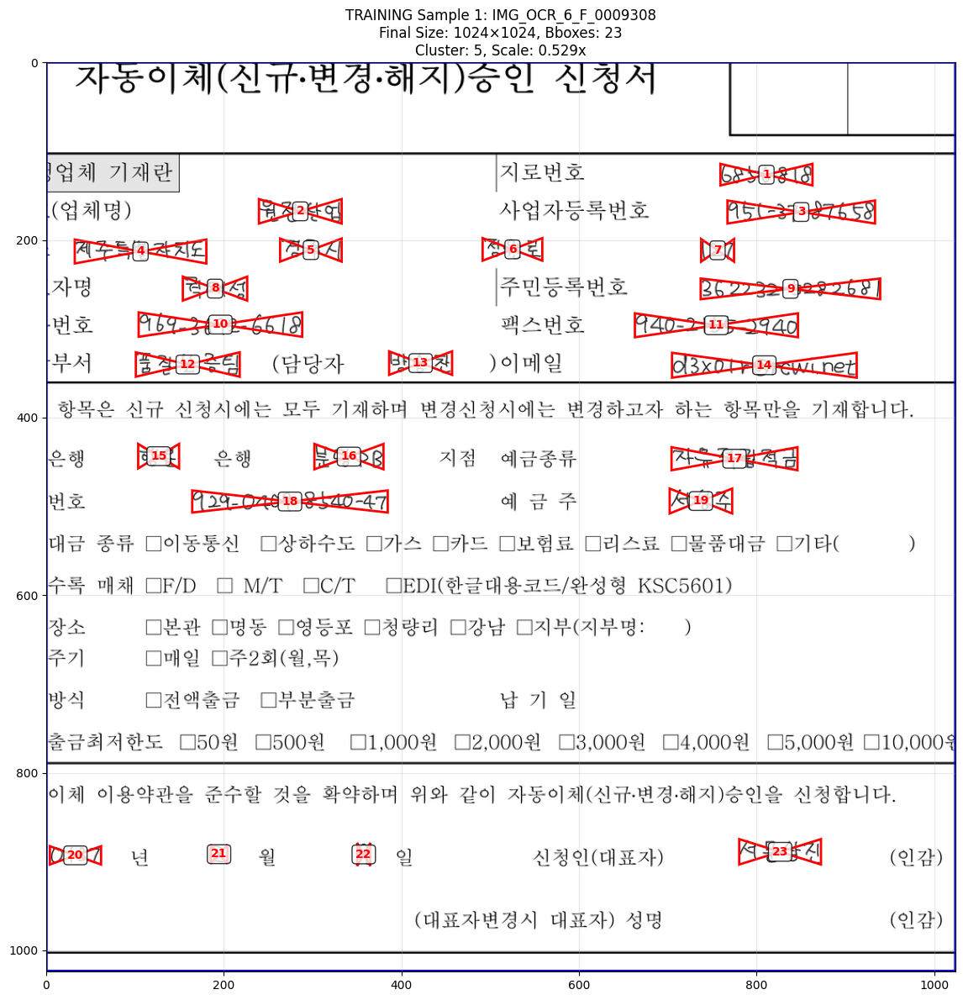


Sample 2/2 (Index: 2596)
  Image ID: IMG_OCR_6_F_0014510
  Cluster: 2
  Image shape: (1024, 1024) (should be 1024×1024)
  Crop offset: (177, 539)
  Original crop size: 2066×2066
  Resize scale factor: 0.496
  Number of bboxes: 17
    BBox 1: (45.6-87.2, 10.4-40.6) size: 41.6×30.2
    BBox 2: (459.5-502.1, 85.7-113.5) size: 42.6×27.8
    BBox 3: (344.5-397.5, 157.1-184.9) size: 53.0×27.8
    BBox 4: (490.2-508.5, 154.6-185.9) size: 18.3×31.2
    BBox 5: (549.2-578.9, 161.6-182.4) size: 29.7×20.8
    BBox 6: (396.5-533.8, 252.8-281.5) size: 137.3×28.7
    BBox 7: (756.4-961.5, 249.8-276.6) size: 205.2×26.8
    BBox 8: (417.8-526.4, 309.8-338.0) size: 108.5×28.3
    BBox 9: (792.0-926.9, 309.8-340.5) size: 134.8×30.7
    BBox 10: (497.1-700.3, 367.8-395.5) size: 203.2×27.8
    BBox 11: (470.9-538.3, 419.8-452.5) size: 67.4×32.7
    BBox 12: (526.4-718.2, 737.5-763.8) size: 191.8×26.3
    BBox 13: (478.8-571.0, 789.1-817.3) size: 92.2×28.3
    BBox 14: (530.8-723.1, 838.1-865.4) size: 192

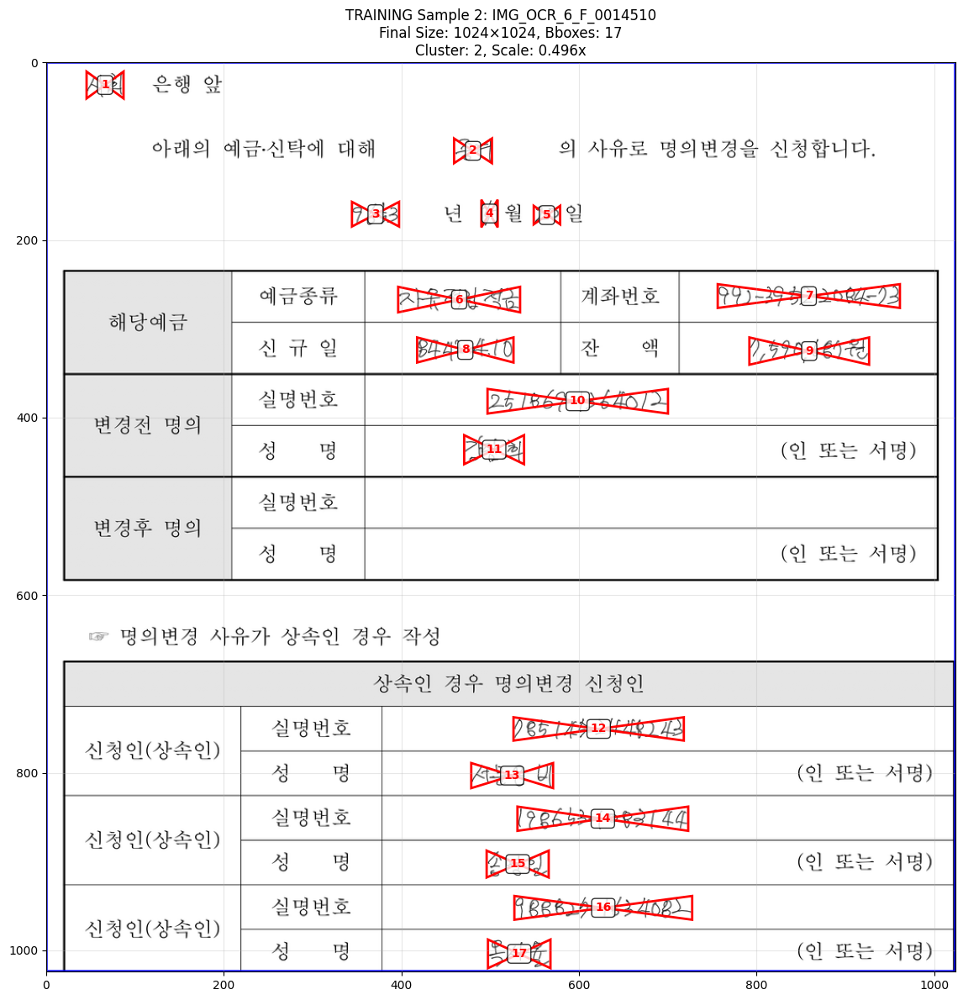


Sample 1/2 (Index: 442)
  Image ID: IMG_OCR_6_F_0044504
  Cluster: 3
  Image shape: (1024, 1024) (should be 1024×1024)
  Crop offset: (179, 580)
  Original crop size: 2439×2439
  Resize scale factor: 0.420
  Number of bboxes: 33
    BBox 1: (330.0-387.9, 9.2-33.6) size: 57.9×24.4
    BBox 2: (615.5-701.6, 11.3-30.6) size: 86.1×19.3
    BBox 3: (751.9-844.3, 9.7-29.4) size: 92.4×19.7
    BBox 4: (277.1-442.1, 46.2-65.5) size: 165.0×19.3
    BBox 5: (194.8-269.1, 118.0-139.8) size: 74.3×21.8
    BBox 6: (347.6-402.2, 119.2-140.2) size: 54.6×21.0
    BBox 7: (461.8-530.7, 117.6-139.8) size: 68.9×22.3
    BBox 8: (567.6-602.9, 118.4-136.0) size: 35.3×17.6
    BBox 9: (698.2-845.6, 118.4-139.0) size: 147.4×20.6
    BBox 10: (312.8-351.8, 223.4-241.0) size: 39.0×17.6
    BBox 11: (552.5-604.2, 222.5-244.3) size: 51.6×21.8
    BBox 12: (222.5-335.5, 259.0-281.3) size: 112.9×22.3
    BBox 13: (280.9-335.5, 327.5-348.1) size: 54.6×20.6
    BBox 14: (677.2-717.1, 327.9-346.0) size: 39.9×18.1
  

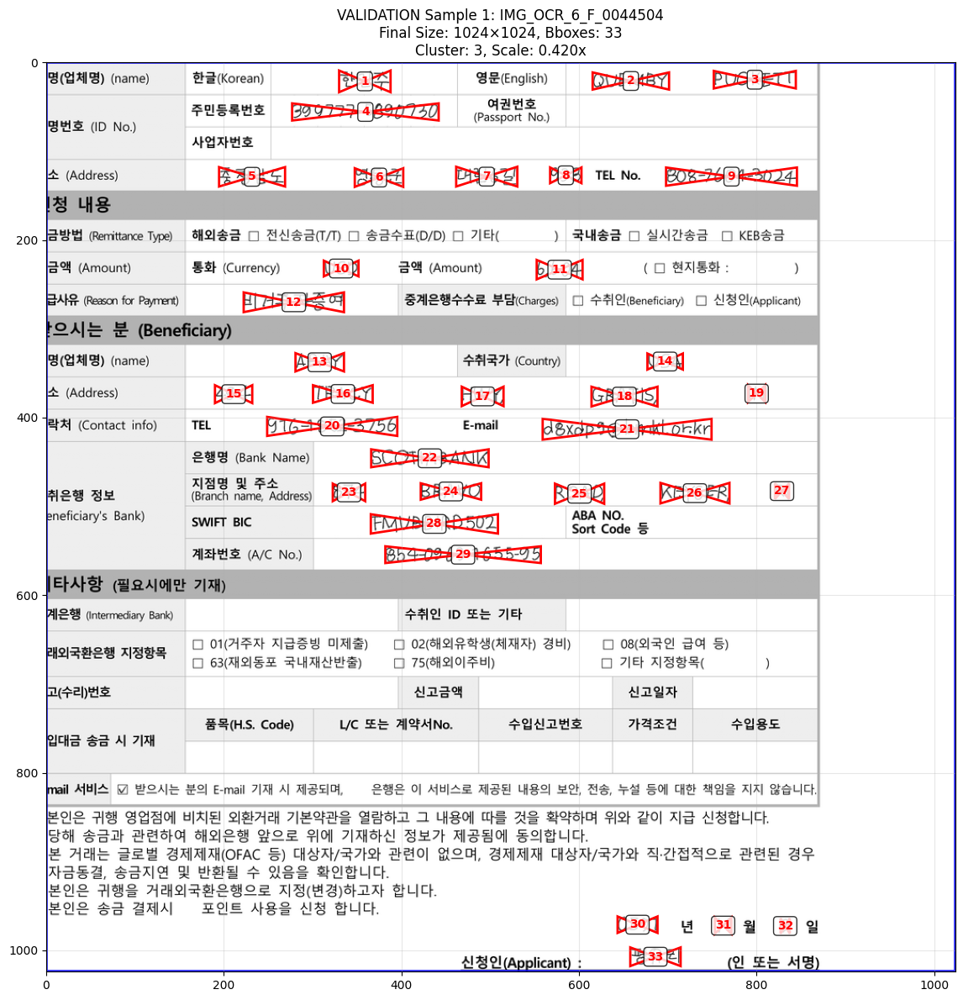


Sample 2/2 (Index: 307)
  Image ID: IMG_OCR_6_F_0185210
  Cluster: 2
  Image shape: (1024, 1024) (should be 1024×1024)
  Crop offset: (177, 539)
  Original crop size: 2066×2066
  Resize scale factor: 0.496
  Number of bboxes: 17
    BBox 1: (40.1-74.8, 7.4-35.2) size: 34.7×27.8
    BBox 2: (458.0-498.6, 88.7-112.5) size: 40.6×23.8
    BBox 3: (338.5-395.5, 162.6-181.4) size: 57.0×18.8
    BBox 4: (489.2-501.1, 163.6-183.4) size: 11.9×19.8
    BBox 5: (550.2-575.9, 164.1-185.9) size: 25.8×21.8
    BBox 6: (442.1-489.7, 255.3-275.6) size: 47.6×20.3
    BBox 7: (748.4-966.0, 251.3-276.6) size: 217.6×25.3
    BBox 8: (404.4-521.9, 310.8-332.6) size: 117.5×21.8
    BBox 9: (785.1-929.8, 308.8-334.1) size: 144.7×25.3
    BBox 10: (496.1-692.9, 366.8-393.5) size: 196.8×26.8
    BBox 11: (462.4-537.8, 424.3-450.5) size: 75.3×26.3
    BBox 12: (525.9-713.2, 741.0-766.8) size: 187.4×25.8
    BBox 13: (493.7-552.1, 787.1-812.4) size: 58.5×25.3
    BBox 14: (519.9-717.2, 838.6-861.9) size: 197.3×

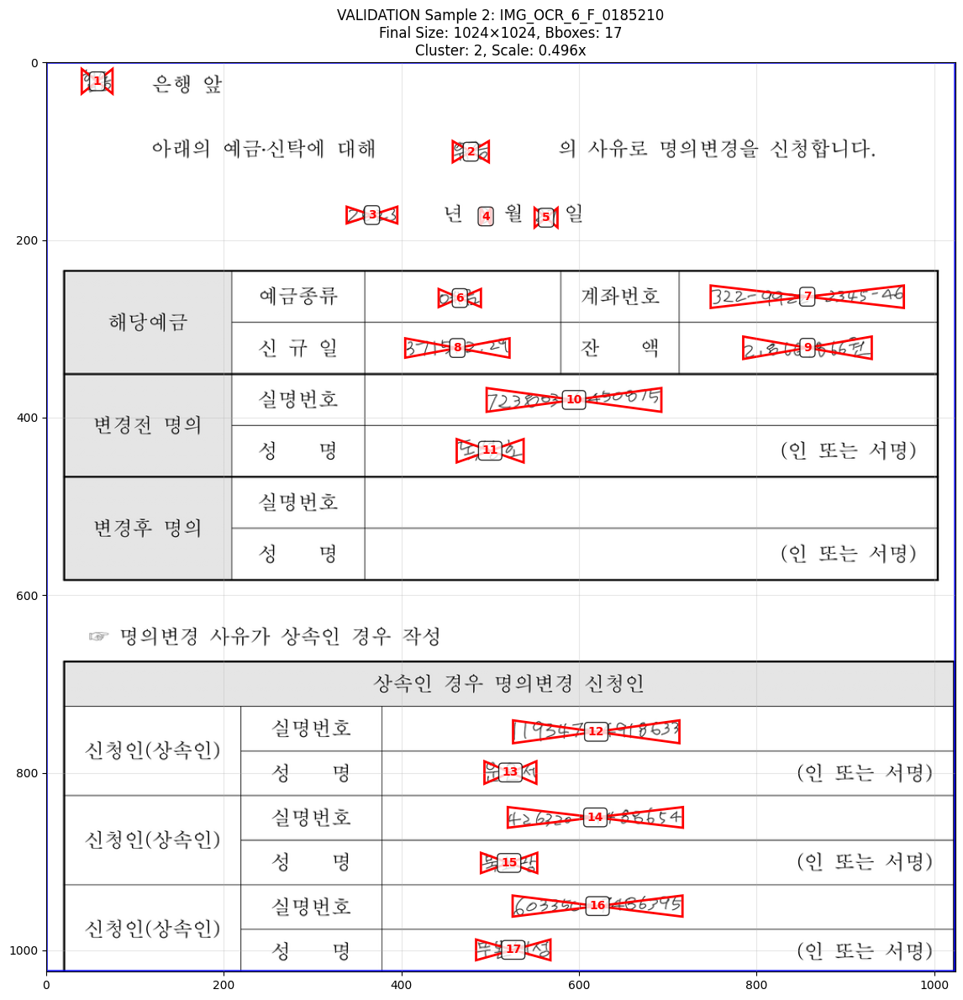

In [13]:
# Adjust bounding box coordinates to match cropped and standardized images (1024x1024)
import pandas as pd
import numpy as np
from copy import deepcopy

def adjust_bbox_coordinates_for_cropping_and_resize(df_y, cluster_cropped_images, dataset_results, dataset_type='train'):
    # Create a copy to avoid modifying original
    df_y_adjusted = df_y.copy()
    
    # Get image to cluster mapping
    image_to_cluster = {}
    for cluster_id, (df_cluster, images, max_ids) in dataset_results.items():
        for _, row in df_cluster.iterrows():
            identifier = row['Images.identifier']
            image_to_cluster[identifier] = cluster_id
    
    print(f"Found {len(image_to_cluster)} image-to-cluster mappings")
    
    adjusted_count = 0
    skipped_count = 0
    target_size = 1024  # Final standardized size
    
    # Process each row in the DataFrame
    for idx, row in df_y_adjusted.iterrows():
        identifier = row['Images.identifier']
        
        # Find which cluster this image belongs to
        if identifier not in image_to_cluster:
            print(f"Warning: No cluster mapping found for {identifier}")
            skipped_count += 1
            continue
        
        cluster_id = image_to_cluster[identifier]
        
        # Get cropping parameters for this cluster
        if cluster_id not in cluster_cropped_images:
            print(f"Warning: No cropping data found for cluster {cluster_id}")
            skipped_count += 1
            continue
        
        crop_data = cluster_cropped_images[cluster_id]
        crop_box = crop_data['crop_box']
        original_crop_size = crop_box['size']
        
        # Calculate the scaling factor from crop to final 1024x1024
        resize_scale_factor = target_size / original_crop_size
        
        # Get original bounding boxes
        bbox_list = row['bbox']
        if bbox_list is None or len(bbox_list) == 0:
            skipped_count += 1
            continue
        
        # Convert bbox to DataFrame for easier manipulation
        bbox_df = pd.DataFrame(bbox_list)
        adjusted_bbox_list = []
        
        # Adjust each bounding box
        for _, bbox_row in bbox_df.iterrows():
            original_x_coords = bbox_row['x']
            original_y_coords = bbox_row['y']
            bbox_id = bbox_row['id']
            
            # STEP 1: Adjust coordinates by subtracting crop offset
            cropped_x_coords = [x - crop_box['x'] for x in original_x_coords]
            cropped_y_coords = [y - crop_box['y'] for y in original_y_coords]
            
            # STEP 2: Clamp coordinates to be within the cropped image bounds
            cropped_x_coords = [max(0, min(original_crop_size-1, x)) for x in cropped_x_coords]
            cropped_y_coords = [max(0, min(original_crop_size-1, y)) for y in cropped_y_coords]
            
            # STEP 3: Scale coordinates to match the final 1024x1024 size
            final_x_coords = [x * resize_scale_factor for x in cropped_x_coords]
            final_y_coords = [y * resize_scale_factor for y in cropped_y_coords]
            
            # STEP 4: Ensure final coordinates are within 1024x1024 bounds
            final_x_coords = [max(0, min(target_size-1, x)) for x in final_x_coords]
            final_y_coords = [max(0, min(target_size-1, y)) for y in final_y_coords]
            
            # Create adjusted bbox entry
            adjusted_bbox = {
                'x': final_x_coords,
                'y': final_y_coords,
                'id': bbox_id
            }
            adjusted_bbox_list.append(adjusted_bbox)
        
        # Update the DataFrame with adjusted coordinates
        df_y_adjusted.at[idx, 'bbox'] = adjusted_bbox_list
        adjusted_count += 1
        
        if adjusted_count % 100 == 0:
            print(f"  Processed {adjusted_count} images (scale factor: {resize_scale_factor:.3f})...")
    
    print(f"\nAdjustment Summary:")
    print(f"  Successfully adjusted: {adjusted_count} images")
    print(f"  Skipped: {skipped_count} images")
    print(f"  Total: {len(df_y_adjusted)} images")
    print(f"  Final coordinate space: {target_size}×{target_size}")
    
    return df_y_adjusted

# Adjust training set coordinates
if len(df_y_train) > 0 and len(train_cluster_results) > 0:
    df_y_train_adjusted = adjust_bbox_coordinates_for_cropping_and_resize(
        df_y_train, 
        cluster_cropped_images, 
        train_cluster_results, 
        'train'
    )
    # Replace the original DataFrame
    df_y_train = df_y_train_adjusted
    print("Training set coordinates adjusted successfully!")
else:
    print("No training data to adjust")

# Adjust validation set coordinates
if len(df_y_val) > 0 and len(val_cluster_results) > 0:
    df_y_val_adjusted = adjust_bbox_coordinates_for_cropping_and_resize(
        df_y_val, 
        cluster_cropped_images, 
        val_cluster_results, 
        'val'
    )
    # Replace the original DataFrame
    df_y_val = df_y_val_adjusted
    print("Validation set coordinates adjusted successfully!")
else:
    print("No validation data to adjust")

def verify_coordinate_consistency_with_transformation_info(li_X, df_y, dataset_name, cluster_cropped_images, dataset_results, num_samples=3):

    import matplotlib.pyplot as plt
    import matplotlib.patches as patches
    from matplotlib.patches import Polygon
    
    # Get image to cluster mapping
    image_to_cluster = {}
    for cluster_id, (df_cluster, images, max_ids) in dataset_results.items():
        for _, row in df_cluster.iterrows():
            identifier = row['Images.identifier']
            image_to_cluster[identifier] = cluster_id
    
    sample_indices = np.random.choice(len(li_X), min(num_samples, len(li_X)), replace=False)
    
    for i, idx in enumerate(sample_indices):
        print(f"\nSample {i+1}/{num_samples} (Index: {idx})")
        
        # Get image and bbox data
        img = li_X[idx]
        row = df_y.iloc[idx]
        identifier = row['Images.identifier']
        bbox_list = row['bbox']
        
        if isinstance(img, Image.Image):
            img_array = np.array(img)
        else:
            img_array = img
        
        # Get transformation information
        cluster_id = image_to_cluster.get(identifier, None)
        if cluster_id and cluster_id in cluster_cropped_images:
            crop_data = cluster_cropped_images[cluster_id]
            crop_box = crop_data['crop_box']
            original_crop_size = crop_box['size']
            resize_scale_factor = 1024 / original_crop_size
            
            print(f"  Image ID: {identifier}")
            print(f"  Cluster: {cluster_id}")
            print(f"  Image shape: {img_array.shape} (should be 1024×1024)")
            print(f"  Crop offset: ({crop_box['x']}, {crop_box['y']})")
            print(f"  Original crop size: {original_crop_size}×{original_crop_size}")
            print(f"  Resize scale factor: {resize_scale_factor:.3f}")
            print(f"  Number of bboxes: {len(bbox_list) if bbox_list else 0}")
        else:
            print(f"  Image ID: {identifier}")
            print(f"  No cluster mapping found!")
            print(f"  Image shape: {img_array.shape}")
            print(f"  Number of bboxes: {len(bbox_list) if bbox_list else 0}")
        
        # Create visualization
        fig, ax = plt.subplots(1, 1, figsize=(12, 12))
        ax.imshow(img_array, cmap='gray')
        
        title = f'{dataset_name} Sample {i+1}: {identifier}\n'
        title += f'Final Size: {img_array.shape[1]}×{img_array.shape[0]}, Bboxes: {len(bbox_list) if bbox_list else 0}'
        if cluster_id and cluster_id in cluster_cropped_images:
            title += f'\nCluster: {cluster_id}, Scale: {resize_scale_factor:.3f}x'
        ax.set_title(title, fontsize=12)
        
        # Draw bounding boxes
        bbox_stats = []
        if bbox_list and len(bbox_list) > 0:
            bbox_df = pd.DataFrame(bbox_list)
            for _, bbox_row in bbox_df.iterrows():
                x_coords = bbox_row['x']
                y_coords = bbox_row['y']
                bbox_id = bbox_row['id']
                
                # Create polygon from coordinates
                points = list(zip(x_coords, y_coords))
                polygon = Polygon(points, fill=False, edgecolor='red', linewidth=2)
                ax.add_patch(polygon)
                
                # Add ID label at center
                center_x = np.mean(x_coords)
                center_y = np.mean(y_coords)
                ax.text(center_x, center_y, str(bbox_id), 
                       color='red', fontweight='bold', ha='center', va='center',
                       bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))
                
                # Check bounds and collect stats
                x_min, x_max = min(x_coords), max(x_coords)
                y_min, y_max = min(y_coords), max(y_coords)
                width = x_max - x_min
                height = y_max - y_min
                
                bbox_stats.append({
                    'id': bbox_id,
                    'x_range': (x_min, x_max),
                    'y_range': (y_min, y_max),
                    'width': width,
                    'height': height,
                    'in_bounds': (0 <= x_min < 1024 and 0 <= x_max < 1024 and 
                                0 <= y_min < 1024 and 0 <= y_max < 1024)
                })
                print(f"    BBox {bbox_id}: ({x_min:.1f}-{x_max:.1f}, {y_min:.1f}-{y_max:.1f}) size: {width:.1f}×{height:.1f}")
        
        # Add coordinate grid for reference
        ax.set_xlim(0, 1024)
        ax.set_ylim(1024, 0)  # Invert y-axis for image coordinates
        ax.grid(True, alpha=0.3)
        
        # Add border to show 1024x1024 boundary
        border = patches.Rectangle((0, 0), 1023, 1023, linewidth=2, 
                                 edgecolor='blue', facecolor='none', alpha=0.8)
        ax.add_patch(border)
        
        plt.tight_layout()
        plt.show()
        
        if i < num_samples - 1:
            input("Press Enter to continue to next sample...")

if len(li_X_train) > 0 and len(df_y_train) > 0:
    verify_coordinate_consistency_with_transformation_info(
        li_X_train, df_y_train, "TRAINING", 
        cluster_cropped_images, train_cluster_results, num_samples=2
    )

if len(li_X_val) > 0 and len(df_y_val) > 0:
    verify_coordinate_consistency_with_transformation_info(
        li_X_val, df_y_val, "VALIDATION", 
        cluster_cropped_images, val_cluster_results, num_samples=2
    )

In [14]:
# Convert images in li_X_train and li_X_val to numpy arrays

ar_X_train = []
ar_X_val = []
count = 0
for im in li_X_train:
    ar_X_train.append(np.array(im))
    count += 1
    if count % 1000 == 0:
        print(f"Converted {count} training images")

count = 0
for im in li_X_val:
    ar_X_val.append(np.array(im))
    count += 1
    if count % 1000 == 0:
        print(f"Converted {count} validation images")


Converted 1000 training images
Converted 2000 training images
Converted 3000 training images
Converted 4000 training images
Converted 5000 training images


In [16]:
# Define CRAFT Dataset class

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import cv2
from collections import OrderedDict

# Define GT Dataset
class CRAFTDataset(Dataset):
    def __init__(self, images, annotations_df, target_size, transform=None):
        self.images = images
        self.annotations_df = annotations_df
        self.target_size = target_size
        self.transform = transform
        
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        img = self.images[idx]
        if isinstance(img, np.ndarray):
            img = Image.fromarray(img)
        
        bbox_data = pd.DataFrame(self.annotations_df.iloc[idx]['bbox'])
        
        img_array = np.array(img)
        original_h, original_w = img_array.shape
        
        # Images are already at target size, no need to resize again
        img_resized = img_array
        
        # Calculate scaling factors (should be 1.0 since images are pre-scaled)
        scale_x = self.target_size[0] / original_w
        scale_y = self.target_size[1] / original_h
        
        # Generate ground truth maps
        region_map, affinity_map = self.generate_ground_truth(
            bbox_data, self.target_size, scale_x, scale_y
        )
        
        # Convert to tensors
        img_tensor = torch.FloatTensor(img_resized).unsqueeze(0) / 255.0  # Normalize to [0,1]
        region_tensor = torch.FloatTensor(region_map).unsqueeze(0)
        affinity_tensor = torch.FloatTensor(affinity_map).unsqueeze(0)
        
        return img_tensor, region_tensor, affinity_tensor
    
    def generate_ground_truth(self, bbox_data, target_size, scale_x, scale_y):
        width, height = target_size[1], target_size[0]
        region_map = np.zeros((height, width), dtype=np.float32)
        affinity_map = np.zeros((height, width), dtype=np.float32)
        

        for _, row in bbox_data.iterrows():
            x_coords = row['x']
            y_coords = row['y']
            
            points = np.array([[x_coords[0], y_coords[0]],
                              [x_coords[1], y_coords[1]], 
                              [x_coords[2], y_coords[2]],
                              [x_coords[3], y_coords[3]]], dtype=np.float32)
            
            # Scale coordinates
            points[:, 0] *= scale_x
            points[:, 1] *= scale_y
            points = points.astype(np.int32)
            
            # Create character region mask
            char_mask = np.zeros((height, width), dtype=np.uint8)
            cv2.fillPoly(char_mask, [points], 1)
            
            # Apply Gaussian blur for soft region score
            char_mask_blur = cv2.GaussianBlur(char_mask.astype(np.float32), (7, 7), 0)
            region_map = np.maximum(region_map, char_mask_blur)
            
        # Generate affinity map (connections between characters)
        # For simplicity, we'll create affinity based on proximity
        for i in range(len(bbox_data)):
            for j in range(i + 1, len(bbox_data)):
                # Get coordinates for both boxes
                x1_coords = bbox_data.iloc[i]['x']
                y1_coords = bbox_data.iloc[i]['y']
                x2_coords = bbox_data.iloc[j]['x']
                y2_coords = bbox_data.iloc[j]['y']
                
                # Convert to points format and scale
                box1 = np.array([[x1_coords[0], y1_coords[0]],
                                [x1_coords[1], y1_coords[1]], 
                                [x1_coords[2], y1_coords[2]],
                                [x1_coords[3], y1_coords[3]]], dtype=np.float32)
                box2 = np.array([[x2_coords[0], y2_coords[0]],
                                [x2_coords[1], y2_coords[1]], 
                                [x2_coords[2], y2_coords[2]],
                                [x2_coords[3], y2_coords[3]]], dtype=np.float32)
                
                # Scale coordinates
                box1[:, 0] *= scale_x
                box1[:, 1] *= scale_y
                box2[:, 0] *= scale_x
                box2[:, 1] *= scale_y
                
                # Calculate centers
                center1 = np.mean(box1, axis=0).astype(np.int32)
                center2 = np.mean(box2, axis=0).astype(np.int32)
                
                # Check if centers are within image bounds
                if (0 <= center1[0] < width and 0 <= center1[1] < height and
                    0 <= center2[0] < width and 0 <= center2[1] < height):
                    
                    # Calculate distance
                    distance = np.linalg.norm(center1 - center2)
                    
                    # Create affinity if characters are close enough
                    if distance < 100:  # Threshold for character proximity
                        # Draw line between centers
                        cv2.line(affinity_map, tuple(center1), tuple(center2), 1.0, 3)
        
        # Apply Gaussian blur to affinity map
        if np.any(affinity_map > 0):
            affinity_map = cv2.GaussianBlur(affinity_map, (7, 7), 0.1)
        
        return region_map, affinity_map

# Create transforms
transform = transforms.Compose([
    transforms.ToTensor(),
])

In [17]:
# Define the CRAFT model

class VGG16_BN(nn.Module):
    def __init__(self):
        super(VGG16_BN, self).__init__()
        
        # Block 1
        self.conv1_1 = nn.Conv2d(1, 64, kernel_size=3, padding=1)  # Changed input to 1 for grayscale
        self.bn1_1 = nn.BatchNorm2d(64)
        self.conv1_2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn1_2 = nn.BatchNorm2d(64)
        
        # Block 2
        self.conv2_1 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.bn2_1 = nn.BatchNorm2d(128)
        self.conv2_2 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn2_2 = nn.BatchNorm2d(128)
        
        # Block 3
        self.conv3_1 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.bn3_1 = nn.BatchNorm2d(256)
        self.conv3_2 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn3_2 = nn.BatchNorm2d(256)
        self.conv3_3 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn3_3 = nn.BatchNorm2d(256)
        
        # Block 4
        self.conv4_1 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.bn4_1 = nn.BatchNorm2d(512)
        self.conv4_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn4_2 = nn.BatchNorm2d(512)
        self.conv4_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn4_3 = nn.BatchNorm2d(512)
        
        # Block 5
        self.conv5_1 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn5_1 = nn.BatchNorm2d(512)
        self.conv5_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn5_2 = nn.BatchNorm2d(512)
        self.conv5_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn5_3 = nn.BatchNorm2d(512)
        
    def forward(self, x):
        sources = []
        
        # Block 1
        x = F.relu(self.bn1_1(self.conv1_1(x)))
        x = F.relu(self.bn1_2(self.conv1_2(x)))
        x = F.max_pool2d(x, 2, 2)
        
        # Block 2
        x = F.relu(self.bn2_1(self.conv2_1(x)))
        x = F.relu(self.bn2_2(self.conv2_2(x)))
        x = F.max_pool2d(x, 2, 2)
        sources.append(x)  # /4
        
        # Block 3
        x = F.relu(self.bn3_1(self.conv3_1(x)))
        x = F.relu(self.bn3_2(self.conv3_2(x)))
        x = F.relu(self.bn3_3(self.conv3_3(x)))
        x = F.max_pool2d(x, 2, 2)
        sources.append(x)  # /8
        
        # Block 4
        x = F.relu(self.bn4_1(self.conv4_1(x)))
        x = F.relu(self.bn4_2(self.conv4_2(x)))
        x = F.relu(self.bn4_3(self.conv4_3(x)))
        x = F.max_pool2d(x, 2, 2)
        sources.append(x)  # /16
        
        # Block 5
        x = F.relu(self.bn5_1(self.conv5_1(x)))
        x = F.relu(self.bn5_2(self.conv5_2(x)))
        x = F.relu(self.bn5_3(self.conv5_3(x)))
        x = F.max_pool2d(x, 2, 2)
        sources.append(x)  # /32
        
        return sources

class UpsampleBlock(nn.Module):
    """Upsampling block for FPN-style decoder"""
    def __init__(self, in_channels, out_channels):
        super(UpsampleBlock, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.bn = nn.BatchNorm2d(out_channels)
        
    def forward(self, x):
        x = F.interpolate(x, scale_factor=2, mode='bilinear', align_corners=False)
        x = F.relu(self.bn(self.conv(x)))
        return x

class CRAFT(nn.Module):
    """CRAFT: Character Region Awareness for Text Detection"""
    def __init__(self):
        super(CRAFT, self).__init__()
        
        # Backbone
        self.backbone = VGG16_BN()
        
        # Feature Pyramid Network (FPN) style decoder
        # Reduce channels first
        self.reduce_conv5 = nn.Conv2d(512, 256, kernel_size=1)
        self.reduce_conv4 = nn.Conv2d(512, 256, kernel_size=1)
        self.reduce_conv3 = nn.Conv2d(256, 128, kernel_size=1)
        self.reduce_conv2 = nn.Conv2d(128, 64, kernel_size=1)
        
        # Upsampling blocks
        self.up_conv4 = UpsampleBlock(256, 256)
        self.up_conv3 = UpsampleBlock(256, 128)
        self.up_conv2 = UpsampleBlock(128, 64)
        self.up_conv1 = UpsampleBlock(64, 32)
        
        # Final prediction layers
        self.final_conv = nn.Conv2d(32, 32, kernel_size=3, padding=1)
        self.region_score = nn.Conv2d(32, 1, kernel_size=1)  # Character region score
        self.affinity_score = nn.Conv2d(32, 1, kernel_size=1)  # Character affinity score
        
    def forward(self, x):
        # Get multi-scale features from backbone
        sources = self.backbone(x)  # [/4, /8, /16, /32]
        
        # Reduce channels
        f5 = self.reduce_conv5(sources[3])  # /32
        f4 = self.reduce_conv4(sources[2])  # /16
        f3 = self.reduce_conv3(sources[1])  # /8
        f2 = self.reduce_conv2(sources[0])  # /4
        
        # FPN-style upsampling and fusion
        # /32 -> /16
        up4 = self.up_conv4(f5)
        up4 = up4 + f4
        
        # /16 -> /8
        up3 = self.up_conv3(up4)
        up3 = up3 + f3
        
        # /8 -> /4
        up2 = self.up_conv2(up3)
        up2 = up2 + f2
        
        # /4 -> /2
        up1 = self.up_conv1(up2)
        
        # /2 -> /1 (full resolution)
        up0 = F.interpolate(up1, scale_factor=2, mode='bilinear', align_corners=False)
        
        # Final feature
        feature = F.relu(self.final_conv(up0))
        
        # Predictions
        region_score = torch.sigmoid(self.region_score(feature))
        affinity_score = torch.sigmoid(self.affinity_score(feature))
        
        return region_score, affinity_score

In [18]:
# Define loss function for CRAFT

class CRAFTLoss(nn.Module):
    def __init__(self, region_weight=1.0, affinity_weight=1.0):
        super(CRAFTLoss, self).__init__()
        self.region_weight = region_weight
        self.affinity_weight = affinity_weight
        self.mse_loss = nn.MSELoss()
        
    def forward(self, pred_region, pred_affinity, gt_region, gt_affinity):
        region_loss = self.mse_loss(pred_region, gt_region)
        
        affinity_loss = self.mse_loss(pred_affinity, gt_affinity)
        
        # Combined loss
        total_loss = (self.region_weight * region_loss + 
                     self.affinity_weight * affinity_loss)
        
        return total_loss, region_loss, affinity_loss

# Initialize model, dataset, and training components
device = torch.device("mps") if torch.backends.mps.is_available() else torch.device("cpu")
print(f"Using device: {device}")

# Create model
model = CRAFT().to(device)
print(f"Model created with {sum(p.numel() for p in model.parameters())} parameters")

# Create datasets
train_dataset = CRAFTDataset(ar_X_train, df_y_train, target_size)
val_dataset = CRAFTDataset(ar_X_val, df_y_val, target_size)

print(f"Train dataset: {len(train_dataset)} samples")
print(f"Validation dataset: {len(val_dataset)} samples")

# Create data loaders
batch_size = 4  # Adjust based on your GPU memory
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

# Loss function and optimizer
criterion = CRAFTLoss(region_weight=1.0, affinity_weight=0.1)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

Using device: mps
Model created with 16013442 parameters
Train dataset: 5743 samples
Validation dataset: 727 samples


In [19]:
# Define training loop with early stopping and vibration detection

def train_craft_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs=20,
                      patience=10, min_delta=1e-4, vibration_threshold=0.01, vibration_patience=5):

    train_losses = []
    val_losses = []
    best_val_loss = float('inf')
    epochs_without_improvement = 0
    vibration_count = 0
    last_direction = None
    
    for epoch in range(num_epochs):
        model.train()
        epoch_train_loss = 0.0
        epoch_region_loss = 0.0
        epoch_affinity_loss = 0.0
        
        for batch_idx, (images, gt_region, gt_affinity) in enumerate(train_loader):
            # Move to device
            images = images.to(device)
            gt_region = gt_region.to(device)
            gt_affinity = gt_affinity.to(device)
            
            # Forward pass
            pred_region, pred_affinity = model(images)
            
            # Calculate loss
            total_loss, region_loss, affinity_loss = criterion(
                pred_region, pred_affinity, gt_region, gt_affinity
            )
            
            # Backward pass
            optimizer.zero_grad()
            total_loss.backward()
            optimizer.step()
            
            # Accumulate losses
            epoch_train_loss += total_loss.item()
            epoch_region_loss += region_loss.item()
            epoch_affinity_loss += affinity_loss.item()
            
            # Print progress
            if batch_idx % 5 == 0:
                print(f"Epoch {epoch+1}/{num_epochs}, Batch {batch_idx+1}/{len(train_loader)}, "
                      f"Loss: {total_loss.item():.4f}")
        
        # Validation phase
        model.eval()
        epoch_val_loss = 0.0
        
        with torch.no_grad():
            for images, gt_region, gt_affinity in val_loader:
                images = images.to(device)
                gt_region = gt_region.to(device)
                gt_affinity = gt_affinity.to(device)
                
                pred_region, pred_affinity = model(images)
                total_loss, _, _ = criterion(pred_region, pred_affinity, gt_region, gt_affinity)
                
                epoch_val_loss += total_loss.item()
        
        # Calculate average losses
        avg_train_loss = epoch_train_loss / len(train_loader)
        avg_val_loss = epoch_val_loss / len(val_loader)
        avg_region_loss = epoch_region_loss / len(train_loader)
        avg_affinity_loss = epoch_affinity_loss / len(train_loader)
        
        train_losses.append(avg_train_loss)
        val_losses.append(avg_val_loss)
        
        # Early stopping logic
        improved = False
        if avg_val_loss < best_val_loss - min_delta:
            best_val_loss = avg_val_loss
            epochs_without_improvement = 0
            improved = True
            torch.save(model.state_dict(), 'best_craft_model_gen_cropped.pth')
            print(f"New best model saved! Val Loss: {best_val_loss:.4f}")
        else:
            epochs_without_improvement += 1
        
        # Vibrating loss detection
        if len(val_losses) >= 2:
            current_direction = "up" if val_losses[-1] > val_losses[-2] else "down"
            
            # Check for vibration: alternating up/down movements with significant changes
            if (len(val_losses) >= 3 and 
                last_direction is not None and 
                current_direction != last_direction):
                
                # Calculate relative change
                relative_change = abs(val_losses[-1] - val_losses[-2]) / val_losses[-2]
                
                if relative_change > vibration_threshold:
                    vibration_count += 1
                    print(f"Vibration detected. Count: {vibration_count}/{vibration_patience}")
                else:
                    vibration_count = 0
            else:
                vibration_count = 0
                
            last_direction = current_direction
        
        # Update learning rate
        scheduler.step()
        
        # Print epoch summary
        print(f"\nEpoch {epoch+1}/{num_epochs} Summary:")
        print(f"Train Loss: {avg_train_loss:.4f} (Region: {avg_region_loss:.4f}, Affinity: {avg_affinity_loss:.4f})")
        print(f"Val Loss: {avg_val_loss:.4f}")
        print(f"Learning Rate: {optimizer.param_groups[0]['lr']:.6f}")
        print(f"Epochs without improvement: {epochs_without_improvement}/{patience}")
        if vibration_count > 0:
            print(f"Vibration count: {vibration_count}/{vibration_patience}")
        print("-" * 60)
        
        # Check stopping conditions
        if epochs_without_improvement >= patience:
            print(f"\nEarly stopping triggered. No improvement for {patience} epochs.")
            print(f"Best validation loss: {best_val_loss:.4f}")
            break
            
        if vibration_count >= vibration_patience:
            print(f"\nEarly stopping triggered. Vibrating loss detected for {vibration_patience} consecutive times.")
            print(f"Training appears to be oscillating. Best validation loss: {best_val_loss:.4f}")
            break
    
    print("Training completed!")
    print(f"Best validation loss: {best_val_loss:.4f}")
    print(f"Total epochs trained: {len(train_losses)}")
    
    return train_losses, val_losses


In [27]:
# Run training with early stopping
num_epochs = 20  # Set higher since early stopping will handle it

train_losses, val_losses = train_craft_model(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    num_epochs=num_epochs,
    patience=2,           # Stop if no improvement for 2 epochs
    min_delta=1e-4,        # Minimum improvement threshold
    vibration_threshold=0.01,  # 1% relative change threshold for vibration detection
    vibration_patience=5   # Stop if vibrating for 5 consecutive times
)

# Plot training curves
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('CRAFT Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(train_losses, label='Train Loss')
plt.title('Training Loss (Log Scale)')
plt.xlabel('Epoch')
plt.ylabel('Loss (log scale)')
plt.yscale('log')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

print(f"Final training loss: {train_losses[-1]:.4f}")
print(f"Final validation loss: {val_losses[-1]:.4f}")

Epoch 1/20, Batch 1/1436, Loss: 0.2260
Epoch 1/20, Batch 6/1436, Loss: 0.1948
Epoch 1/20, Batch 11/1436, Loss: 0.1705
Epoch 1/20, Batch 16/1436, Loss: 0.1498
Epoch 1/20, Batch 21/1436, Loss: 0.1342
Epoch 1/20, Batch 26/1436, Loss: 0.1174
Epoch 1/20, Batch 31/1436, Loss: 0.1044
Epoch 1/20, Batch 36/1436, Loss: 0.0962
Epoch 1/20, Batch 41/1436, Loss: 0.0842
Epoch 1/20, Batch 46/1436, Loss: 0.0743
Epoch 1/20, Batch 51/1436, Loss: 0.0652
Epoch 1/20, Batch 56/1436, Loss: 0.0622
Epoch 1/20, Batch 61/1436, Loss: 0.0536
Epoch 1/20, Batch 66/1436, Loss: 0.0477
Epoch 1/20, Batch 71/1436, Loss: 0.0421
Epoch 1/20, Batch 76/1436, Loss: 0.0389
Epoch 1/20, Batch 81/1436, Loss: 0.0341
Epoch 1/20, Batch 86/1436, Loss: 0.0321
Epoch 1/20, Batch 91/1436, Loss: 0.0300
Epoch 1/20, Batch 96/1436, Loss: 0.0256
Epoch 1/20, Batch 101/1436, Loss: 0.0244
Epoch 1/20, Batch 106/1436, Loss: 0.0236
Epoch 1/20, Batch 111/1436, Loss: 0.0216
Epoch 1/20, Batch 116/1436, Loss: 0.0203
Epoch 1/20, Batch 121/1436, Loss: 0.01

KeyboardInterrupt: 

In [20]:
# Load the best trained model
best_model = CRAFT().to(device)
best_model.load_state_dict(torch.load('best_craft_model_gen_cropped.pth', map_location=device))
best_model.eval()

CRAFT(
  (backbone): VGG16_BN(
    (conv1_1): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1_1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1_2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2_1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2_2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn3_1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn3_

In [33]:
# Box extraction and saving function

def extract_and_save_predicted_boxes_old(model, dataset, device, output_folder="pred_craft_gen", 
                                   region_threshold=0.06, min_area=100, iou_threshold=0.5):

    import os
    from PIL import Image
    
    model.eval()
    
    # Create output folder
    os.makedirs(output_folder, exist_ok=True)
    
    print(f"Output folder: {output_folder}")
    print(f"Region threshold: {region_threshold}, Min area: {min_area}, IoU threshold: {iou_threshold}")
    print(f"Total images to process: {len(dataset)}")
    
    total_boxes_saved = 0
    
    for img_idx in range(len(dataset)):
        img_tensor, gt_region, gt_affinity = dataset[img_idx]
        img_batch = img_tensor.unsqueeze(0).to(device)
        
        with torch.no_grad():
            pred_region, pred_affinity = model(img_batch)
        
        img_np = img_tensor.squeeze(0).cpu().numpy()
        pred_region_np = pred_region.squeeze(0).squeeze(0).cpu().numpy()
        
        predicted_boxes = extract_boxes_from_region_map(pred_region_np, 
                                                       threshold=region_threshold, 
                                                       min_area=min_area)
        
        # Apply IoU-based non-maximum suppression if boxes are detected
        if len(predicted_boxes) > 1 and iou_threshold > 0:
            predicted_boxes = apply_iou_filtering(predicted_boxes, iou_threshold)
        
        # Get image identifier
        if hasattr(dataset, 'annotations_df'):
            img_identifier = dataset.annotations_df.iloc[img_idx]['Images.identifier']
        else:
            img_identifier = f"image_{img_idx:04d}"
        
        boxes_saved_this_image = 0
        
        # Save each predicted box as a separate image
        img_uint8 = (img_np * 255).astype(np.uint8)
        
        for box_idx, (x_coords, y_coords, confidence) in enumerate(predicted_boxes):
            # Calculate bounding box
            x_min = int(min(x_coords))
            x_max = int(max(x_coords))
            y_min = int(min(y_coords))
            y_max = int(max(y_coords))
            
            # Add small padding
            padding = 5
            x_min = max(0, x_min - padding)
            y_min = max(0, y_min - padding)
            x_max = min(img_uint8.shape[1], x_max + padding)
            y_max = min(img_uint8.shape[0], y_max + padding)
            
            # Crop the box region
            cropped_box = img_uint8[y_min:y_max, x_min:x_max]
            
            # Skip if cropped region is too small
            if cropped_box.shape[0] < 5 or cropped_box.shape[1] < 5:
                continue
            
            # Create filename with clear indexing
            filename = f"{img_identifier}_box_{box_idx:02d}_conf{confidence:.3f}.png"
            filepath = os.path.join(output_folder, filename)
            
            # Save as PIL Image
            pil_image = Image.fromarray(cropped_box, mode='L')
            pil_image.save(filepath)
            
            boxes_saved_this_image += 1
            total_boxes_saved += 1
        
        # Progress indication
        if img_idx % 10 == 0:
            print(f"Progress: {img_idx+1}/{len(dataset)} images processed, {total_boxes_saved} total boxes saved")
        
        print(f" - Saved {boxes_saved_this_image} boxes from image {img_idx}")
    

    print(f"Done!")
    print(f"Total images processed: {len(dataset)}")
    print(f"Total boxes saved: {total_boxes_saved}")
    print(f"All files saved in: {output_folder}")

    return total_boxes_saved

def apply_iou_filtering(boxes, iou_threshold):
    if len(boxes) <= 1:
        return boxes
    
    bbox_list = []
    for x_coords, y_coords, conf in boxes:
        x_min = min(x_coords)
        y_min = min(y_coords) 
        x_max = max(x_coords)
        y_max = max(y_coords)
        bbox_list.append([x_min, y_min, x_max, y_max, conf])
    
    bbox_list.sort(key=lambda x: x[4], reverse=True)
    
    keep_indices = []
    while bbox_list:
        # Keep the box with highest confidence
        current_box = bbox_list.pop(0)
        keep_indices.append(len(boxes) - len(bbox_list) - 1)  # Original index
        
        # Calculate IoU with remaining boxes and remove overlapping ones
        remaining_boxes = []
        for box in bbox_list:
            iou = calculate_bbox_iou(current_box[:4], box[:4])
            if iou < iou_threshold:
                remaining_boxes.append(box)
        
        bbox_list = remaining_boxes
    
    # Return filtered boxes in original format
    filtered_boxes = [boxes[i] for i in keep_indices if i < len(boxes)]
    return filtered_boxes

def calculate_bbox_iou(box1, box2):
    # Calculate intersection area
    x_left = max(box1[0], box2[0])
    y_top = max(box1[1], box2[1])
    x_right = min(box1[2], box2[2])
    y_bottom = min(box1[3], box2[3])
    
    if x_right < x_left or y_bottom < y_top:
        return 0.0
    
    intersection_area = (x_right - x_left) * (y_bottom - y_top)
    
    # Calculate union area
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])
    union_area = box1_area + box2_area - intersection_area
    
    if union_area == 0:
        return 0.0
    
    return intersection_area / union_area

print("Box extraction function 'extract_and_save_predicted_boxes_old' available.")

Box extraction function 'extract_and_save_predicted_boxes_old' available.


In [34]:
# Box extraction function with IoU-based NMS and spatial ordering
def calculate_iou(box1, box2):
    """
    Calculate Intersection over Union (IoU) of two bounding boxes
    box format: (x_coords, y_coords, confidence)
    """
    # Extract coordinates
    x1_coords, y1_coords, _ = box1
    x2_coords, y2_coords, _ = box2
    
    # Get bounding box coordinates
    x1_min, x1_max = min(x1_coords), max(x1_coords)
    y1_min, y1_max = min(y1_coords), max(y1_coords)
    x2_min, x2_max = min(x2_coords), max(x2_coords)
    y2_min, y2_max = min(y2_coords), max(y2_coords)
    
    # Calculate intersection area
    inter_x_min = max(x1_min, x2_min)
    inter_y_min = max(y1_min, y2_min)
    inter_x_max = min(x1_max, x2_max)
    inter_y_max = min(y1_max, y2_max)
    
    if inter_x_min >= inter_x_max or inter_y_min >= inter_y_max:
        return 0.0
    
    intersection = (inter_x_max - inter_x_min) * (inter_y_max - inter_y_min)
    
    # Calculate union area
    area1 = (x1_max - x1_min) * (y1_max - y1_min)
    area2 = (x2_max - x2_min) * (y2_max - y2_min)
    union = area1 + area2 - intersection
    
    if union <= 0:
        return 0.0
    
    return intersection / union

def non_maximum_suppression(boxes, iou_threshold=0.5):
    """
    Apply non-maximum suppression to remove overlapping boxes
    boxes: list of (x_coords, y_coords, confidence)
    iou_threshold: IoU threshold for suppression
    """
    if not boxes:
        return []
    
    # Sort boxes by confidence (descending)
    boxes = sorted(boxes, key=lambda x: x[2], reverse=True)
    
    keep = []
    while boxes:
        # Keep the box with highest confidence
        current = boxes.pop(0)
        keep.append(current)
        
        # Remove boxes with high IoU with current box
        remaining = []
        for box in boxes:
            if calculate_iou(current, box) < iou_threshold:
                remaining.append(box)
        boxes = remaining
    
    return keep

def sort_boxes_top_left_to_bottom_right(boxes):
    """
    Sort boxes from top-left to bottom-right using reading order
    boxes: list of (x_coords, y_coords, confidence)
    """
    if not boxes:
        return []
    
    def get_box_center(box):
        x_coords, y_coords, _ = box
        center_x = sum(x_coords) / len(x_coords)
        center_y = sum(y_coords) / len(y_coords)
        return center_x, center_y
    
    def get_box_top_left(box):
        x_coords, y_coords, _ = box
        top_left_x = min(x_coords)
        top_left_y = min(y_coords)
        return top_left_x, top_left_y
    
    # Sort by reading order: top to bottom, then left to right
    # Primary sort by y-coordinate (top to bottom)
    # Secondary sort by x-coordinate (left to right)
    sorted_boxes = sorted(boxes, key=lambda box: (get_box_top_left(box)[1], get_box_top_left(box)[0]))
    
    return sorted_boxes

def sort_boxes_line_by_line(boxes, line_height_threshold=30):
    """
    Sort boxes line by line, from top-left to bottom-right within each line
    boxes: list of (x_coords, y_coords, confidence)
    line_height_threshold: threshold to group boxes into lines
    """
    if not boxes:
        return []
    
    def get_box_center(box):
        x_coords, y_coords, _ = box
        center_x = sum(x_coords) / len(x_coords)
        center_y = sum(y_coords) / len(y_coords)
        return center_x, center_y
    
    def get_box_top_left(box):
        x_coords, y_coords, _ = box
        top_left_x = min(x_coords)
        top_left_y = min(y_coords)
        return top_left_x, top_left_y
    
    # First, sort all boxes by y-coordinate
    boxes_by_y = sorted(boxes, key=lambda box: get_box_top_left(box)[1])
    
    # Group boxes into lines
    lines = []
    current_line = []
    current_y = None
    
    for box in boxes_by_y:
        _, y = get_box_top_left(box)
        
        if current_y is None or abs(y - current_y) <= line_height_threshold:
            # Same line
            current_line.append(box)
            if current_y is None:
                current_y = y
        else:
            # New line
            if current_line:
                lines.append(current_line)
            current_line = [box]
            current_y = y
    
    # Add the last line
    if current_line:
        lines.append(current_line)
    
    # Sort each line by x-coordinate (left to right)
    sorted_boxes = []
    for line in lines:
        line_sorted = sorted(line, key=lambda box: get_box_top_left(box)[0])
        sorted_boxes.extend(line_sorted)
    
    return sorted_boxes

def sort_boxes_interval_based(boxes, interval_ratio=0.3):
    """
    Enhanced interval-based sorting algorithm that mimics natural reading order.
    
    Algorithm:
    1. Find the top-left box and label it as 1
    2. Define a y-interval centered at this box's y-center
    3. Find all boxes whose y-centers fall within this interval, sort them left-to-right
    4. Label remaining boxes with the next available numbers
    5. Repeat with the next top-left box among unlabeled boxes
    
    Args:
        boxes: List of (x_coords, y_coords, confidence) tuples
        interval_ratio: Ratio of box height to determine y-interval size (default: 0.3)
    
    Returns:
        List of boxes sorted in reading order
    """
    if not boxes:
        return []
    
    def get_box_center(box):
        x_coords, y_coords, _ = box
        return (np.mean(x_coords), np.mean(y_coords))
    
    def get_box_top_left(box):
        x_coords, y_coords, _ = box
        return (min(x_coords), min(y_coords))
    
    def get_box_height(box):
        _, y_coords, _ = box
        return max(y_coords) - min(y_coords)
    
    def calculate_y_interval(box, interval_ratio):
        """Calculate y-interval centered at box's y-center"""
        _, y_center = get_box_center(box)
        box_height = get_box_height(box)
        interval_half_height = box_height * interval_ratio
        return (y_center - interval_half_height, y_center + interval_half_height)
    
    def is_within_y_interval(box, y_interval):
        """Check if box's y-center is within the given y-interval"""
        _, y_center = get_box_center(box)
        return y_interval[0] <= y_center <= y_interval[1]
    
    # Copy boxes list to avoid modifying original
    remaining_boxes = boxes.copy()
    sorted_boxes = []
    
    print(f"🔢 Starting interval-based sorting with {len(boxes)} boxes")
    print(f"📏 Interval ratio: {interval_ratio}")
    
    iteration = 0
    while remaining_boxes:
        iteration += 1
        
        # Step 1: Find the top-left box among remaining boxes
        # First, find boxes with minimum y-coordinate
        min_y = min(get_box_top_left(box)[1] for box in remaining_boxes)
        top_boxes = [box for box in remaining_boxes if get_box_top_left(box)[1] == min_y]
        
        # Among top boxes, find the one with minimum x-coordinate
        current_box = min(top_boxes, key=lambda box: get_box_top_left(box)[0])
        
        # Step 2: Calculate y-interval for this box
        y_interval = calculate_y_interval(current_box, interval_ratio)
        
        # Step 3: Find all boxes within this y-interval
        boxes_in_interval = []
        for box in remaining_boxes:
            if is_within_y_interval(box, y_interval):
                boxes_in_interval.append(box)
        
        # Step 4: Sort boxes in this interval by x-coordinate (left to right)
        boxes_in_interval.sort(key=lambda box: get_box_top_left(box)[0])
        
        # Step 5: Add sorted boxes to result and remove from remaining
        sorted_boxes.extend(boxes_in_interval)
        for box in boxes_in_interval:
            remaining_boxes.remove(box)
        
        print(f"Iteration {iteration}: Found {len(boxes_in_interval)} boxes in y-interval "
              f"[{y_interval[0]:.1f}, {y_interval[1]:.1f}]")
        print(f"Remaining boxes: {len(remaining_boxes)}")

    print(f"Interval-based sorting complete: {len(sorted_boxes)} boxes ordered")
    return sorted_boxes

def extract_boxes_from_region_map(region_map, threshold=0.05, min_area=100):

    binary_map = (region_map > threshold).astype(np.uint8)
    # Find contours
    contours, _ = cv2.findContours(binary_map, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    boxes = []
    for contour in contours:
        # Skip small contours
        area = cv2.contourArea(contour)
        if area < min_area:
            continue
        
        # Get bounding rectangle
        x, y, w, h = cv2.boundingRect(contour)
        
        # Convert to 4-point format (clockwise from top-left)
        x_coords = [x, x + w, x + w, x]
        y_coords = [y, y, y + h, y + h]
        
        # Calculate average confidence score in this region
        mask = np.zeros_like(region_map, dtype=np.uint8)
        cv2.fillPoly(mask, [contour], 1)
        
        region_scores = region_map[mask == 1]
        avg_confidence = np.mean(region_scores) if len(region_scores) > 0 else 0.0
        
        boxes.append((x_coords, y_coords, avg_confidence))
    
    # Initially sort boxes by confidence score (descending) for NMS
    boxes.sort(key=lambda x: x[2], reverse=True)
    
    return boxes

def extract_and_save_predicted_boxes(model, dataset, device, output_folder="pred_craft_gen", 
                                   region_threshold=0.05, min_area=100, iou_threshold=0.5,
                                   spatial_ordering="interval_based", interval_ratio=0.3, 
                                   line_height_threshold=30):
    """
    Extract and save predicted text boxes from CRAFT model predictions
    
    Args:
        model: Trained CRAFT model
        dataset: Dataset to process
        device: Device to run inference on
        output_folder: Output directory for saved boxes
        region_threshold: Threshold for region map binarization
        min_area: Minimum area for detected boxes
        iou_threshold: IoU threshold for non-maximum suppression
        spatial_ordering: "interval_based" for advanced interval-based ordering, 
                         "top_left" for simple top-left ordering, 
                         "line_by_line" for line-aware ordering, 
                         "confidence" for confidence ordering
        interval_ratio: Ratio for calculating y-interval size (used with interval_based ordering)
        line_height_threshold: threshold for grouping boxes into lines (used with line_by_line ordering)
    """
    model.eval()
    os.makedirs(output_folder, exist_ok=True)
    
    print(f"Output folder: {output_folder}")
    print(f"Total images to process: {len(dataset)}")
    print(f"Region threshold: {region_threshold}")
    print(f"Minimum area: {min_area}")
    print(f"IoU threshold: {iou_threshold}")
    print(f"Spatial ordering: {spatial_ordering}")
    if spatial_ordering == "interval_based":
        print(f"Interval ratio: {interval_ratio}")
    elif spatial_ordering == "line_by_line":
        print(f"Line height threshold: {line_height_threshold}")
    
    total_boxes_saved = 0
    
    for img_idx in range(len(dataset)):
        # Get sample data
        img_tensor, gt_region, gt_affinity = dataset[img_idx]
        img_batch = img_tensor.unsqueeze(0).to(device)
        
        # Get model predictions
        with torch.no_grad():
            pred_region, pred_affinity = model(img_batch)
        
        # Convert to numpy
        img_np = img_tensor.squeeze(0).cpu().numpy()
        pred_region_np = pred_region.squeeze(0).squeeze(0).cpu().numpy()
        
        # Extract boxes
        predicted_boxes = extract_boxes_from_region_map(pred_region_np, 
                                                       threshold=region_threshold, 
                                                       min_area=min_area)
        
        # Apply non-maximum suppression
        if iou_threshold > 0 and iou_threshold < 1.0:
            predicted_boxes = non_maximum_suppression(predicted_boxes, iou_threshold)
        
        # Apply spatial ordering
        if spatial_ordering == "interval_based":
            predicted_boxes = sort_boxes_interval_based(predicted_boxes, interval_ratio)
        elif spatial_ordering == "top_left":
            predicted_boxes = sort_boxes_top_left_to_bottom_right(predicted_boxes)
        elif spatial_ordering == "line_by_line":
            predicted_boxes = sort_boxes_line_by_line(predicted_boxes, line_height_threshold)
        elif spatial_ordering == "confidence":
            # Keep confidence-based ordering (already sorted in extract_boxes_from_region_map)
            predicted_boxes = sorted(predicted_boxes, key=lambda x: x[2], reverse=True)
        
        # Get image identifier
        if hasattr(dataset, 'annotations_df'):
            img_identifier = dataset.annotations_df.iloc[img_idx]['Images.identifier']
        else:
            img_identifier = f"image_{img_idx:04d}"
        
        boxes_saved_this_image = 0
        
        # Save each predicted box as a separate image
        img_uint8 = (img_np * 255).astype(np.uint8)
        
        for box_idx, (x_coords, y_coords, confidence) in enumerate(predicted_boxes):
            # Calculate bounding box
            x_min = int(min(x_coords))
            x_max = int(max(x_coords))
            y_min = int(min(y_coords))
            y_max = int(max(y_coords))
            
            # Add small padding
            padding = 5
            x_min = max(0, x_min - padding)
            y_min = max(0, y_min - padding)
            x_max = min(img_uint8.shape[1], x_max + padding)
            y_max = min(img_uint8.shape[0], y_max + padding)
            
            # Crop the box region
            cropped_box = img_uint8[y_min:y_max, x_min:x_max]
            
            # Skip if cropped region is too small
            if cropped_box.shape[0] < 5 or cropped_box.shape[1] < 5:
                continue
            
            # Create filename with clear indexing (now reflects spatial order)
            filename = f"{img_identifier}_box_{box_idx:02d}_conf{confidence:.3f}.png"
            filepath = os.path.join(output_folder, filename)
            
            # Save as PIL Image
            pil_image = Image.fromarray(cropped_box, mode='L')
            pil_image.save(filepath)
            
            boxes_saved_this_image += 1
            total_boxes_saved += 1
        
        print(f"Saved {boxes_saved_this_image} boxes from image {img_idx} ({spatial_ordering} ordering)")
        
        # Show progress every 10 images
        if (img_idx + 1) % 10 == 0 or (img_idx + 1) == len(dataset):
            print(f"Progress: {img_idx + 1}/{len(dataset)} images processed.")
    
    print(f"Total boxes saved: {total_boxes_saved}")
    return total_boxes_saved

print("Box extraction function 'extract_and_save_predicted_boxes' with IoU-based NMS and spatial ordering ready")

Box extraction function 'extract_and_save_predicted_boxes' with IoU-based NMS and spatial ordering ready


In [22]:
# Visualization function

import random
import matplotlib.patches as patches
from matplotlib.patches import Polygon
import cv2

def visualize_craft_predictions(model, dataset, device, sample_idx=None):
    if sample_idx is None:
        sample_idx = random.randint(0, len(dataset) - 1)
    
    print(f"Visualizing sample {sample_idx}")
    
    img_tensor, gt_region, gt_affinity = dataset[sample_idx]
    img_batch = img_tensor.unsqueeze(0).to(device)
    
    model.eval()
    with torch.no_grad():
        pred_region, pred_affinity = model(img_batch)

    img_np = img_tensor.squeeze(0).cpu().numpy()
    gt_region_np = gt_region.squeeze(0).cpu().numpy()
    gt_affinity_np = gt_affinity.squeeze(0).cpu().numpy()
    pred_region_np = pred_region.squeeze(0).squeeze(0).cpu().numpy()
    pred_affinity_np = pred_affinity.squeeze(0).squeeze(0).cpu().numpy()
    
    bbox_data = pd.DataFrame(dataset.annotations_df.iloc[sample_idx]['bbox'])
    
    original_img = dataset.images[sample_idx]
    if isinstance(original_img, np.ndarray):
        original_img = Image.fromarray(original_img)
    original_h, original_w = np.array(original_img).shape
    scale_x = dataset.target_size[0] / original_w
    scale_y = dataset.target_size[1] / original_h
    
    # Create figure with subplots
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    
    # 1. Original image with GT boxes
    axes[0, 0].imshow(img_np, cmap='gray')
    axes[0, 0].set_title('Original Image + GT Boxes', fontsize=12, fontweight='bold')
    
    # Draw GT boxes
    for _, row in bbox_data.iterrows():
        x_coords = np.array(row['x']) * scale_x
        y_coords = np.array(row['y']) * scale_y
        
        # Create polygon for the box
        points = list(zip(x_coords, y_coords))
        polygon = Polygon(points, fill=False, edgecolor='red', linewidth=2)
        axes[0, 0].add_patch(polygon)
        
        # Add ID label
        center_x = np.mean(x_coords)
        center_y = np.mean(y_coords)
        axes[0, 0].text(center_x, center_y, str(row['id']), 
                       color='red', fontweight='bold', ha='center', va='center',
                       bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))
    
    axes[0, 0].axis('off')
    
    # 2. GT Region Score Heatmap
    im1 = axes[0, 1].imshow(gt_region_np, cmap='hot', alpha=0.8)
    axes[0, 1].imshow(img_np, cmap='gray', alpha=0.3)
    axes[0, 1].set_title('GT Region Score Heatmap', fontsize=12, fontweight='bold')
    axes[0, 1].axis('off')
    plt.colorbar(im1, ax=axes[0, 1], fraction=0.046, pad=0.04)
    
    # 3. GT Affinity Score Heatmap  
    im2 = axes[0, 2].imshow(gt_affinity_np, cmap='cool', alpha=0.8)
    axes[0, 2].imshow(img_np, cmap='gray', alpha=0.3)
    axes[0, 2].set_title('GT Affinity Score Heatmap', fontsize=12, fontweight='bold')
    axes[0, 2].axis('off')
    plt.colorbar(im2, ax=axes[0, 2], fraction=0.046, pad=0.04)
    
    # 4. Image with Predicted Boxes (from region heatmap)
    axes[1, 0].imshow(img_np, cmap='gray')
    axes[1, 0].set_title('Image + Predicted Boxes', fontsize=12, fontweight='bold')
    
    # Extract boxes from predicted region map
    pred_boxes = extract_boxes_from_heatmap(pred_region_np, threshold=0.3)
    
    # Draw predicted boxes
    for i, box in enumerate(pred_boxes):
        x_coords, y_coords = box
        points = list(zip(x_coords, y_coords))
        polygon = Polygon(points, fill=False, edgecolor='blue', linewidth=2)
        axes[1, 0].add_patch(polygon)
        
        # Add prediction label
        center_x = np.mean(x_coords)
        center_y = np.mean(y_coords)
        axes[1, 0].text(center_x, center_y, f'P{i+1}', 
                       color='blue', fontweight='bold', ha='center', va='center',
                       bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))
    
    axes[1, 0].axis('off')
    
    # 5. Predicted Region Score Heatmap
    im3 = axes[1, 1].imshow(pred_region_np, cmap='hot', alpha=0.8)
    axes[1, 1].imshow(img_np, cmap='gray', alpha=0.3)
    axes[1, 1].set_title('Predicted Region Score Heatmap', fontsize=12, fontweight='bold')
    axes[1, 1].axis('off')
    plt.colorbar(im3, ax=axes[1, 1], fraction=0.046, pad=0.04)
    
    # 6. Predicted Affinity Score Heatmap
    im4 = axes[1, 2].imshow(pred_affinity_np, cmap='cool', alpha=0.8)
    axes[1, 2].imshow(img_np, cmap='gray', alpha=0.3)
    axes[1, 2].set_title('Predicted Affinity Score Heatmap', fontsize=12, fontweight='bold')
    axes[1, 2].axis('off')
    plt.colorbar(im4, ax=axes[1, 2], fraction=0.046, pad=0.04)
    
    plt.tight_layout()
    plt.show()

    return sample_idx

def extract_boxes_from_heatmap(region_map, threshold=0.05, min_area=100):

    # Threshold the heatmap
    binary_map = (region_map > threshold).astype(np.uint8)
    
    # Find contours
    contours, _ = cv2.findContours(binary_map, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    boxes = []
    for contour in contours:
        # Skip small contours
        if cv2.contourArea(contour) < min_area:
            continue
            
        # Get bounding rectangle
        x, y, w, h = cv2.boundingRect(contour)
        
        # Convert to 4-point format (clockwise from top-left)
        x_coords = [x, x + w, x + w, x]
        y_coords = [y, y, y + h, y + h]
        
        boxes.append((x_coords, y_coords))
    
    return boxes

print("Visualization functions ready")
print("visualize_craft_predictions(best_model, val_dataset, device)")

Visualization functions ready
visualize_craft_predictions(best_model, val_dataset, device)


Visualizing sample 654


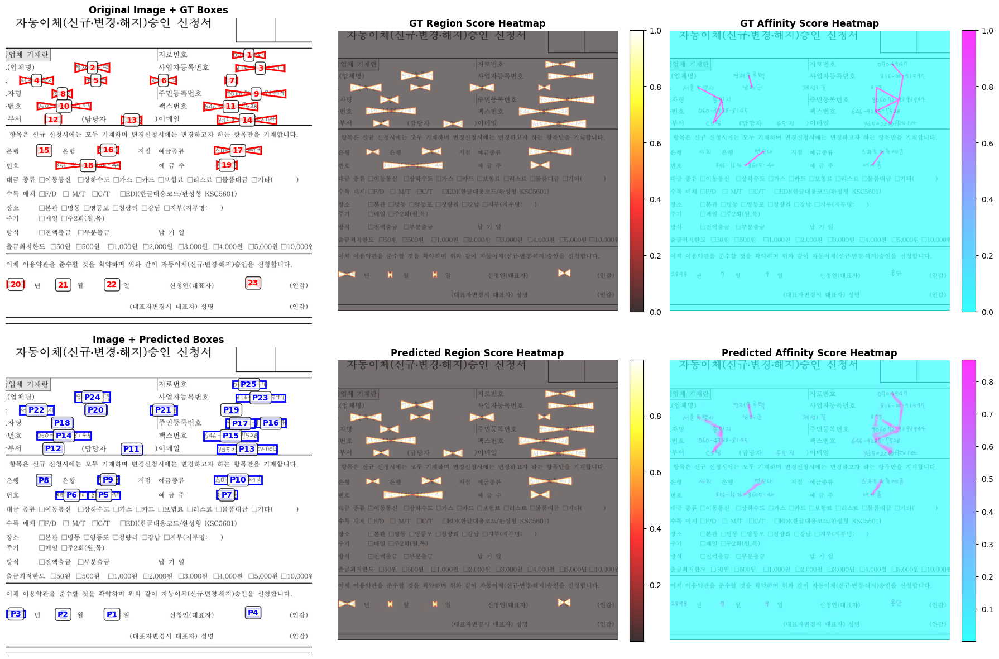

In [ ]:
# Visualize random sample from validation set, spatial ordering and IOU-based NMS not applied

sample_idx = visualize_craft_predictions(best_model, val_dataset, device)

In [24]:
# Model Evaluation function with IOU and F1-Score
import numpy as np
import cv2
from sklearn.metrics import precision_recall_fscore_support
import torch
import pandas as pd
from PIL import Image

def extract_boxes_from_region_map(region_map, threshold=0.06, min_area=100):

    # Threshold the heatmap
    binary_map = (region_map > threshold).astype(np.uint8)
    
    # Find contours
    contours, _ = cv2.findContours(binary_map, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    boxes = []
    for contour in contours:
        # Skip small contours
        if cv2.contourArea(contour) < min_area:
            continue
            
        # Get bounding rectangle
        x, y, w, h = cv2.boundingRect(contour)
        
        # Get confidence score as max value in the region
        mask = np.zeros_like(region_map, dtype=np.uint8)
        cv2.drawContours(mask, [contour], -1, 255, -1)
        confidence = np.max(region_map[mask == 255])
        
        # Convert to 4-point format (clockwise from top-left)
        x_coords = [x, x + w, x + w, x]
        y_coords = [y, y, y + h, y + h]
        
        boxes.append((x_coords, y_coords, confidence))
    
    return boxes

def calculate_box_iou(box1, box2):
    x_left = max(box1[0], box2[0])
    y_top = max(box1[1], box2[1])
    x_right = min(box1[2], box2[2])
    y_bottom = min(box1[3], box2[3])
    
    if x_right < x_left or y_bottom < y_top:
        return 0.0
    
    intersection_area = (x_right - x_left) * (y_bottom - y_top)
    
    # Calculate union area
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])
    union_area = box1_area + box2_area - intersection_area
    
    if union_area == 0:
        return 0.0
    
    return intersection_area / union_area

def convert_box_format(x_coords, y_coords):
    x_min = int(min(x_coords))
    y_min = int(min(y_coords))
    x_max = int(max(x_coords))
    y_max = int(max(y_coords))
    return (x_min, y_min, x_max, y_max)

def evaluate_model_with_iou_f1(model, dataset, device, iou_threshold=0.5, 
                                    region_threshold=0.06, min_area=100, sample_indices=None, verbose=True, present_results=False):
    
    model.eval()
    
    total_true_positives = 0
    total_false_positives = 0
    total_false_negatives = 0

    if verbose and sample_indices is None:
        print(f"Evaluating on {len(dataset)} samples with IoU threshold {iou_threshold} and Region threshold {region_threshold}")
    if verbose and sample_indices is not None:
        print(f"Evaluating on {len(sample_indices)} specified samples with IoU threshold {iou_threshold} and Region threshold {region_threshold}")
    # Use subset if specified, otherwise use full dataset
    if sample_indices is not None:
        indices_to_process = sample_indices
    else:
        indices_to_process = range(len(dataset))
    
    with torch.no_grad():
        for img_idx in indices_to_process:
            if verbose and (img_idx + 1) % 50 == 0:
                print(f"Processing: {img_idx + 1}/{len(dataset)} samples...")
            
            try:
                # Get sample data
                img_tensor, gt_region, gt_affinity = dataset[img_idx]
                img_batch = img_tensor.unsqueeze(0).to(device)
                
                # Get model predictions
                pred_region, pred_affinity = model(img_batch)
                pred_region_np = pred_region.squeeze(0).squeeze(0).cpu().numpy()
                
                # Extract predicted boxes
                pred_boxes = extract_boxes_from_region_map(pred_region_np, 
                                                         threshold=region_threshold, 
                                                         min_area=min_area)
                
                # Get ground truth boxes
                bbox_data = dataset.annotations_df.iloc[img_idx]['bbox']
                if not isinstance(bbox_data, pd.DataFrame):
                    bbox_data = pd.DataFrame(bbox_data)
                
                # Convert ground truth to bounding box format
                gt_boxes = []
                original_img = dataset.images[img_idx]
                if isinstance(original_img, np.ndarray):
                    from PIL import Image
                    original_img = Image.fromarray(original_img)
                
                original_h, original_w = np.array(original_img).shape[:2]
                scale_x = dataset.target_size[1] / original_w
                scale_y = dataset.target_size[0] / original_h
                
                for _, row in bbox_data.iterrows():
                    x_coords = np.array(row['x']) * scale_x
                    y_coords = np.array(row['y']) * scale_y
                    
                    x_min = int(min(x_coords))
                    y_min = int(min(y_coords))
                    x_max = int(max(x_coords))
                    y_max = int(max(y_coords))
                    
                    gt_boxes.append([x_min, y_min, x_max, y_max])
                
                # Convert predicted boxes to bounding box format
                pred_bboxes = []
                for x_coords, y_coords, confidence in pred_boxes:
                    x_min = int(min(x_coords))
                    y_min = int(min(y_coords))
                    x_max = int(max(x_coords))
                    y_max = int(max(y_coords))
                    pred_bboxes.append([x_min, y_min, x_max, y_max])
                
                # Match predicted boxes to ground truth using IoU
                matched_gt_indices = set()
                sample_tp = 0
                sample_fp = 0
                
                for pred_bbox in pred_bboxes:
                    best_iou = 0.0
                    best_gt_idx = -1
                    
                    for gt_idx, gt_bbox in enumerate(gt_boxes):
                        if gt_idx in matched_gt_indices:
                            continue
                        iou = calculate_box_iou(pred_bbox, gt_bbox)
                        if iou > best_iou:
                            best_iou = iou
                            best_gt_idx = gt_idx
                    
                    if best_iou >= iou_threshold:
                        sample_tp += 1
                        matched_gt_indices.add(best_gt_idx)
                    else:
                        sample_fp += 1
                
                sample_fn = len(gt_boxes) - len(matched_gt_indices)
                
                total_true_positives += sample_tp
                total_false_positives += sample_fp
                total_false_negatives += sample_fn
                
            except Exception as e:
                # Skip problematic samples
                continue
    
    # Calculate metrics
    precision = total_true_positives / (total_true_positives + total_false_positives) if (total_true_positives + total_false_positives) > 0 else 0.0
    recall = total_true_positives / (total_true_positives + total_false_negatives) if (total_true_positives + total_false_negatives) > 0 else 0.0
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0.0
    
    # Present results if requested
    if present_results:
        print("="*80)
        print(f"Dataset Size: {len(dataset)} samples")
        print(f"IoU Threshold: {iou_threshold}")
        print(f"Region Threshold: {region_threshold}")
        print(f"Min Area: {min_area}")
        print("-"*80)
        print("Detection Analysis:")
        print(f"True Positives:  {total_true_positives:>6}")
        print(f"False Positives: {total_false_positives:>6}")
        print(f"False Negatives: {total_false_negatives:>6}")
        print(f"Total Predictions: {total_true_positives + total_false_positives:>6}")
        print(f"Total Ground Truth: {total_true_positives + total_false_negatives:>6}")
        print("-"*80)
        print("Performance Metrics:")
        print(f"Precision: {precision:.4f} ({precision*100:.2f}%)")
        print(f"Recall:    {recall:.4f} ({recall*100:.2f}%)")
        print(f"F1-Score:  {f1_score:.4f} ({f1_score*100:.2f}%)")
        
    
    return {
        'precision': precision,
        'recall': recall,
        'f1_score': f1_score,
        'true_positives': total_true_positives,
        'false_positives': total_false_positives,
        'false_negatives': total_false_negatives
    }

print("\nFunctions available:")
print("• extract_boxes_from_region_map() - Extract boxes from heatmap")
print("• calculate_box_iou() - Calculate IoU between boxes") 
print("• evaluate_model_with_iou_f1() - Complete evaluation with metrics")


Functions available:
• extract_boxes_from_region_map() - Extract boxes from heatmap
• calculate_box_iou() - Calculate IoU between boxes
• evaluate_model_with_iou_f1() - Complete evaluation with metrics


In [28]:
# Run evaluation_model_with_fixed_iou_f1

validation_results = evaluate_model_with_iou_f1(
    model=best_model,
    dataset=val_dataset,
    device=device,
    iou_threshold=0.5,
    region_threshold=0.06,
    min_area=100,
    present_results=True
)

Evaluating on 727 samples with IoU threshold 0.5 and Region threshold 0.06
Processing: 50/727 samples...
Processing: 100/727 samples...
Processing: 150/727 samples...
Processing: 200/727 samples...
Processing: 250/727 samples...
Processing: 300/727 samples...
Processing: 350/727 samples...
Processing: 400/727 samples...
Processing: 450/727 samples...
Processing: 500/727 samples...
Processing: 550/727 samples...
Processing: 600/727 samples...
Processing: 650/727 samples...
Processing: 700/727 samples...
Dataset Size: 727 samples
IoU Threshold: 0.5
Region Threshold: 0.06
Min Area: 100
--------------------------------------------------------------------------------
Detection Analysis:
True Positives:   16641
False Positives:    392
False Negatives:    504
Total Predictions:  17033
Total Ground Truth:  17145
--------------------------------------------------------------------------------
Performance Metrics:
Precision: 0.9770 (97.70%)
Recall:    0.9706 (97.06%)
F1-Score:  0.9738 (97.38%)


In [32]:
# Defining function for Grid Search that finds Optimal Thresholds - Region and IoU
def grid_search_optimal_thresholds(model, dataset, device, sample_size=100, verbose=True):

    # Define parameter ranges
    region_thresholds = [0.05, 0.06, 0.07, 0.08, 0.09, 0.10]
    iou_thresholds = [0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4]
    
    total_combinations = len(region_thresholds) * len(iou_thresholds)
    
    print(f"Total combinations: {total_combinations}")
    
    # Create random subset for evaluation
    if sample_size < len(dataset):
        random.seed(42)  # For reproducibility
        sample_indices = random.sample(range(len(dataset)), sample_size)
        print(f"Creating random subset of {sample_size} samples from dataset of size {len(dataset)}")
    else:
        sample_indices = None
        print(f"Using full dataset of size {len(dataset)}")
    
    print("Starting grid search\n")
    
    # Store all results
    grid_search_results = []
    best_f1_score = 0.0
    best_params = {}
    
    combination_count = 0
    
    # Grid search
    for region_thresh in region_thresholds:
        for iou_thresh in iou_thresholds:
            combination_count += 1
            
            if verbose:
                print(f"Evaluating combination {combination_count}/{total_combinations}: "
                      f"Region Threshold={region_thresh}, IoU Threshold={iou_thresh}")
            
            # Evaluate with current parameters
            results = evaluate_model_with_iou_f1(
                model=model,
                dataset=dataset,
                device=device,
                iou_threshold=iou_thresh,
                region_threshold=region_thresh,
                min_area=100,
                sample_indices=sample_indices
            )
            
            # Store results
            result_entry = {
                'region_threshold': region_thresh,
                'iou_threshold': iou_thresh,
                'f1_score': results['f1_score'],
                'precision': results['precision'],
                'recall': results['recall'],
                'true_positives': results['true_positives'],
                'false_positives': results['false_positives'],
                'false_negatives': results['false_negatives']
            }
            grid_search_results.append(result_entry)
            
            # Print results
            if verbose:
                print(f"F1-Score: {results['f1_score']:.4f} "
                      f"(Precision: {results['precision']:.4f}, "
                      f"Recall: {results['recall']:.4f})\n")
            
            # Track best parameters
            if results['f1_score'] > best_f1_score:
                best_f1_score = results['f1_score']
                best_params = {
                    'region_threshold': region_thresh,
                    'iou_threshold': iou_thresh,
                    'f1_score': results['f1_score'],
                    'precision': results['precision'],
                    'recall': results['recall']
                }
    
    # Print final results
    print("Best prameters found:")
    print(f"Region Threshold: {best_params['region_threshold']:.3f}")
    print(f"IoU Threshold: {best_params['iou_threshold']:.2f}")
    print(f"Best F1-Score: {best_params['f1_score']:.4f} ({best_params['f1_score']*100:.2f}%)")
    print(f"Precision: {best_params['precision']:.4f} ({best_params['precision']*100:.2f}%)")
    print(f"Recall: {best_params['recall']:.4f} ({best_params['recall']*100:.2f}%)")
    
    return {
        'best_params': best_params,
        'all_results': grid_search_results,
        'sample_indices': sample_indices
    }

In [ ]:
# Perform grid search on validation dataset
grid_search_results = grid_search_optimal_thresholds(
    model=best_model,
    dataset=val_dataset,
    device=device,
    sample_size=50,  # Use subset for efficiency
    verbose=True
)

In [34]:
# Model evaluation with best parameters found
Best_results = evaluate_model_with_iou_f1(
    model=best_model,
    dataset=val_dataset,
    device=device,
    iou_threshold=0.1,
    region_threshold=0.09,
    min_area=100,
    verbose=True,
    present_results=True
)

Evaluating on 727 samples with IoU threshold 0.1 and Region threshold 0.09
Processing: 50/727 samples...
Processing: 100/727 samples...
Processing: 150/727 samples...
Processing: 200/727 samples...
Processing: 250/727 samples...
Processing: 300/727 samples...
Processing: 350/727 samples...
Processing: 400/727 samples...
Processing: 450/727 samples...
Processing: 500/727 samples...
Processing: 550/727 samples...
Processing: 600/727 samples...
Processing: 650/727 samples...
Processing: 700/727 samples...


In [27]:
# Enhanced Visualization Function with IoU and Region Thresholds

import random
import matplotlib.patches as patches
from matplotlib.patches import Polygon
import cv2

def visualize_craft_predictions_with_thresholds(model, dataset, device, sample_idx=None, 
                                              region_threshold=0.05, min_area=100, 
                                              iou_threshold=0.5, spatial_ordering="interval_based",
                                              interval_ratio=0.3):
    """
    Enhanced visualization function that shows CRAFT predictions with configurable thresholds
    
    Args:
        model: Trained CRAFT model
        dataset: Dataset to visualize from
        device: Device to run inference on
        sample_idx: Index of sample to visualize (None for random)
        region_threshold: Threshold for region map binarization
        min_area: Minimum area for detected boxes
        iou_threshold: IoU threshold for non-maximum suppression
        spatial_ordering: Spatial ordering method for boxes
        interval_ratio: Ratio for calculating y-interval size (used with interval_based ordering)
    """
    if sample_idx is None:
        sample_idx = random.randint(0, len(dataset) - 1)
    
    img_tensor, gt_region, gt_affinity = dataset[sample_idx]
    img_batch = img_tensor.unsqueeze(0).to(device)
    
    model.eval()
    with torch.no_grad():
        pred_region, pred_affinity = model(img_batch)

    img_np = img_tensor.squeeze(0).cpu().numpy()
    gt_region_np = gt_region.squeeze(0).cpu().numpy()
    gt_affinity_np = gt_affinity.squeeze(0).cpu().numpy()
    pred_region_np = pred_region.squeeze(0).squeeze(0).cpu().numpy()
    pred_affinity_np = pred_affinity.squeeze(0).squeeze(0).cpu().numpy()
    
    # Get GT boxes
    bbox_data = pd.DataFrame(dataset.annotations_df.iloc[sample_idx]['bbox'])
    
    # Scale coordinates
    original_img = dataset.images[sample_idx]
    if isinstance(original_img, np.ndarray):
        original_img = Image.fromarray(original_img)
    original_h, original_w = np.array(original_img).shape
    scale_x = dataset.target_size[0] / original_w
    scale_y = dataset.target_size[1] / original_h
    
    # Extract predicted boxes using our enhanced functions
    predicted_boxes = extract_boxes_from_region_map(pred_region_np, 
                                                   threshold=region_threshold, 
                                                   min_area=min_area)
    
    # Apply non-maximum suppression if IoU threshold is set
    if iou_threshold > 0 and iou_threshold < 1.0:
        predicted_boxes = non_maximum_suppression(predicted_boxes, iou_threshold)
    
    # Apply spatial ordering
    if spatial_ordering == "interval_based":
        predicted_boxes = sort_boxes_interval_based(predicted_boxes, interval_ratio)
    elif spatial_ordering == "top_left":
        predicted_boxes = sort_boxes_top_left_to_bottom_right(predicted_boxes)
    elif spatial_ordering == "line_by_line":
        predicted_boxes = sort_boxes_line_by_line(predicted_boxes, 30)
    elif spatial_ordering == "confidence":
        predicted_boxes = sorted(predicted_boxes, key=lambda x: x[2], reverse=True)
    
    # Create figure with subplots
    fig, axes = plt.subplots(2, 4, figsize=(24, 12))
    
    # 1. Original image with GT boxes
    axes[0, 0].imshow(img_np, cmap='gray')
    axes[0, 0].set_title('Original Image + GT Boxes', fontsize=12, fontweight='bold')
    
    # Draw GT boxes
    for _, row in bbox_data.iterrows():
        x_coords = np.array(row['x']) * scale_x
        y_coords = np.array(row['y']) * scale_y
        
        # Create polygon for the box
        points = list(zip(x_coords, y_coords))
        polygon = Polygon(points, fill=False, edgecolor='red', linewidth=2)
        axes[0, 0].add_patch(polygon)
        
        # Add ID label
        center_x = np.mean(x_coords)
        center_y = np.mean(y_coords)
        axes[0, 0].text(center_x, center_y, str(row['id']), 
                       color='red', fontweight='bold', ha='center', va='center',
                       bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))
    
    axes[0, 0].axis('off')
    
    # 2. GT Region Score Heatmap
    im1 = axes[0, 1].imshow(gt_region_np, cmap='hot', alpha=0.8)
    axes[0, 1].imshow(img_np, cmap='gray', alpha=0.3)
    axes[0, 1].set_title('GT Region Score Heatmap', fontsize=12, fontweight='bold')
    axes[0, 1].axis('off')
    plt.colorbar(im1, ax=axes[0, 1], fraction=0.046, pad=0.04)
    
    # 3. GT Affinity Score Heatmap  
    im2 = axes[0, 2].imshow(gt_affinity_np, cmap='cool', alpha=0.8)
    axes[0, 2].imshow(img_np, cmap='gray', alpha=0.3)
    axes[0, 2].set_title('GT Affinity Score Heatmap', fontsize=12, fontweight='bold')
    axes[0, 2].axis('off')
    plt.colorbar(im2, ax=axes[0, 2], fraction=0.046, pad=0.04)
    
    # 4. Predicted Region Score Heatmap with Threshold Line
    im3 = axes[0, 3].imshow(pred_region_np, cmap='hot', alpha=0.8, vmin=0, vmax=1)
    axes[0, 3].imshow(img_np, cmap='gray', alpha=0.3)
    axes[0, 3].set_title(f'Pred Region (thresh={region_threshold})', fontsize=12, fontweight='bold')
    axes[0, 3].axis('off')
    cbar3 = plt.colorbar(im3, ax=axes[0, 3], fraction=0.046, pad=0.04)
    # Add threshold line to colorbar
    cbar3.ax.axhline(y=region_threshold, color='red', linewidth=2, label=f'Threshold: {region_threshold}')
    
    # 5. Image with Predicted Boxes (before NMS)
    axes[1, 0].imshow(img_np, cmap='gray')
    
    # Get boxes before NMS for comparison
    boxes_before_nms = extract_boxes_from_region_map(pred_region_np, 
                                                    threshold=region_threshold, 
                                                    min_area=min_area)
    
    axes[1, 0].set_title(f'Before NMS ({len(boxes_before_nms)} boxes)', fontsize=12, fontweight='bold')
    
    # Draw boxes before NMS
    for i, (x_coords, y_coords, confidence) in enumerate(boxes_before_nms):
        points = list(zip(x_coords, y_coords))
        polygon = Polygon(points, fill=False, edgecolor='orange', linewidth=1, alpha=0.7)
        axes[1, 0].add_patch(polygon)
        
        # Add confidence label
        center_x = np.mean(x_coords)
        center_y = np.mean(y_coords)
        axes[1, 0].text(center_x, center_y, f'{confidence:.2f}', 
                       color='orange', fontweight='bold', ha='center', va='center', fontsize=8,
                       bbox=dict(boxstyle="round,pad=0.2", facecolor="white", alpha=0.8))
    
    axes[1, 0].axis('off')
    
    # 6. Image with Predicted Boxes (after NMS)
    axes[1, 1].imshow(img_np, cmap='gray')
    axes[1, 1].set_title(f'After NMS (IoU={iou_threshold}, {len(predicted_boxes)} boxes)', 
                        fontsize=12, fontweight='bold')
    
    # Draw predicted boxes after NMS
    for i, (x_coords, y_coords, confidence) in enumerate(predicted_boxes):
        points = list(zip(x_coords, y_coords))
        polygon = Polygon(points, fill=False, edgecolor='blue', linewidth=2)
        axes[1, 1].add_patch(polygon)
        
        # Add prediction label with spatial order
        center_x = np.mean(x_coords)
        center_y = np.mean(y_coords)
        axes[1, 1].text(center_x, center_y, f'{i+1}\n{confidence:.2f}', 
                       color='blue', fontweight='bold', ha='center', va='center',
                       bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))
    
    axes[1, 1].axis('off')
    
    # 7. Predicted Affinity Score Heatmap
    im4 = axes[1, 2].imshow(pred_affinity_np, cmap='cool', alpha=0.8)
    axes[1, 2].imshow(img_np, cmap='gray', alpha=0.3)
    axes[1, 2].set_title('Predicted Affinity Score Heatmap', fontsize=12, fontweight='bold')
    axes[1, 2].axis('off')
    plt.colorbar(im4, ax=axes[1, 2], fraction=0.046, pad=0.04)
    
    # 8. Statistics and Summary
    axes[1, 3].axis('off')
    
    # Calculate some statistics
    num_gt_boxes = len(bbox_data)
    num_pred_boxes_before = len(boxes_before_nms)
    num_pred_boxes_after = len(predicted_boxes)
    
    plt.tight_layout()
    plt.show()

    print(f"Visualization complete for sample {sample_idx}")
    print(f"Summary: {num_gt_boxes} GT boxes → {num_pred_boxes_before} detected → {num_pred_boxes_after} after NMS")

    return sample_idx

print("Enhanced visualization functions with thresholds ready!")
print("Usage: visualize_craft_predictions_with_thresholds(best_model, val_dataset, device, region_threshold=0.09, iou_threshold=0.1)")

Enhanced visualization functions with thresholds ready!
Usage: visualize_craft_predictions_with_thresholds(best_model, val_dataset, device, region_threshold=0.09, iou_threshold=0.1)


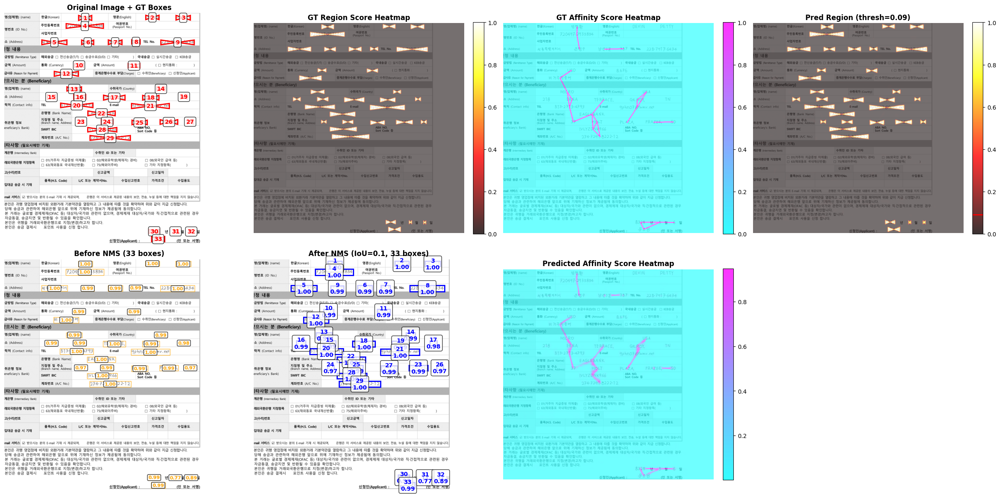

Visualization complete for sample 405
Summary: 33 GT boxes → 33 detected → 33 after NMS


In [28]:
test_sample = 405  # You can change this to any valid index

sample_idx = visualize_craft_predictions_with_thresholds(
    best_model, val_dataset, device, 
    sample_idx=test_sample,
    region_threshold=0.09,
    min_area=100,
    iou_threshold=0.1,
    spatial_ordering="top_left"
)

In [6]:
test_sample = 405  # You can change this to any valid index

sample_idx = visualize_craft_predictions_with_thresholds(
    best_model, val_dataset, device, 
    sample_idx=test_sample,
    region_threshold=0.09,
    min_area=100,
    iou_threshold=0.1,
    spatial_ordering="interval_based"
)

NameError: name 'visualize_craft_predictions_with_thresholds' is not defined

🔢 Starting interval-based sorting with 29 boxes
📏 Interval ratio: 0.3
Iteration 1: Found 2 boxes in y-interval [8.0, 23.0]
Remaining boxes: 27
Iteration 2: Found 3 boxes in y-interval [39.8, 54.2]
Remaining boxes: 24
Iteration 3: Found 4 boxes in y-interval [72.0, 87.0]
Remaining boxes: 20
Iteration 4: Found 2 boxes in y-interval [103.6, 117.4]
Remaining boxes: 18
Iteration 5: Found 3 boxes in y-interval [135.4, 148.6]
Remaining boxes: 15
Iteration 6: Found 5 boxes in y-interval [142.2, 175.8]
Remaining boxes: 10
Iteration 7: Found 1 boxes in y-interval [229.2, 244.8]
Remaining boxes: 9
Iteration 8: Found 1 boxes in y-interval [235.2, 265.8]
Remaining boxes: 8
Iteration 9: Found 1 boxes in y-interval [291.4, 319.6]
Remaining boxes: 7
Iteration 10: Found 1 boxes in y-interval [342.8, 360.2]
Remaining boxes: 6
Iteration 11: Found 1 boxes in y-interval [380.8, 395.2]
Remaining boxes: 5
Iteration 12: Found 5 boxes in y-interval [1000.0, 1015.0]
Remaining boxes: 0
Interval-based sorting com

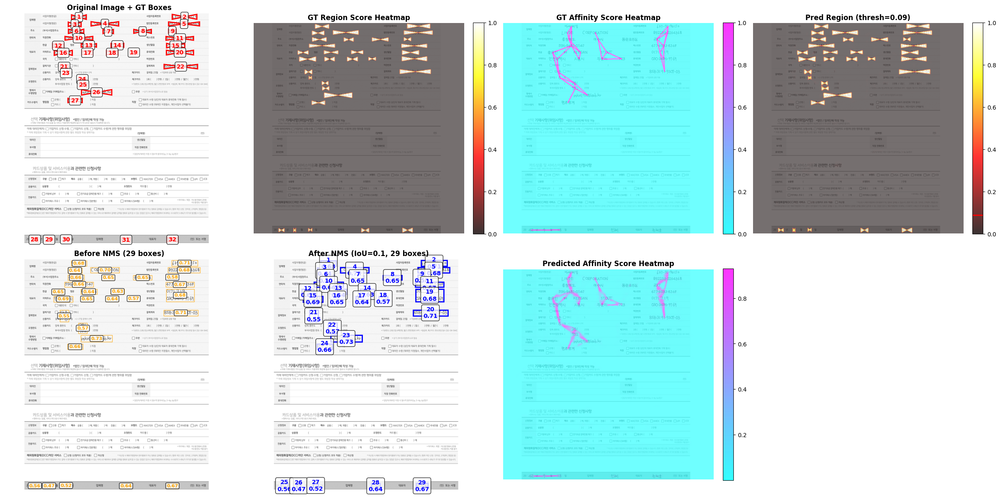

Visualization complete for sample 4011
Summary: 32 GT boxes → 29 detected → 29 after NMS


In [38]:
test_sample = 4011

sample_idx = visualize_craft_predictions_with_thresholds(
    best_model, train_dataset, device, 
    sample_idx=test_sample,
    region_threshold=0.09,
    min_area=100,
    iou_threshold=0.1,
    spatial_ordering="interval_based"
)

In [35]:
save_train = extract_and_save_predicted_boxes(
    model=best_model,
    dataset=train_dataset,
    device=device,
    output_folder="train_extracted_boxes",
    region_threshold=0.09,
    min_area=100,
    iou_threshold=0.1,
    spatial_ordering="interval_based",
    interval_ratio=0.5
)

Output folder: train_extracted_boxes
Total images to process: 5743
Region threshold: 0.09
Minimum area: 100
IoU threshold: 0.1
Spatial ordering: interval_based
Interval ratio: 0.5
🔢 Starting interval-based sorting with 20 boxes
📏 Interval ratio: 0.5
Iteration 1: Found 2 boxes in y-interval [161.0, 198.0]
Remaining boxes: 18
Iteration 2: Found 4 boxes in y-interval [410.0, 448.0]
Remaining boxes: 14
Iteration 3: Found 4 boxes in y-interval [472.0, 510.0]
Remaining boxes: 10
Iteration 4: Found 3 boxes in y-interval [691.0, 719.0]
Remaining boxes: 7
Iteration 5: Found 5 boxes in y-interval [745.0, 777.0]
Remaining boxes: 2
Iteration 6: Found 1 boxes in y-interval [803.0, 843.0]
Remaining boxes: 1
Iteration 7: Found 1 boxes in y-interval [837.0, 876.0]
Remaining boxes: 0
Interval-based sorting complete: 20 boxes ordered
Saved 20 boxes from image 0 (interval_based ordering)
🔢 Starting interval-based sorting with 20 boxes
📏 Interval ratio: 0.5
Iteration 1: Found 2 boxes in y-interval [160.0,

In [39]:
save_val = extract_and_save_predicted_boxes(
    model=best_model,
    dataset=val_dataset,
    device=device,
    output_folder="val_extracted_boxes",
    region_threshold=0.09,
    min_area=100,
    iou_threshold=0.1,
    spatial_ordering="interval_based",
    interval_ratio=0.5
)

Output folder: val_extracted_boxes
Total images to process: 727
Region threshold: 0.09
Minimum area: 100
IoU threshold: 0.1
Spatial ordering: interval_based
Interval ratio: 0.5
🔢 Starting interval-based sorting with 20 boxes
📏 Interval ratio: 0.5
Iteration 1: Found 2 boxes in y-interval [156.0, 201.0]
Remaining boxes: 18
Iteration 2: Found 4 boxes in y-interval [406.0, 447.0]
Remaining boxes: 14
Iteration 3: Found 4 boxes in y-interval [465.0, 510.0]
Remaining boxes: 10
Iteration 4: Found 3 boxes in y-interval [688.0, 719.0]
Remaining boxes: 7
Iteration 5: Found 5 boxes in y-interval [742.0, 781.0]
Remaining boxes: 2
Iteration 6: Found 1 boxes in y-interval [802.0, 837.0]
Remaining boxes: 1
Iteration 7: Found 1 boxes in y-interval [836.0, 873.0]
Remaining boxes: 0
Interval-based sorting complete: 20 boxes ordered
Saved 20 boxes from image 0 (interval_based ordering)
🔢 Starting interval-based sorting with 20 boxes
📏 Interval ratio: 0.5
Iteration 1: Found 2 boxes in y-interval [158.0, 20

In [7]:
# ------------광역 전처리------------------
# 데이터 로드 양식 5개, 각각에 해당되는 json 파일 1개씩
# 각 이미지에서 feature 추출: 썸네일(16*16), HOG, 기하
# 각 feature끼리 K-means로 군집화

# ------------CRAFT를 위한 전처리------------------
# 각 cluster마다 feature similarity를 이용하여 training dataset의 cluster와 validation dataset의 cluster를 매칭
# 매칭된 cluster마다 content box를 그리고, 그것보다 큰 정사각형 박스를 그리되, 최대 10픽셀 padding - cropping
# content box를 1024*1024 크기로 맞추고 cropping과 scaling을 json 파일의 x, y 좌표에도 적용

# -------------CRAFT 모델 학습-------------------
# 손실함수 = weight sum of MSE of RS, AS - 이때 우리는 문자탐지가 아니기 때문에 Affinity weight을 0.1로 낮게 둠(Region weight은 1.0)
# crop된 이미지를 CRAFT에 적용하여 학습

# -------------후처리------------------
# 학습된 CRAFT 모델을 이용하여 box 추출
# 추출된 box가 너무 세분화되어 나뉘는 경우를 방지하기 위해 IOU, Region threshold grid search
# 최적의 threshold로 box 추출
# 추출한 box 라벨링의 좌상단 정렬을 위해 각 box 중심의 y좌표를 기준으로 interval 생성, interval 내에 중심을 가지는 box들은 x좌표 기준으로 정렬 - interval-based spatial ordering
# 라벨링된 box를 추출